# Flint — LSTM Forecaster (Colab/GPU Notebook)

This notebook is a Colab-friendly version of `forecasting_engine.py` with:
- GPU training when available (`cuda`)
- More verbose hyperparameter tuning
- Plots for **train/val curves**, tuning results, and **test diagnostics**

## How to run on Colab
1. Runtime → Change runtime type → **GPU**
2. Ensure the CSVs exist in a data directory containing:
   - `df_h.csv`, `df_m.csv`, `df_u.csv`, `df_z.csv`
3. Set `DATA_DIR` in the config cell below (you can upload files, mount Drive, or `git clone` your repo).

In [ ]:
# Install dependencies (Colab usually already has torch, but this ensures sklearn/tqdm, etc.)
import sys, subprocess
def pip_install(*pkgs):
    cmd = [sys.executable, '-m', 'pip', 'install', '-q', *pkgs]
    print(' '.join(cmd))
    subprocess.check_call(cmd)

pip_install('numpy', 'pandas', 'matplotlib', 'scikit-learn', 'tqdm')

# Optional: uncomment to install torch explicitly (Colab already includes CUDA builds)
# pip_install('torch')

/usr/bin/python3 -m pip install -q numpy pandas matplotlib scikit-learn tqdm


In [ ]:
import json, math, random
from dataclasses import dataclass
from pathlib import Path
from typing import Dict, List, Optional, Sequence, Tuple

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

import torch
from torch import nn
from torch.utils.data import DataLoader, ConcatDataset
from sklearn.metrics import confusion_matrix

FEATURE_COLS = ['open', 'high', 'low', 'close', 'volume']
CLOSE_IDX = FEATURE_COLS.index('close')

def seed_all(seed: int = 42) -> None:
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('device:', device)
if device.type == 'cuda':
    print('gpu:', torch.cuda.get_device_name(0))

device: cuda
gpu: Tesla T4


## Data location

Set `DATA_DIR` to a folder containing `df_h.csv`, `df_m.csv`, `df_u.csv`, `df_z.csv`.

Common Colab options:
- Upload files into `/content/data`
- Mount Drive and point to `/content/drive/MyDrive/.../data`
- `git clone` your repo and point to `.../services/backend/model/data`

In [ ]:
# === CONFIG ===
seed_all(42)

# Point this to your data directory on Colab
DATA_DIR = Path('/content')  # <-- change this

# Feature transforms
LOG_VOLUME = True  # helps stabilize heavy-tailed volume

# Model + target setup
MODEL_NAME = 'seq2seq_lstm'  # try: 'direct_lstm', 'attn_lstm', 'cnn_lstm'
TARGET_MODE = 'delta_last'  # predict deltas from last input step (usually easier)

# Training / tuning knobs
BATCH_SIZE = 32
HORIZON = 60
DAYS_PER_SAMPLE = 7
STRIDE_DAYS = 1
MIN_DAY_LEN_RATIO = 0.9

TRAIN_FRAC, VAL_FRAC, TEST_FRAC = 0.8, 0.1, 0.1

# Train longer + validate longer
FINAL_EPOCHS = 50
EARLY_STOPPING_PATIENCE = 8

# Hyperparameter tuning (still lightweight)
TUNE_TRIALS = 15
TUNE_EPOCHS = 5
MAX_TRAIN_BATCHES_PER_EPOCH = 250
MAX_VAL_BATCHES = 80

ARTIFACTS_DIR = Path('/content/artifacts')
ARTIFACTS_DIR.mkdir(parents=True, exist_ok=True)
print('ARTIFACTS_DIR:', ARTIFACTS_DIR)

required = ['df_h.csv','df_m.csv','df_u.csv','df_z.csv']
missing = [f for f in required if not (DATA_DIR / f).exists()]
if missing:
    raise FileNotFoundError(
        f"DATA_DIR={DATA_DIR} is missing: {missing}\n"
        "Upload the files or change DATA_DIR."
    )

ARTIFACTS_DIR: /content/artifacts


In [ ]:
def load_contract_csv(path: Path) -> pd.DataFrame:
    df = pd.read_csv(path)
    expected = {'ts_event','open','high','low','close','volume','contract_month'}
    missing = expected - set(df.columns)
    if missing:
        raise ValueError(f"{path.name} missing columns: {sorted(missing)}")

    df = df.copy()
    df['ts_event'] = pd.to_datetime(df['ts_event'], errors='coerce')
    df = df.dropna(subset=['ts_event'])
    df = df.sort_values('ts_event').reset_index(drop=True)

    for col in FEATURE_COLS:
        df[col] = pd.to_numeric(df[col], errors='coerce')
    df = df.dropna(subset=FEATURE_COLS)

    if LOG_VOLUME:
        # volume can be heavy-tailed; log1p makes it easier to learn
        df['volume'] = np.log1p(np.maximum(df['volume'].to_numpy(dtype=np.float64), 0.0)).astype(np.float32)

    for col in FEATURE_COLS:
        df[col] = df[col].astype(np.float32)
    df['contract_month'] = df['contract_month'].astype(str)
    return df

def compute_median_trading_minutes_per_day(df: pd.DataFrame) -> int:
    day_counts = df.groupby(df['ts_event'].dt.date).size().astype(int)
    if day_counts.empty:
        raise ValueError('No daily rows found')
    median_count = int(day_counts.median())
    if median_count <= 0:
        raise ValueError('Median daily count is <= 0')
    return median_count

def build_day_segments(
    df: pd.DataFrame,
    *,
    day_len: int,
    min_day_len_ratio: float = 0.9,
) -> Tuple[np.ndarray, List[Tuple[int,int]], List[pd.Timestamp]]:
    if day_len <= 60:
        raise ValueError('day_len must be > 60 to hold a 1-hour target')

    df = df.sort_values('ts_event').reset_index(drop=True)
    data = df[FEATURE_COLS].to_numpy(dtype=np.float32, copy=True)

    groups = df.groupby(df['ts_event'].dt.date, sort=True)
    day_segments: List[Tuple[int,int]] = []
    day_starts: List[pd.Timestamp] = []
    min_len = int(day_len * min_day_len_ratio)

    for _, g in groups:
        if len(g) < min_len:
            continue
        day_start_idx = int(g.index.min())
        day_end_idx = int(g.index.max()) + 1
        if (day_end_idx - day_start_idx) < day_len:
            continue
        seg_end = day_end_idx
        seg_start = seg_end - day_len
        day_segments.append((seg_start, seg_end))
        day_starts.append(pd.Timestamp(g['ts_event'].iloc[0]))

    if not day_segments:
        raise ValueError('No valid day segments were created; check day_len/min_day_len_ratio')

    return data, day_segments, day_starts

class WeekToHourDataset(torch.utils.data.Dataset):
    """7 trading days -> predict last hour (60 minutes)."""
    def __init__(
        self,
        *,
        contract_name: str,
        data: np.ndarray,
        day_segments: List[Tuple[int,int]],
        week_starts: List[int],
        day_len: int,
        days_per_sample: int = 7,
        horizon: int = 60,
        mean: Optional[np.ndarray] = None,
        std: Optional[np.ndarray] = None,
    ):
        self.contract_name = contract_name
        self.data = data
        self.day_segments = day_segments
        self.week_starts = week_starts
        self.day_len = day_len
        self.days_per_sample = days_per_sample
        self.horizon = horizon
        self.mean = mean
        self.std = std

        self.total_len = self.days_per_sample * day_len
        if self.total_len <= horizon:
            raise ValueError('Total sample length must be > horizon')
        self.input_len = self.total_len - horizon

    def __len__(self) -> int:
        return len(self.week_starts)

    def set_scaler(self, mean: np.ndarray, std: np.ndarray) -> None:
        self.mean = mean.astype(np.float32)
        self.std = std.astype(np.float32)

    def _get_week_array(self, start_day_idx: int) -> np.ndarray:
        segs = self.day_segments[start_day_idx : start_day_idx + self.days_per_sample]
        parts = [self.data[s:e] for (s, e) in segs]
        return np.concatenate(parts, axis=0)

    def __getitem__(self, idx: int):
        start_day = self.week_starts[idx]
        seq = self._get_week_array(start_day)
        x = seq[: self.input_len]
        y = seq[self.input_len :]
        if self.mean is not None and self.std is not None:
            x = (x - self.mean) / self.std
            y = (y - self.mean) / self.std
        return (
            torch.from_numpy(x).to(torch.float32),
            torch.from_numpy(y).to(torch.float32),
        )

def compute_global_scaler_from_train(
    train_datasets: Sequence[WeekToHourDataset],
    *,
    eps: float = 1e-6,
) -> Tuple[np.ndarray, np.ndarray]:
    sum_vec = np.zeros((len(FEATURE_COLS),), dtype=np.float64)
    sumsq_vec = np.zeros((len(FEATURE_COLS),), dtype=np.float64)
    count = 0
    for ds in train_datasets:
        for start_day in ds.week_starts:
            seq = ds._get_week_array(start_day)
            x = seq[: ds.input_len]
            sum_vec += x.sum(axis=0)
            sumsq_vec += (x * x).sum(axis=0)
            count += x.shape[0]
    if count == 0:
        raise ValueError('No training rows to compute scaler')
    mean = (sum_vec / count).astype(np.float32)
    var = (sumsq_vec / count) - (mean.astype(np.float64) ** 2)
    std = np.sqrt(np.maximum(var, 0.0)).astype(np.float32)
    std = np.where(std < eps, np.float32(1.0), std)
    return mean, std

def build_datasets_for_contract(
    contract_name: str,
    df: pd.DataFrame,
    *,
    train_frac: float,
    val_frac: float,
    test_frac: float,
    day_len_override: Optional[int] = None,
    days_per_sample: int = 7,
    stride_days: int = 1,
    horizon: int = 60,
    min_day_len_ratio: float = 0.9,
) -> Dict[str, WeekToHourDataset]:
    day_len = day_len_override or compute_median_trading_minutes_per_day(df)
    data, day_segments, _day_starts = build_day_segments(
        df, day_len=day_len, min_day_len_ratio=min_day_len_ratio
    )
    if days_per_sample < 2:
        raise ValueError('days_per_sample must be >= 2')
    if stride_days < 1:
        raise ValueError('stride_days must be >= 1')
    if len(day_segments) < days_per_sample:
        raise ValueError(f'Not enough days to form a sample for {contract_name}')

    n_days = len(day_segments)
    train_day_end = int(n_days * train_frac)
    val_day_end = int(n_days * (train_frac + val_frac))
    train_day_end = max(days_per_sample, train_day_end)
    val_day_end = max(train_day_end + days_per_sample, val_day_end)
    val_day_end = min(n_days, val_day_end)

    def starts_in_range(day_start: int, day_end: int) -> List[int]:
        last_start = day_end - days_per_sample
        if last_start < day_start:
            return []
        return list(range(day_start, last_start + 1, stride_days))

    train_starts = starts_in_range(0, train_day_end)
    val_starts = starts_in_range(train_day_end, val_day_end)
    test_starts = starts_in_range(val_day_end, n_days)

    if len(train_starts) < 5 or len(val_starts) < 1 or len(test_starts) < 1:
        raise ValueError(
            f'Not enough samples after split for {contract_name}: '
            f'train={len(train_starts)} val={len(val_starts)} test={len(test_starts)} '
            f'(days={n_days}, days_per_sample={days_per_sample}, stride={stride_days})'
        )

    return {
        'train': WeekToHourDataset(
            contract_name=contract_name, data=data, day_segments=day_segments,
            week_starts=train_starts, day_len=day_len, days_per_sample=days_per_sample, horizon=horizon,
        ),
        'val': WeekToHourDataset(
            contract_name=contract_name, data=data, day_segments=day_segments,
            week_starts=val_starts, day_len=day_len, days_per_sample=days_per_sample, horizon=horizon,
        ),
        'test': WeekToHourDataset(
            contract_name=contract_name, data=data, day_segments=day_segments,
            week_starts=test_starts, day_len=day_len, days_per_sample=days_per_sample, horizon=horizon,
        ),
    }

In [ ]:
# --- Model zoo (modular) ---

def build_seq2seq_lstm_forecaster(
    *,
    input_size: int = 5,
    hidden_size: int = 192,
    num_layers: int = 2,
    dropout: float = 0.1,
) -> nn.Module:
    """Seq2Seq LSTM: encoder over input, decoder over horizon (teacher forcing supported)."""
    class Seq2SeqLSTMForecaster(nn.Module):
        def __init__(self):
            super().__init__()
            self.encoder = nn.LSTM(
                input_size=input_size, hidden_size=hidden_size, num_layers=num_layers,
                batch_first=True, dropout=dropout if num_layers > 1 else 0.0,
            )
            self.decoder = nn.LSTM(
                input_size=input_size, hidden_size=hidden_size, num_layers=num_layers,
                batch_first=True, dropout=dropout if num_layers > 1 else 0.0,
            )
            self.proj = nn.Linear(hidden_size, input_size)

        def forward(self, x, y=None, *, horizon: int = 60, teacher_forcing: bool = True):
            # x: (B, Tin, F) | y: (B, H, F) optional
            _enc_out, (h, c) = self.encoder(x)
            if teacher_forcing and y is not None:
                last_x = x[:, -1:, :]
                dec_in = torch.cat([last_x, y[:, :-1, :]], dim=1)
                dec_out, _ = self.decoder(dec_in, (h, c))
                return self.proj(dec_out)

            # Autoregressive decode (used rarely here; teacher forcing is fine for training/eval)
            preds = []
            inp = x[:, -1:, :]
            state = (h, c)
            for _ in range(horizon):
                dec_out, state = self.decoder(inp, state)
                step = self.proj(dec_out)
                preds.append(step)
                inp = step
            return torch.cat(preds, dim=1)

    return Seq2SeqLSTMForecaster()

def build_direct_lstm_forecaster(
    *,
    input_size: int = 5,
    hidden_size: int = 128,
    num_layers: int = 2,
    dropout: float = 0.1,
    horizon: int = 60,
    output_size: int = 5,
) -> nn.Module:
    class DirectLSTMForecaster(nn.Module):
        def __init__(self):
            super().__init__()
            self.lstm = nn.LSTM(
                input_size=input_size, hidden_size=hidden_size, num_layers=num_layers,
                batch_first=True, dropout=dropout if num_layers > 1 else 0.0,
            )
            self.head = nn.Sequential(
                nn.Linear(hidden_size, hidden_size),
                nn.ReLU(),
                nn.Linear(hidden_size, horizon * output_size),
            )
            self.horizon = horizon
            self.output_size = output_size

        def forward(self, x, y=None, *, horizon: Optional[int] = None, teacher_forcing: bool = True):
            _out, (h, _c) = self.lstm(x)
            last = h[-1]
            hzn = int(horizon) if horizon is not None else self.horizon
            return self.head(last).view(x.shape[0], hzn, self.output_size)

    return DirectLSTMForecaster()

def build_attn_lstm_forecaster(
    *,
    input_size: int = 5,
    hidden_size: int = 192,
    num_layers: int = 2,
    dropout: float = 0.1,
    horizon: int = 60,
    output_size: int = 5,
) -> nn.Module:
    """LSTM over the full sequence + attention pooling over time."""
    class AttnLSTMForecaster(nn.Module):
        def __init__(self):
            super().__init__()
            self.lstm = nn.LSTM(
                input_size=input_size, hidden_size=hidden_size, num_layers=num_layers,
                batch_first=True, dropout=dropout if num_layers > 1 else 0.0,
            )
            self.attn = nn.Sequential(
                nn.Linear(hidden_size, hidden_size),
                nn.Tanh(),
                nn.Linear(hidden_size, 1),
            )
            self.head = nn.Sequential(
                nn.Linear(hidden_size, hidden_size),
                nn.ReLU(),
                nn.Dropout(dropout),
                nn.Linear(hidden_size, horizon * output_size),
            )
            self.horizon = horizon
            self.output_size = output_size

        def forward(self, x, y=None, *, horizon: Optional[int] = None, teacher_forcing: bool = True):
            out, _state = self.lstm(x)  # (B, T, H)
            scores = self.attn(out).squeeze(-1)  # (B, T)
            weights = torch.softmax(scores, dim=1).unsqueeze(-1)  # (B, T, 1)
            ctx = (weights * out).sum(dim=1)  # (B, H)
            hzn = int(horizon) if horizon is not None else self.horizon
            return self.head(ctx).view(x.shape[0], hzn, self.output_size)

    return AttnLSTMForecaster()

def build_cnn_lstm_forecaster(
    *,
    input_size: int = 5,
    conv_channels: int = 64,
    hidden_size: int = 160,
    num_layers: int = 2,
    dropout: float = 0.1,
    horizon: int = 60,
    output_size: int = 5,
) -> nn.Module:
    """Strided CNN to compress long sequences, then an LSTM encoder."""
    class CNNLSTMForecaster(nn.Module):
        def __init__(self):
            super().__init__()
            self.conv = nn.Sequential(
                nn.Conv1d(input_size, conv_channels, kernel_size=7, stride=2, padding=3),
                nn.ReLU(),
                nn.Conv1d(conv_channels, conv_channels, kernel_size=5, stride=2, padding=2),
                nn.ReLU(),
                nn.Conv1d(conv_channels, conv_channels, kernel_size=5, stride=2, padding=2),
                nn.ReLU(),
            )
            self.lstm = nn.LSTM(
                input_size=conv_channels, hidden_size=hidden_size, num_layers=num_layers,
                batch_first=True, dropout=dropout if num_layers > 1 else 0.0,
            )
            self.head = nn.Sequential(
                nn.Linear(hidden_size, hidden_size),
                nn.ReLU(),
                nn.Dropout(dropout),
                nn.Linear(hidden_size, horizon * output_size),
            )
            self.horizon = horizon
            self.output_size = output_size

        def forward(self, x, y=None, *, horizon: Optional[int] = None, teacher_forcing: bool = True):
            z = self.conv(x.transpose(1, 2)).transpose(1, 2)  # (B, T', C)
            _out, (h, _c) = self.lstm(z)
            last = h[-1]
            hzn = int(horizon) if horizon is not None else self.horizon
            return self.head(last).view(x.shape[0], hzn, self.output_size)

    return CNNLSTMForecaster()

def build_model(*, name: str, horizon: int, output_size: int) -> nn.Module:
    name = name.strip().lower()
    if name == 'direct_lstm':
        return build_direct_lstm_forecaster(input_size=len(FEATURE_COLS), horizon=horizon, output_size=output_size)
    if name == 'attn_lstm':
        return build_attn_lstm_forecaster(input_size=len(FEATURE_COLS), horizon=horizon, output_size=output_size)
    if name == 'cnn_lstm':
        return build_cnn_lstm_forecaster(input_size=len(FEATURE_COLS), horizon=horizon, output_size=output_size)
    if name == 'seq2seq_lstm':
        # horizon not baked into this model; passed at forward-time
        return build_seq2seq_lstm_forecaster(input_size=len(FEATURE_COLS))
    raise ValueError(f"Unknown MODEL_NAME={name!r}. Try: 'direct_lstm', 'attn_lstm', 'cnn_lstm', 'seq2seq_lstm'")

In [ ]:
def _make_delta_targets(xb: torch.Tensor, yb_abs: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
    """Return (yb_delta, last_x) in normalized space."""
    last_x = xb[:, -1:, :]  # (B, 1, F)
    yb_delta = yb_abs - last_x  # (B, H, F)
    return yb_delta, last_x

def _delta_to_abs(last_x: torch.Tensor, y_delta: torch.Tensor) -> torch.Tensor:
    return y_delta + last_x

def evaluate_model(model: nn.Module, loader: DataLoader, device: torch.device) -> float:
    """Returns ABSOLUTE-space MSE in normalized units (lower is better)."""
    model.eval()
    loss_fn = nn.MSELoss()
    losses: List[float] = []
    with torch.no_grad():
        for xb, yb_abs in loader:
            xb = xb.to(device)
            yb_abs = yb_abs.to(device)

            if TARGET_MODE == 'delta_last':
                yb_delta, last_x = _make_delta_targets(xb, yb_abs)
                pred_delta = model(xb, yb_delta, horizon=yb_delta.shape[1], teacher_forcing=True)
                pred_abs = _delta_to_abs(last_x, pred_delta)
            else:
                pred_abs = model(xb, yb_abs, horizon=yb_abs.shape[1], teacher_forcing=True)

            losses.append(loss_fn(pred_abs, yb_abs).item())
    return float(np.mean(losses)) if losses else float('nan')

def evaluate_model_limited(
    model: nn.Module,
    loader: DataLoader,
    device: torch.device,
    *,
    max_batches: Optional[int] = None,
) -> float:
    model.eval()
    loss_fn = nn.MSELoss()
    losses: List[float] = []
    with torch.no_grad():
        for i, (xb, yb_abs) in enumerate(loader):
            if max_batches is not None and i >= max_batches:
                break
            xb = xb.to(device)
            yb_abs = yb_abs.to(device)

            if TARGET_MODE == 'delta_last':
                yb_delta, last_x = _make_delta_targets(xb, yb_abs)
                pred_delta = model(xb, yb_delta, horizon=yb_delta.shape[1], teacher_forcing=True)
                pred_abs = _delta_to_abs(last_x, pred_delta)
            else:
                pred_abs = model(xb, yb_abs, horizon=yb_abs.shape[1], teacher_forcing=True)

            losses.append(loss_fn(pred_abs, yb_abs).item())
    return float(np.mean(losses)) if losses else float('nan')

def predict_one_unscaled(
    model: nn.Module, dataset: WeekToHourDataset, idx: int, device: torch.device
) -> Tuple[np.ndarray, np.ndarray]:
    """Returns (pred_abs, actual_abs) in ORIGINAL units, arrays shaped (horizon, F)."""
    model.eval()
    xb, yb_abs = dataset[idx]
    with torch.no_grad():
        xb_b = xb.unsqueeze(0).to(device)
        yb_b = yb_abs.unsqueeze(0).to(device)
        if TARGET_MODE == 'delta_last':
            yb_delta, last_x = _make_delta_targets(xb_b, yb_b)
            pred_delta = model(xb_b, yb_delta, horizon=yb_delta.shape[1], teacher_forcing=True)
            pred_abs = _delta_to_abs(last_x, pred_delta)
        else:
            pred_abs = model(xb_b, yb_b, horizon=yb_b.shape[1], teacher_forcing=True)
        pred_abs = pred_abs.squeeze(0).cpu().numpy().astype(np.float32)
    actual = yb_abs.cpu().numpy().astype(np.float32)

    if dataset.mean is not None and dataset.std is not None:
        pred_abs = pred_abs * dataset.std + dataset.mean
        actual = actual * dataset.std + dataset.mean
    return pred_abs, actual

def plot_forecast_vs_actual(
    *,
    model: nn.Module,
    dataset: WeekToHourDataset,
    idx: int,
    device: torch.device,
    save_path: Optional[Path] = None,
    show: bool = True,
) -> None:
    pred, actual = predict_one_unscaled(model, dataset, idx, device)
    t = np.arange(pred.shape[0])
    fig, axes = plt.subplots(nrows=len(FEATURE_COLS), ncols=1, figsize=(10, 10), sharex=True)
    if len(FEATURE_COLS) == 1:
        axes = [axes]
    for i, col in enumerate(FEATURE_COLS):
        ax = axes[i]
        ax.plot(t, actual[:, i], label='actual', linewidth=2)
        ax.plot(t, pred[:, i], label='forecast', linewidth=2)
        ax.set_ylabel(col)
        ax.grid(True, alpha=0.3)
        if i == 0:
            ax.legend(loc='best')
    axes[-1].set_xlabel('minute (last hour)')
    fig.suptitle(f"{dataset.contract_name} sample={idx} (last-hour forecast)")
    fig.tight_layout()
    if save_path is not None:
        save_path.parent.mkdir(parents=True, exist_ok=True)
        fig.savefig(save_path, dpi=160)
        print('plot_saved:', str(save_path))
    if show:
        plt.show()
    plt.close(fig)

In [ ]:
def train_verbose(
    model: nn.Module,
    *,
    train_loader: DataLoader,
    val_loaders: Dict[str, DataLoader],
    epochs: int,
    lr: float,
    device: torch.device,
    max_train_batches_per_epoch: Optional[int] = None,
    patience: int = 8,
    min_delta: float = 1e-5,
) -> Dict[str, object]:
    """Train on delta targets (if enabled) but report/early-stop on ABS val MSE."""
    opt = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=1e-4)
    loss_fn = nn.MSELoss()
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(opt, mode='min', factor=0.5, patience=3)

    history = {
        'train_delta_mse': [],
        'val_abs_mse': {k: [] for k in val_loaders.keys()},
        'val_abs_mean': [],
        'lr': [],
        'best_epoch': None,
        'best_val': float('inf'),
        'best_state_dict': None,
    }

    bad_epochs = 0
    for epoch in range(1, epochs + 1):
        model.train()
        train_losses: List[float] = []
        pbar = tqdm(enumerate(train_loader), total=len(train_loader), leave=False)
        for i, (xb, yb_abs) in pbar:
            if max_train_batches_per_epoch is not None and i >= max_train_batches_per_epoch:
                break
            xb = xb.to(device)
            yb_abs = yb_abs.to(device)

            if TARGET_MODE == 'delta_last':
                yb_delta, _last_x = _make_delta_targets(xb, yb_abs)
                y_train = yb_delta
            else:
                y_train = yb_abs

            opt.zero_grad(set_to_none=True)
            pred = model(xb, y_train, horizon=y_train.shape[1], teacher_forcing=True)
            loss = loss_fn(pred, y_train)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            opt.step()
            train_losses.append(loss.item())
            if i % 25 == 0:
                pbar.set_description(f"epoch {epoch}/{epochs} train_delta_mse={np.mean(train_losses):.6f}")

        train_delta_mse = float(np.mean(train_losses)) if train_losses else float('nan')
        history['train_delta_mse'].append(train_delta_mse)
        history['lr'].append(float(opt.param_groups[0]['lr']))

        # Val ABS MSE (what you actually care about)
        val_report = {name: evaluate_model(model, loader, device) for name, loader in val_loaders.items()}
        for name, v in val_report.items():
            history['val_abs_mse'][name].append(float(v))
        val_mean = float(np.mean(list(val_report.values()))) if val_report else float('inf')
        history['val_abs_mean'].append(val_mean)

        scheduler.step(val_mean)
        val_str = ' '.join([f"{k}={v:.6f}" for k, v in val_report.items()])
        print(f"epoch={epoch:03d}/{epochs} lr={opt.param_groups[0]['lr']:.2e} train_delta_mse={train_delta_mse:.6f} val_abs_mean={val_mean:.6f} {val_str}")

        if val_mean + min_delta < history['best_val']:
            history['best_val'] = val_mean
            history['best_epoch'] = epoch
            history['best_state_dict'] = {k: v.detach().cpu().clone() for k, v in model.state_dict().items()}
            bad_epochs = 0
        else:
            bad_epochs += 1
            if bad_epochs >= patience:
                print(f"early_stop: epoch={epoch} best_epoch={history['best_epoch']} best_val_abs_mean={history['best_val']:.6f}")
                break

    # Restore best weights (helps test)
    if history['best_state_dict'] is not None:
        model.load_state_dict(history['best_state_dict'])
    return history

def plot_training_curves(history: Dict[str, object], title: str = 'Training Curves') -> None:
    train = history['train_delta_mse']
    val = history['val_abs_mse']
    epochs = np.arange(1, len(train) + 1)
    plt.figure(figsize=(10, 5))
    plt.plot(epochs, train, label='train_delta_mse', linewidth=2)
    for name, series in val.items():
        plt.plot(epochs, series, label=name.replace('val_', 'val_abs_'), linewidth=2)
    plt.xlabel('epoch')
    plt.ylabel('MSE (normalized)')
    plt.title(title)
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.show()

def mean_metric(report: Dict[str, float]) -> float:
    vals = [v for v in report.values() if not (math.isnan(v) or math.isinf(v))]
    return float(np.mean(vals)) if vals else float('inf')

def tune_hyperparameters_verbose(
    *,
    model_name: str,
    contract_splits: Dict[str, Dict[str, WeekToHourDataset]],
    device: torch.device,
    tune_trials: int,
    tune_epochs: int,
    batch_size: int,
    horizon: int,
    max_train_batches_per_epoch: int,
    max_val_batches: int,
    rng_seed: int = 42,
) -> Dict[str, object]:
    rng = random.Random(rng_seed)

    # Candidate spaces (kept sane for speed)
    hidden_sizes = [128, 192, 256]
    num_layers_list = [1, 2, 3]
    dropouts = [0.0, 0.1, 0.2]
    lrs = [1e-3, 3e-4, 1e-4]

    train_concat = ConcatDataset([contract_splits[c]['train'] for c in contract_splits])
    train_loader = DataLoader(train_concat, batch_size=batch_size, shuffle=True, num_workers=0, drop_last=True)
    val_loaders = {
        f"val_{c}": DataLoader(contract_splits[c]['val'], batch_size=batch_size, shuffle=False, num_workers=0)
        for c in contract_splits
    }

    trials = []
    best = {'score': float('inf'), 'params': None, 'report': None, 'trial': None}

    for trial in range(1, tune_trials + 1):
        hidden = rng.choice(hidden_sizes)
        layers = rng.choice(num_layers_list)
        drop = rng.choice(dropouts)
        lr = rng.choice(lrs)

        name = model_name.strip().lower()
        if name == 'direct_lstm':
            model = build_direct_lstm_forecaster(
                input_size=len(FEATURE_COLS), hidden_size=hidden, num_layers=layers, dropout=drop,
                horizon=horizon, output_size=len(FEATURE_COLS)
            ).to(device)
        elif name == 'attn_lstm':
            model = build_attn_lstm_forecaster(
                input_size=len(FEATURE_COLS), hidden_size=hidden, num_layers=layers, dropout=drop,
                horizon=horizon, output_size=len(FEATURE_COLS)
            ).to(device)
        elif name == 'cnn_lstm':
            model = build_cnn_lstm_forecaster(
                input_size=len(FEATURE_COLS), hidden_size=hidden, num_layers=layers, dropout=drop,
                horizon=horizon, output_size=len(FEATURE_COLS)
            ).to(device)
        elif name == 'seq2seq_lstm':
            model = build_seq2seq_lstm_forecaster(
                input_size=len(FEATURE_COLS), hidden_size=hidden, num_layers=layers, dropout=drop
            ).to(device)
        else:
            model = build_model(name=model_name, horizon=horizon, output_size=len(FEATURE_COLS)).to(device)

        hist = train_verbose(
            model,
            train_loader=train_loader,
            val_loaders=val_loaders,
            epochs=tune_epochs,
            lr=lr,
            device=device,
            max_train_batches_per_epoch=max_train_batches_per_epoch,
            patience=max(2, min(5, tune_epochs)),
        )

        final_report = {
            name: evaluate_model_limited(model, loader, device, max_batches=max_val_batches)
            for name, loader in val_loaders.items()
        }
        score = mean_metric(final_report)
        params = {'hidden_size': hidden, 'num_layers': layers, 'dropout': drop, 'lr': lr}
        print(f"tune trial={trial}/{tune_trials} score={score:.6f} params={params} report={final_report}")

        row = {'trial': trial, 'score': score, **params, **final_report}
        trials.append(row)
        if score < best['score']:
            best = {'score': score, 'params': params, 'report': final_report, 'trial': trial}

    df_trials = pd.DataFrame(trials).sort_values('score').reset_index(drop=True)
    print('best_tune:', best)
    return {'best': best, 'trials_df': df_trials}

def plot_tuning_results(trials_df: pd.DataFrame) -> None:
    plt.figure(figsize=(10, 4))
    plt.plot(trials_df.sort_values('trial')['trial'], trials_df.sort_values('trial')['score'], marker='o')
    plt.xlabel('trial')
    plt.ylabel('mean val ABS MSE (score)')
    plt.title('Hyperparameter Tuning Score vs Trial')
    plt.grid(True, alpha=0.3)
    plt.show()
    display(trials_df)

In [ ]:
# Load all contracts and build dataset splits
files = {
    'H': DATA_DIR / 'df_h.csv',
    'M': DATA_DIR / 'df_m.csv',
    'U': DATA_DIR / 'df_u.csv',
    'Z': DATA_DIR / 'df_z.csv',
}

contract_dfs: Dict[str, pd.DataFrame] = {}
median_day_lens: Dict[str, int] = {}
for contract_name, path in files.items():
    df = load_contract_csv(path)
    contract_dfs[contract_name] = df
    median_day_lens[contract_name] = compute_median_trading_minutes_per_day(df)

global_day_len = int(min(median_day_lens.values()))
if global_day_len <= HORIZON:
    raise ValueError(f'global_day_len ({global_day_len}) must be > horizon ({HORIZON})')
print('median_day_lens:', median_day_lens, 'global_day_len:', global_day_len)

contract_splits: Dict[str, Dict[str, WeekToHourDataset]] = {}
for contract_name, df in contract_dfs.items():
    contract_splits[contract_name] = build_datasets_for_contract(
        contract_name, df,
        train_frac=TRAIN_FRAC, val_frac=VAL_FRAC, test_frac=TEST_FRAC,
        day_len_override=global_day_len,
        days_per_sample=DAYS_PER_SAMPLE, stride_days=STRIDE_DAYS, horizon=HORIZON,
        min_day_len_ratio=MIN_DAY_LEN_RATIO,
    )
    ds_train = contract_splits[contract_name]['train']
    print(
        f"{contract_name}: train={len(contract_splits[contract_name]['train'])} "
        f"val={len(contract_splits[contract_name]['val'])} "
        f"test={len(contract_splits[contract_name]['test'])} "
        f"day_len={ds_train.day_len} input_len={ds_train.input_len}"
    )

# Global scaler computed from all training inputs across all contract months
train_datasets = [contract_splits[c]['train'] for c in contract_splits]
mean, std = compute_global_scaler_from_train(train_datasets)
for c in contract_splits:
    for split_name in ('train','val','test'):
        contract_splits[c][split_name].set_scaler(mean, std)
print('global_scaler:', {k: float(v) for k, v in zip(FEATURE_COLS, mean)})

median_day_lens: {'H': 140, 'M': 180, 'U': 189, 'Z': 120} global_day_len: 120
H: train=1034 val=124 test=125 day_len=120 input_len=780
M: train=1121 val=135 test=135 day_len=120 input_len=780
U: train=1165 val=140 test=141 day_len=120 input_len=780
Z: train=1099 val=132 test=133 day_len=120 input_len=780
global_scaler: {'open': 3255.4794921875, 'high': 3255.8310546875, 'low': 3255.126220703125, 'close': 3255.477783203125, 'volume': 3.372556447982788}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=1.00e-04 train_delta_mse=0.061678 val_abs_mean=0.027511 val_H=0.024900 val_M=0.028790 val_U=0.027514 val_Z=0.028839


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=1.00e-04 train_delta_mse=0.032372 val_abs_mean=0.026859 val_H=0.024184 val_M=0.028266 val_U=0.027789 val_Z=0.027198


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=1.00e-04 train_delta_mse=0.031048 val_abs_mean=0.025896 val_H=0.023336 val_M=0.027426 val_U=0.026834 val_Z=0.025988


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=1.00e-04 train_delta_mse=0.030496 val_abs_mean=0.025929 val_H=0.023197 val_M=0.027518 val_U=0.027155 val_Z=0.025846


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=1.00e-04 train_delta_mse=0.030028 val_abs_mean=0.024192 val_H=0.021766 val_M=0.026146 val_U=0.025196 val_Z=0.023660
tune trial=1/15 score=0.024192 params={'hidden_size': 256, 'num_layers': 1, 'dropout': 0.0, 'lr': 0.0001} report={'val_H': 0.02176597435027361, 'val_M': 0.02614564187824726, 'val_U': 0.02519557997584343, 'val_Z': 0.023659753054380415}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=1.00e-03 train_delta_mse=0.034770 val_abs_mean=0.024552 val_H=0.022212 val_M=0.026320 val_U=0.025874 val_Z=0.023804


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=1.00e-03 train_delta_mse=0.028147 val_abs_mean=0.021746 val_H=0.019511 val_M=0.024195 val_U=0.022987 val_Z=0.020292


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=1.00e-03 train_delta_mse=0.027298 val_abs_mean=0.021537 val_H=0.019344 val_M=0.023924 val_U=0.022735 val_Z=0.020144


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=1.00e-03 train_delta_mse=0.026812 val_abs_mean=0.021299 val_H=0.019209 val_M=0.023491 val_U=0.022423 val_Z=0.020074


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=1.00e-03 train_delta_mse=0.026409 val_abs_mean=0.021281 val_H=0.019147 val_M=0.023381 val_U=0.022248 val_Z=0.020347
tune trial=2/15 score=0.021281 params={'hidden_size': 192, 'num_layers': 1, 'dropout': 0.0, 'lr': 0.001} report={'val_H': 0.01914740214124322, 'val_M': 0.023380710557103158, 'val_U': 0.02224776931107044, 'val_Z': 0.020346743613481523}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=1.00e-04 train_delta_mse=0.061014 val_abs_mean=0.028023 val_H=0.026029 val_M=0.028803 val_U=0.027684 val_Z=0.029577


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=1.00e-04 train_delta_mse=0.032467 val_abs_mean=0.025804 val_H=0.023470 val_M=0.027156 val_U=0.026055 val_Z=0.026535


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=1.00e-04 train_delta_mse=0.031044 val_abs_mean=0.025253 val_H=0.022841 val_M=0.026820 val_U=0.025845 val_Z=0.025505


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=1.00e-04 train_delta_mse=0.030475 val_abs_mean=0.025088 val_H=0.022551 val_M=0.026881 val_U=0.026137 val_Z=0.024783


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=1.00e-04 train_delta_mse=0.030026 val_abs_mean=0.024525 val_H=0.021924 val_M=0.026584 val_U=0.025805 val_Z=0.023785
tune trial=3/15 score=0.024525 params={'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2, 'lr': 0.0001} report={'val_H': 0.02192378230392933, 'val_M': 0.026584387198090552, 'val_U': 0.025805262476205827, 'val_Z': 0.023784914612770082}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=3.00e-04 train_delta_mse=0.044559 val_abs_mean=0.025578 val_H=0.023028 val_M=0.027191 val_U=0.026312 val_Z=0.025782


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=3.00e-04 train_delta_mse=0.030143 val_abs_mean=0.024902 val_H=0.022175 val_M=0.026833 val_U=0.026213 val_Z=0.024389


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=3.00e-04 train_delta_mse=0.029201 val_abs_mean=0.023649 val_H=0.021321 val_M=0.025427 val_U=0.024745 val_Z=0.023104


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=3.00e-04 train_delta_mse=0.028073 val_abs_mean=0.021998 val_H=0.019871 val_M=0.024161 val_U=0.023145 val_Z=0.020815


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=3.00e-04 train_delta_mse=0.027524 val_abs_mean=0.021738 val_H=0.019510 val_M=0.023989 val_U=0.022900 val_Z=0.020552
tune trial=4/15 score=0.021738 params={'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2, 'lr': 0.0003} report={'val_H': 0.01951048942282796, 'val_M': 0.02398909255862236, 'val_U': 0.02289983369410038, 'val_Z': 0.020551770552992822}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=1.00e-03 train_delta_mse=0.036952 val_abs_mean=0.024676 val_H=0.022321 val_M=0.026238 val_U=0.025659 val_Z=0.024487


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=1.00e-03 train_delta_mse=0.028501 val_abs_mean=0.022378 val_H=0.020362 val_M=0.024258 val_U=0.023055 val_Z=0.021837


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=1.00e-03 train_delta_mse=0.027451 val_abs_mean=0.021459 val_H=0.019231 val_M=0.023788 val_U=0.022730 val_Z=0.020088


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=1.00e-03 train_delta_mse=0.027212 val_abs_mean=0.021193 val_H=0.019059 val_M=0.023536 val_U=0.022409 val_Z=0.019769


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=1.00e-03 train_delta_mse=0.026967 val_abs_mean=0.021433 val_H=0.019327 val_M=0.023566 val_U=0.022412 val_Z=0.020427
tune trial=5/15 score=0.021193 params={'hidden_size': 128, 'num_layers': 1, 'dropout': 0.0, 'lr': 0.001} report={'val_H': 0.019058628473430872, 'val_M': 0.023536420613527297, 'val_U': 0.022408593073487283, 'val_Z': 0.019768841564655304}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=1.00e-03 train_delta_mse=0.039129 val_abs_mean=0.023923 val_H=0.021707 val_M=0.025944 val_U=0.024824 val_Z=0.023217


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=1.00e-03 train_delta_mse=0.028704 val_abs_mean=0.021757 val_H=0.019608 val_M=0.024140 val_U=0.022989 val_Z=0.020290


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=1.00e-03 train_delta_mse=0.027574 val_abs_mean=0.021341 val_H=0.019340 val_M=0.023691 val_U=0.022532 val_Z=0.019800


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=1.00e-03 train_delta_mse=0.027379 val_abs_mean=0.021539 val_H=0.019434 val_M=0.023838 val_U=0.022766 val_Z=0.020117


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=1.00e-03 train_delta_mse=0.027050 val_abs_mean=0.021486 val_H=0.019349 val_M=0.023609 val_U=0.022683 val_Z=0.020302
tune trial=6/15 score=0.021341 params={'hidden_size': 128, 'num_layers': 3, 'dropout': 0.2, 'lr': 0.001} report={'val_H': 0.01934033026918769, 'val_M': 0.023690829798579217, 'val_U': 0.022531985491514205, 'val_Z': 0.019800372049212457}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=1.00e-04 train_delta_mse=0.057629 val_abs_mean=0.027260 val_H=0.024996 val_M=0.028385 val_U=0.027039 val_Z=0.028620


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=1.00e-04 train_delta_mse=0.031996 val_abs_mean=0.027073 val_H=0.025197 val_M=0.027648 val_U=0.027213 val_Z=0.028235


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=1.00e-04 train_delta_mse=0.030740 val_abs_mean=0.025557 val_H=0.022969 val_M=0.027165 val_U=0.026449 val_Z=0.025644


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=1.00e-04 train_delta_mse=0.030264 val_abs_mean=0.025795 val_H=0.022968 val_M=0.027584 val_U=0.027158 val_Z=0.025471


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=1.00e-04 train_delta_mse=0.029802 val_abs_mean=0.024430 val_H=0.021868 val_M=0.026385 val_U=0.025624 val_Z=0.023841
tune trial=7/15 score=0.024430 params={'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2, 'lr': 0.0001} report={'val_H': 0.02186822472140193, 'val_M': 0.026385107636451723, 'val_U': 0.02562384307384491, 'val_Z': 0.02384096905589104}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=1.00e-03 train_delta_mse=0.033449 val_abs_mean=0.022166 val_H=0.020296 val_M=0.024390 val_U=0.023204 val_Z=0.020774


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=1.00e-03 train_delta_mse=0.027617 val_abs_mean=0.022264 val_H=0.020560 val_M=0.024382 val_U=0.023214 val_Z=0.020900


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=1.00e-03 train_delta_mse=0.027374 val_abs_mean=0.021526 val_H=0.019593 val_M=0.023969 val_U=0.022748 val_Z=0.019796


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=1.00e-03 train_delta_mse=0.027123 val_abs_mean=0.021639 val_H=0.019549 val_M=0.024011 val_U=0.022875 val_Z=0.020123


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=1.00e-03 train_delta_mse=0.026717 val_abs_mean=0.021500 val_H=0.019527 val_M=0.023704 val_U=0.022608 val_Z=0.020161
tune trial=8/15 score=0.021500 params={'hidden_size': 256, 'num_layers': 3, 'dropout': 0.1, 'lr': 0.001} report={'val_H': 0.0195272509008646, 'val_M': 0.023703940212726593, 'val_U': 0.022608144953846932, 'val_Z': 0.02016146369278431}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=1.00e-03 train_delta_mse=0.034818 val_abs_mean=0.023473 val_H=0.021255 val_M=0.025475 val_U=0.024553 val_Z=0.022609


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=1.00e-03 train_delta_mse=0.027760 val_abs_mean=0.021513 val_H=0.019507 val_M=0.023782 val_U=0.022616 val_Z=0.020147


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=1.00e-03 train_delta_mse=0.027329 val_abs_mean=0.021602 val_H=0.019447 val_M=0.023756 val_U=0.022812 val_Z=0.020392


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=1.00e-03 train_delta_mse=0.027000 val_abs_mean=0.021208 val_H=0.019124 val_M=0.023412 val_U=0.022247 val_Z=0.020048


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=1.00e-03 train_delta_mse=0.026464 val_abs_mean=0.020989 val_H=0.018857 val_M=0.023251 val_U=0.022189 val_Z=0.019657
tune trial=9/15 score=0.020989 params={'hidden_size': 192, 'num_layers': 3, 'dropout': 0.1, 'lr': 0.001} report={'val_H': 0.018857384100556374, 'val_M': 0.023251123353838922, 'val_U': 0.022189410403370857, 'val_Z': 0.01965739130973816}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=3.00e-04 train_delta_mse=0.047548 val_abs_mean=0.025961 val_H=0.023473 val_M=0.027775 val_U=0.026364 val_Z=0.026232


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=3.00e-04 train_delta_mse=0.031267 val_abs_mean=0.024579 val_H=0.022260 val_M=0.026514 val_U=0.025368 val_Z=0.024173


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=3.00e-04 train_delta_mse=0.030054 val_abs_mean=0.023507 val_H=0.021096 val_M=0.025680 val_U=0.024752 val_Z=0.022501


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=3.00e-04 train_delta_mse=0.028666 val_abs_mean=0.021814 val_H=0.019728 val_M=0.024309 val_U=0.023012 val_Z=0.020206


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=3.00e-04 train_delta_mse=0.027617 val_abs_mean=0.021335 val_H=0.019234 val_M=0.023690 val_U=0.022534 val_Z=0.019882
tune trial=10/15 score=0.021335 params={'hidden_size': 128, 'num_layers': 3, 'dropout': 0.1, 'lr': 0.0003} report={'val_H': 0.019234474282711744, 'val_M': 0.02369042970240116, 'val_U': 0.02253405302762985, 'val_Z': 0.019882099702954292}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=3.00e-04 train_delta_mse=0.045176 val_abs_mean=0.025932 val_H=0.023190 val_M=0.027743 val_U=0.027000 val_Z=0.025793


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=3.00e-04 train_delta_mse=0.030247 val_abs_mean=0.024743 val_H=0.022056 val_M=0.026828 val_U=0.026023 val_Z=0.024065


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=3.00e-04 train_delta_mse=0.029377 val_abs_mean=0.023065 val_H=0.020745 val_M=0.025182 val_U=0.024008 val_Z=0.022325


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=3.00e-04 train_delta_mse=0.028489 val_abs_mean=0.022368 val_H=0.020119 val_M=0.024610 val_U=0.023513 val_Z=0.021230


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=3.00e-04 train_delta_mse=0.027705 val_abs_mean=0.021629 val_H=0.019559 val_M=0.023905 val_U=0.022731 val_Z=0.020321
tune trial=11/15 score=0.021629 params={'hidden_size': 192, 'num_layers': 1, 'dropout': 0.0, 'lr': 0.0003} report={'val_H': 0.019558957312256098, 'val_M': 0.023905076459050177, 'val_U': 0.022731496021151543, 'val_Z': 0.020320721715688706}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=1.00e-03 train_delta_mse=0.037287 val_abs_mean=0.023963 val_H=0.021576 val_M=0.025899 val_U=0.025030 val_Z=0.023348


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=1.00e-03 train_delta_mse=0.028614 val_abs_mean=0.022070 val_H=0.019901 val_M=0.024384 val_U=0.023189 val_Z=0.020807


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=1.00e-03 train_delta_mse=0.027499 val_abs_mean=0.021366 val_H=0.019350 val_M=0.023639 val_U=0.022452 val_Z=0.020024


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=1.00e-03 train_delta_mse=0.027239 val_abs_mean=0.021393 val_H=0.019239 val_M=0.023559 val_U=0.022508 val_Z=0.020267


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=1.00e-03 train_delta_mse=0.027049 val_abs_mean=0.021192 val_H=0.019067 val_M=0.023412 val_U=0.022337 val_Z=0.019951
tune trial=12/15 score=0.021192 params={'hidden_size': 128, 'num_layers': 1, 'dropout': 0.1, 'lr': 0.001} report={'val_H': 0.019066971261054277, 'val_M': 0.023411763086915015, 'val_U': 0.022336669638752936, 'val_Z': 0.019950957968831062}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=3.00e-04 train_delta_mse=0.042781 val_abs_mean=0.029939 val_H=0.026911 val_M=0.030314 val_U=0.031501 val_Z=0.031029


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=3.00e-04 train_delta_mse=0.030010 val_abs_mean=0.023502 val_H=0.021254 val_M=0.025521 val_U=0.024380 val_Z=0.022854


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=3.00e-04 train_delta_mse=0.028875 val_abs_mean=0.022133 val_H=0.020112 val_M=0.024332 val_U=0.023069 val_Z=0.021017


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=3.00e-04 train_delta_mse=0.027652 val_abs_mean=0.021390 val_H=0.019299 val_M=0.023739 val_U=0.022607 val_Z=0.019913


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=3.00e-04 train_delta_mse=0.027071 val_abs_mean=0.021695 val_H=0.019816 val_M=0.023621 val_U=0.022539 val_Z=0.020801
tune trial=13/15 score=0.021390 params={'hidden_size': 192, 'num_layers': 2, 'dropout': 0.2, 'lr': 0.0003} report={'val_H': 0.019298914819955826, 'val_M': 0.023739321529865264, 'val_U': 0.022607249766588212, 'val_Z': 0.019912778213620187}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=1.00e-04 train_delta_mse=0.067672 val_abs_mean=0.029923 val_H=0.025939 val_M=0.033336 val_U=0.031141 val_Z=0.029277


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=1.00e-04 train_delta_mse=0.034136 val_abs_mean=0.028642 val_H=0.026301 val_M=0.029562 val_U=0.029328 val_Z=0.029377


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=1.00e-04 train_delta_mse=0.032242 val_abs_mean=0.026427 val_H=0.024082 val_M=0.027960 val_U=0.027214 val_Z=0.026451


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=1.00e-04 train_delta_mse=0.031452 val_abs_mean=0.025682 val_H=0.023438 val_M=0.027348 val_U=0.026620 val_Z=0.025323


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=1.00e-04 train_delta_mse=0.030880 val_abs_mean=0.025085 val_H=0.022717 val_M=0.026916 val_U=0.026218 val_Z=0.024491
tune trial=14/15 score=0.025085 params={'hidden_size': 128, 'num_layers': 3, 'dropout': 0.1, 'lr': 0.0001} report={'val_H': 0.022716750390827656, 'val_M': 0.026916155591607094, 'val_U': 0.026218142360448837, 'val_Z': 0.024490702897310257}


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/5 lr=1.00e-04 train_delta_mse=0.067591 val_abs_mean=0.029831 val_H=0.025723 val_M=0.033674 val_U=0.031664 val_Z=0.028262


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/5 lr=1.00e-04 train_delta_mse=0.032963 val_abs_mean=0.026858 val_H=0.024454 val_M=0.028013 val_U=0.027335 val_Z=0.027632


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/5 lr=1.00e-04 train_delta_mse=0.031250 val_abs_mean=0.026789 val_H=0.024112 val_M=0.028143 val_U=0.027836 val_Z=0.027065


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/5 lr=1.00e-04 train_delta_mse=0.030565 val_abs_mean=0.024585 val_H=0.022266 val_M=0.026392 val_U=0.025275 val_Z=0.024409


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/5 lr=1.00e-04 train_delta_mse=0.030111 val_abs_mean=0.024316 val_H=0.021847 val_M=0.026419 val_U=0.025466 val_Z=0.023533
tune trial=15/15 score=0.024316 params={'hidden_size': 128, 'num_layers': 2, 'dropout': 0.0, 'lr': 0.0001} report={'val_H': 0.021847435273230076, 'val_M': 0.026419400796294214, 'val_U': 0.025465646386146547, 'val_Z': 0.023533478006720544}
best_tune: {'score': 0.020988827291876077, 'params': {'hidden_size': 192, 'num_layers': 3, 'dropout': 0.1, 'lr': 0.001}, 'report': {'val_H': 0.018857384100556374, 'val_M': 0.023251123353838922, 'val_U': 0.022189410403370857, 'val_Z': 0.01965739130973816}, 'trial': 9}


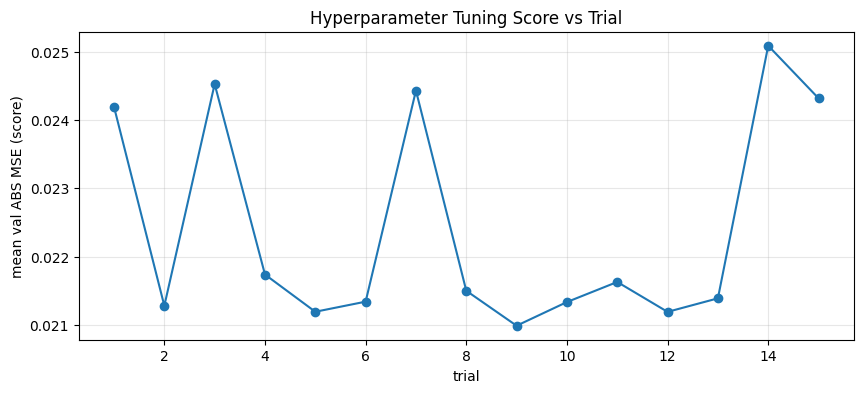

,trial,score,hidden_size,num_layers,dropout,lr,val_H,val_M,val_U,val_Z
0,9,0.020989,192,3,0.1,0.0010,0.018857,0.023251,0.022189,0.019657
1,12,0.021192,128,1,0.1,0.0010,0.019067,0.023412,0.022337,0.019951
2,5,0.021193,128,1,0.0,0.0010,0.019059,0.023536,0.022409,0.019769
3,2,0.021281,192,1,0.0,0.0010,0.019147,0.023381,0.022248,0.020347
4,10,0.021335,128,3,0.1,0.0003,0.019234,0.023690,0.022534,0.019882
5,6,0.021341,128,3,0.2,0.0010,0.019340,0.023691,0.022532,0.019800
6,13,0.021390,192,2,0.2,0.0003,0.019299,0.023739,0.022607,0.019913
7,8,0.021500,256,3,0.1,0.0010,0.019527,0.023704,0.022608,0.020161
8,11,0.021629,192,1,0.0,0.0003,0.019559,0.023905,0.022731,0.020321
9,4,0.021738,256,1,0.2,0.0003,0.019510,0.023989,0.022900,0.020552


{'hidden_size': 192, 'num_layers': 3, 'dropout': 0.1, 'lr': 0.001}

In [ ]:
# Hyperparameter tuning (verbose)
tune_out = tune_hyperparameters_verbose(
    model_name=MODEL_NAME,
    contract_splits=contract_splits,
    device=device,
    tune_trials=TUNE_TRIALS,
    tune_epochs=TUNE_EPOCHS,
    batch_size=BATCH_SIZE,
    horizon=HORIZON,
    max_train_batches_per_epoch=MAX_TRAIN_BATCHES_PER_EPOCH,
    max_val_batches=MAX_VAL_BATCHES,
    rng_seed=42,
)
best = tune_out['best']
trials_df = tune_out['trials_df']
plot_tuning_results(trials_df)
best_params = best['params']
assert best_params is not None
best_params

  0%|          | 0/138 [00:00<?, ?it/s]

epoch=001/50 lr=1.00e-03 train_delta_mse=0.035202 val_abs_mean=0.023337 val_H=0.020966 val_M=0.025500 val_U=0.024626 val_Z=0.022258


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=002/50 lr=1.00e-03 train_delta_mse=0.027927 val_abs_mean=0.023741 val_H=0.022222 val_M=0.025405 val_U=0.024280 val_Z=0.023058


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=003/50 lr=1.00e-03 train_delta_mse=0.027448 val_abs_mean=0.021221 val_H=0.019199 val_M=0.023560 val_U=0.022453 val_Z=0.019671


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=004/50 lr=1.00e-03 train_delta_mse=0.026934 val_abs_mean=0.021720 val_H=0.019528 val_M=0.023982 val_U=0.022845 val_Z=0.020526


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=005/50 lr=1.00e-03 train_delta_mse=0.026639 val_abs_mean=0.021409 val_H=0.019495 val_M=0.023612 val_U=0.022478 val_Z=0.020050


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=006/50 lr=1.00e-03 train_delta_mse=0.026384 val_abs_mean=0.022005 val_H=0.019921 val_M=0.024119 val_U=0.022945 val_Z=0.021036


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=007/50 lr=5.00e-04 train_delta_mse=0.026349 val_abs_mean=0.021303 val_H=0.019082 val_M=0.023530 val_U=0.022366 val_Z=0.020231


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=008/50 lr=5.00e-04 train_delta_mse=0.026010 val_abs_mean=0.021299 val_H=0.019365 val_M=0.023233 val_U=0.022177 val_Z=0.020422


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=009/50 lr=5.00e-04 train_delta_mse=0.025898 val_abs_mean=0.021421 val_H=0.019238 val_M=0.023433 val_U=0.022406 val_Z=0.020606


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=010/50 lr=5.00e-04 train_delta_mse=0.025814 val_abs_mean=0.021289 val_H=0.019211 val_M=0.023403 val_U=0.022175 val_Z=0.020367


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=011/50 lr=5.00e-04 train_delta_mse=0.025738 val_abs_mean=0.020954 val_H=0.018900 val_M=0.023150 val_U=0.021940 val_Z=0.019824


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=012/50 lr=5.00e-04 train_delta_mse=0.025654 val_abs_mean=0.020875 val_H=0.018872 val_M=0.023087 val_U=0.021823 val_Z=0.019717


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=013/50 lr=5.00e-04 train_delta_mse=0.025633 val_abs_mean=0.020929 val_H=0.018817 val_M=0.023171 val_U=0.022040 val_Z=0.019688


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=014/50 lr=5.00e-04 train_delta_mse=0.025511 val_abs_mean=0.020886 val_H=0.019118 val_M=0.022901 val_U=0.021661 val_Z=0.019865


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=015/50 lr=5.00e-04 train_delta_mse=0.025411 val_abs_mean=0.020656 val_H=0.018695 val_M=0.022888 val_U=0.021589 val_Z=0.019451


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=016/50 lr=5.00e-04 train_delta_mse=0.025358 val_abs_mean=0.020690 val_H=0.018646 val_M=0.022828 val_U=0.021726 val_Z=0.019561


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=017/50 lr=5.00e-04 train_delta_mse=0.025327 val_abs_mean=0.020924 val_H=0.018720 val_M=0.023292 val_U=0.021980 val_Z=0.019704


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=018/50 lr=5.00e-04 train_delta_mse=0.025283 val_abs_mean=0.020552 val_H=0.018606 val_M=0.022784 val_U=0.021460 val_Z=0.019356


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=019/50 lr=5.00e-04 train_delta_mse=0.025262 val_abs_mean=0.020636 val_H=0.018588 val_M=0.022733 val_U=0.021695 val_Z=0.019530


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=020/50 lr=5.00e-04 train_delta_mse=0.025248 val_abs_mean=0.020614 val_H=0.018622 val_M=0.022795 val_U=0.021668 val_Z=0.019369


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=021/50 lr=5.00e-04 train_delta_mse=0.025195 val_abs_mean=0.020523 val_H=0.018569 val_M=0.022707 val_U=0.021602 val_Z=0.019213


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=022/50 lr=5.00e-04 train_delta_mse=0.025174 val_abs_mean=0.020493 val_H=0.018529 val_M=0.022531 val_U=0.021399 val_Z=0.019515


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=023/50 lr=5.00e-04 train_delta_mse=0.025104 val_abs_mean=0.020655 val_H=0.018705 val_M=0.022800 val_U=0.021555 val_Z=0.019558


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=024/50 lr=5.00e-04 train_delta_mse=0.025057 val_abs_mean=0.020659 val_H=0.018659 val_M=0.022798 val_U=0.021654 val_Z=0.019526


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=025/50 lr=5.00e-04 train_delta_mse=0.025104 val_abs_mean=0.020979 val_H=0.019109 val_M=0.022850 val_U=0.021863 val_Z=0.020094


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=026/50 lr=2.50e-04 train_delta_mse=0.025042 val_abs_mean=0.020745 val_H=0.018650 val_M=0.022737 val_U=0.021685 val_Z=0.019909


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=027/50 lr=2.50e-04 train_delta_mse=0.024852 val_abs_mean=0.020930 val_H=0.018820 val_M=0.022861 val_U=0.022057 val_Z=0.019980


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=028/50 lr=2.50e-04 train_delta_mse=0.024839 val_abs_mean=0.020506 val_H=0.018376 val_M=0.022551 val_U=0.021584 val_Z=0.019513


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=029/50 lr=2.50e-04 train_delta_mse=0.024817 val_abs_mean=0.020469 val_H=0.018389 val_M=0.022599 val_U=0.021502 val_Z=0.019386


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=030/50 lr=2.50e-04 train_delta_mse=0.024795 val_abs_mean=0.020572 val_H=0.018421 val_M=0.022685 val_U=0.021738 val_Z=0.019445


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=031/50 lr=2.50e-04 train_delta_mse=0.024822 val_abs_mean=0.020521 val_H=0.018471 val_M=0.022607 val_U=0.021520 val_Z=0.019485


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=032/50 lr=2.50e-04 train_delta_mse=0.024788 val_abs_mean=0.020891 val_H=0.018742 val_M=0.022950 val_U=0.022007 val_Z=0.019867


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=033/50 lr=1.25e-04 train_delta_mse=0.024780 val_abs_mean=0.020560 val_H=0.018452 val_M=0.022715 val_U=0.021614 val_Z=0.019460


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=034/50 lr=1.25e-04 train_delta_mse=0.024681 val_abs_mean=0.020527 val_H=0.018426 val_M=0.022583 val_U=0.021610 val_Z=0.019488


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=035/50 lr=1.25e-04 train_delta_mse=0.024650 val_abs_mean=0.020590 val_H=0.018302 val_M=0.022741 val_U=0.021766 val_Z=0.019551


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=036/50 lr=1.25e-04 train_delta_mse=0.024649 val_abs_mean=0.020681 val_H=0.018526 val_M=0.022846 val_U=0.021762 val_Z=0.019589


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=037/50 lr=1.25e-04 train_delta_mse=0.024675 val_abs_mean=0.020441 val_H=0.018403 val_M=0.022553 val_U=0.021380 val_Z=0.019426


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=038/50 lr=1.25e-04 train_delta_mse=0.024661 val_abs_mean=0.020586 val_H=0.018487 val_M=0.022578 val_U=0.021555 val_Z=0.019722


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=039/50 lr=1.25e-04 train_delta_mse=0.024627 val_abs_mean=0.020484 val_H=0.018411 val_M=0.022633 val_U=0.021530 val_Z=0.019364


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=040/50 lr=1.25e-04 train_delta_mse=0.024609 val_abs_mean=0.020594 val_H=0.018484 val_M=0.022682 val_U=0.021617 val_Z=0.019595


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=041/50 lr=6.25e-05 train_delta_mse=0.024620 val_abs_mean=0.020608 val_H=0.018400 val_M=0.022745 val_U=0.021702 val_Z=0.019583


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=042/50 lr=6.25e-05 train_delta_mse=0.024538 val_abs_mean=0.020551 val_H=0.018428 val_M=0.022677 val_U=0.021519 val_Z=0.019579


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=043/50 lr=6.25e-05 train_delta_mse=0.024535 val_abs_mean=0.020611 val_H=0.018521 val_M=0.022791 val_U=0.021599 val_Z=0.019534


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=044/50 lr=6.25e-05 train_delta_mse=0.024530 val_abs_mean=0.020605 val_H=0.018451 val_M=0.022712 val_U=0.021598 val_Z=0.019660


  0%|          | 0/138 [00:00<?, ?it/s]

epoch=045/50 lr=3.13e-05 train_delta_mse=0.024521 val_abs_mean=0.020644 val_H=0.018542 val_M=0.022732 val_U=0.021625 val_Z=0.019678
early_stop: epoch=45 best_epoch=37 best_val_abs_mean=0.020441


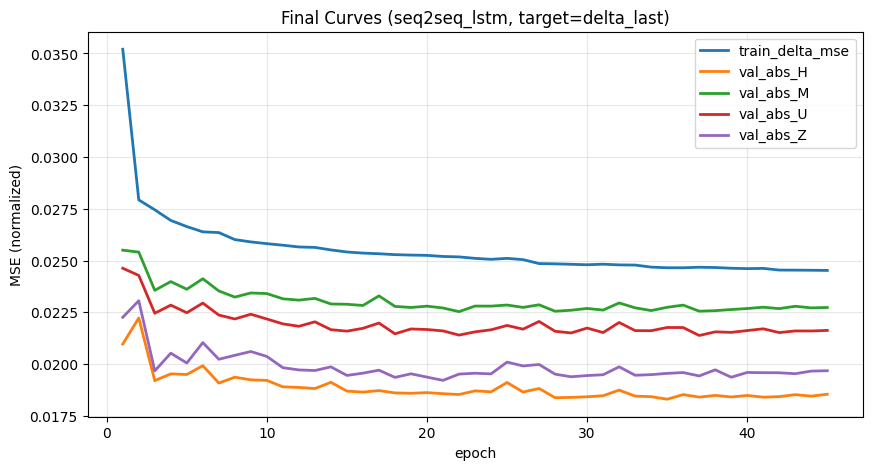

In [ ]:
# Final training with best hyperparameters
name = MODEL_NAME.strip().lower()
if name == 'direct_lstm':
    model = build_direct_lstm_forecaster(
        input_size=len(FEATURE_COLS),
        hidden_size=best_params['hidden_size'],
        num_layers=best_params['num_layers'],
        dropout=best_params['dropout'],
        horizon=HORIZON,
        output_size=len(FEATURE_COLS),
    ).to(device)
elif name == 'attn_lstm':
    model = build_attn_lstm_forecaster(
        input_size=len(FEATURE_COLS),
        hidden_size=best_params['hidden_size'],
        num_layers=best_params['num_layers'],
        dropout=best_params['dropout'],
        horizon=HORIZON,
        output_size=len(FEATURE_COLS),
    ).to(device)
elif name == 'cnn_lstm':
    model = build_cnn_lstm_forecaster(
        input_size=len(FEATURE_COLS),
        hidden_size=best_params['hidden_size'],
        num_layers=best_params['num_layers'],
        dropout=best_params['dropout'],
        horizon=HORIZON,
        output_size=len(FEATURE_COLS),
    ).to(device)
elif name == 'seq2seq_lstm':
    model = build_seq2seq_lstm_forecaster(
        input_size=len(FEATURE_COLS),
        hidden_size=best_params['hidden_size'],
        num_layers=best_params['num_layers'],
        dropout=best_params['dropout'],
    ).to(device)
else:
    model = build_model(name=MODEL_NAME, horizon=HORIZON, output_size=len(FEATURE_COLS)).to(device)

train_concat = ConcatDataset([contract_splits[c]['train'] for c in contract_splits])
train_loader = DataLoader(train_concat, batch_size=BATCH_SIZE, shuffle=True, num_workers=0, drop_last=True)
val_loaders = {
    f"val_{c}": DataLoader(contract_splits[c]['val'], batch_size=BATCH_SIZE, shuffle=False, num_workers=0)
    for c in contract_splits
}

final_history = train_verbose(
    model,
    train_loader=train_loader,
    val_loaders=val_loaders,
    epochs=FINAL_EPOCHS,
    lr=best_params['lr'],
    device=device,
    patience=EARLY_STOPPING_PATIENCE,
)
plot_training_curves(final_history, title=f"Final Curves ({MODEL_NAME}, target={TARGET_MODE})")

In [ ]:
def last_input_close_unscaled(dataset: WeekToHourDataset, idx: int) -> float:
    start_day = dataset.week_starts[idx]
    seq = dataset._get_week_array(start_day)
    last_input = seq[dataset.input_len - 1]
    return float(last_input[CLOSE_IDX])

def compute_direction_confusion_matrix(
    *,
    model: nn.Module,
    test_sets: Dict[str, WeekToHourDataset],
    device: torch.device,
    max_samples_per_contract: int = 100,
) -> Tuple[np.ndarray, int]:
    y_true: List[int] = []
    y_pred: List[int] = []

    for c, ds in test_sets.items():
        n = min(len(ds), max_samples_per_contract)
        for i in range(n):
            pred, actual = predict_one_unscaled(model, ds, i, device)
            last_close = last_input_close_unscaled(ds, i)
            pred_close = pred[:, CLOSE_IDX]
            act_close = actual[:, CLOSE_IDX]

            pred_prev = np.concatenate([[last_close], pred_close[:-1]])
            act_prev = np.concatenate([[last_close], act_close[:-1]])

            pred_dir = (pred_close - pred_prev > 0).astype(np.int32)
            act_dir = (act_close - act_prev > 0).astype(np.int32)

            y_true.extend(act_dir.tolist())
            y_pred.extend(pred_dir.tolist())

    cm = confusion_matrix(np.array(y_true), np.array(y_pred), labels=[0, 1])
    return cm, len(y_true)

def per_sample_test_mse_curve(
    *,
    model: nn.Module,
    dataset: WeekToHourDataset,
    device: torch.device,
    max_samples: int = 200,
) -> np.ndarray:
    n = min(len(dataset), max_samples)
    mses = []
    for i in range(n):
        pred, actual = predict_one_unscaled(model, dataset, i, device)
        mses.append(float(np.mean((pred - actual) ** 2)))
    return np.array(mses, dtype=np.float32)

def plot_test_curves(test_sets: Dict[str, WeekToHourDataset], model: nn.Module, device: torch.device) -> None:
    plt.figure(figsize=(10, 4))
    for c, ds in test_sets.items():
        mses = per_sample_test_mse_curve(model=model, dataset=ds, device=device, max_samples=200)
        plt.plot(np.arange(len(mses)), mses, label=f"{c} per-sample MSE")
    plt.xlabel('sample index')
    plt.ylabel('MSE')
    plt.title('Test Per-Sample MSE Curves (subset)')
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.show()

test_mse: {'test_H': 0.014503922080621123, 'test_M': 0.01597135290503502, 'test_U': 0.017753471806645393, 'test_Z': 0.016176900640130044}


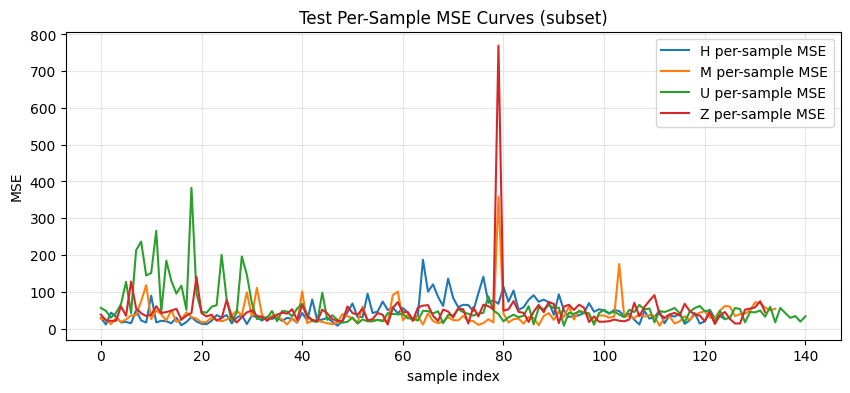

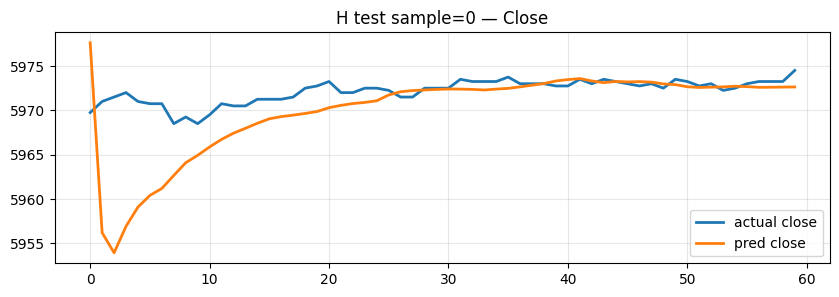

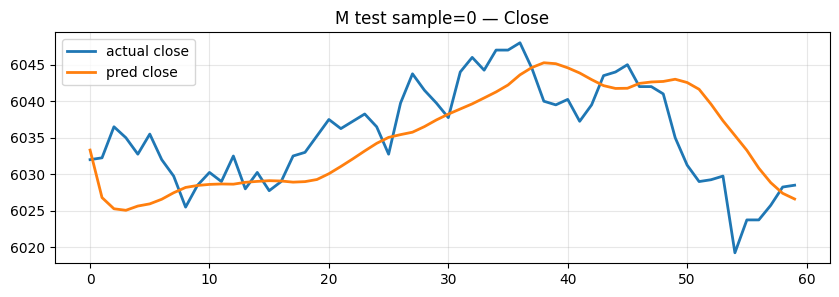

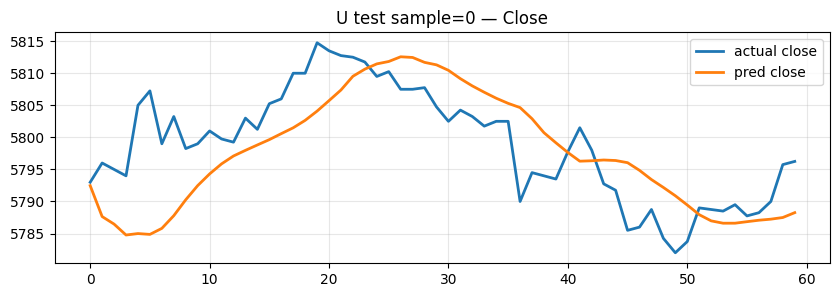

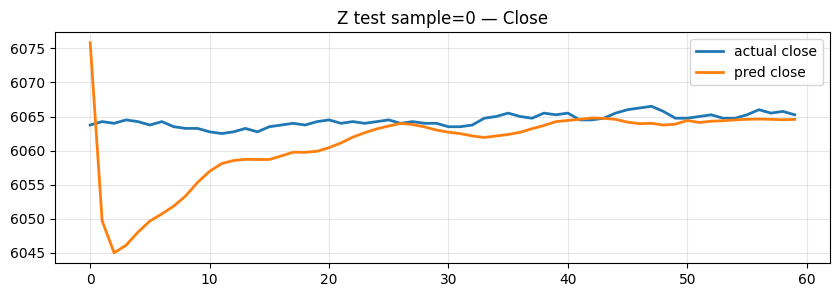

In [ ]:
# Test evaluation + "test curves"
test_loaders = {
    f"test_{c}": DataLoader(contract_splits[c]['test'], batch_size=BATCH_SIZE, shuffle=False, num_workers=0)
    for c in contract_splits
}
test_report = {name: evaluate_model(model, loader, device) for name, loader in test_loaders.items()}
print('test_mse:', {k: float(v) for k, v in test_report.items()})

test_sets = {c: contract_splits[c]['test'] for c in contract_splits}
plot_test_curves(test_sets, model, device)

# Plot a few qualitative forecast-vs-actual examples (close only)
for c in ['H','M','U','Z']:
    ds = test_sets[c]
    if len(ds) == 0:
        continue
    idx = 0
    pred, actual = predict_one_unscaled(model, ds, idx, device)
    plt.figure(figsize=(10, 3))
    plt.plot(actual[:, CLOSE_IDX], label='actual close', linewidth=2)
    plt.plot(pred[:, CLOSE_IDX], label='pred close', linewidth=2)
    plt.title(f"{c} test sample={idx} — Close")
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.show()

test_direction_confusion_matrix (rows=true [down/flat, up], cols=pred [down/flat, up]):
[[5540 7741]
 [4572 6147]] n_labels= 24000


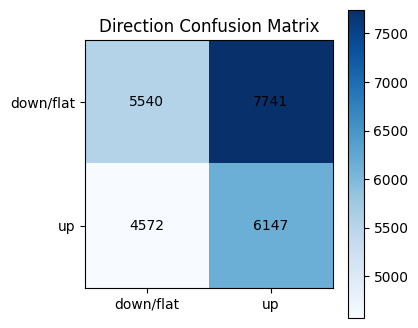

In [ ]:
# Direction confusion matrix (test) + heatmap
cm, n = compute_direction_confusion_matrix(model=model, test_sets=test_sets, device=device, max_samples_per_contract=100)
print('test_direction_confusion_matrix (rows=true [down/flat, up], cols=pred [down/flat, up]):')
print(cm, 'n_labels=', n)

plt.figure(figsize=(4,4))
plt.imshow(cm, cmap='Blues')
plt.title('Direction Confusion Matrix')
plt.xticks([0,1], ['down/flat','up'])
plt.yticks([0,1], ['down/flat','up'])
for (i,j), v in np.ndenumerate(cm):
    plt.text(j, i, str(v), ha='center', va='center', color='black')
plt.colorbar()
plt.show()

saved: /content/artifacts/lstm_forecaster.pt
saved: /content/artifacts/scaler.json
plot_saved: /content/artifacts/plot_H_test_0.png


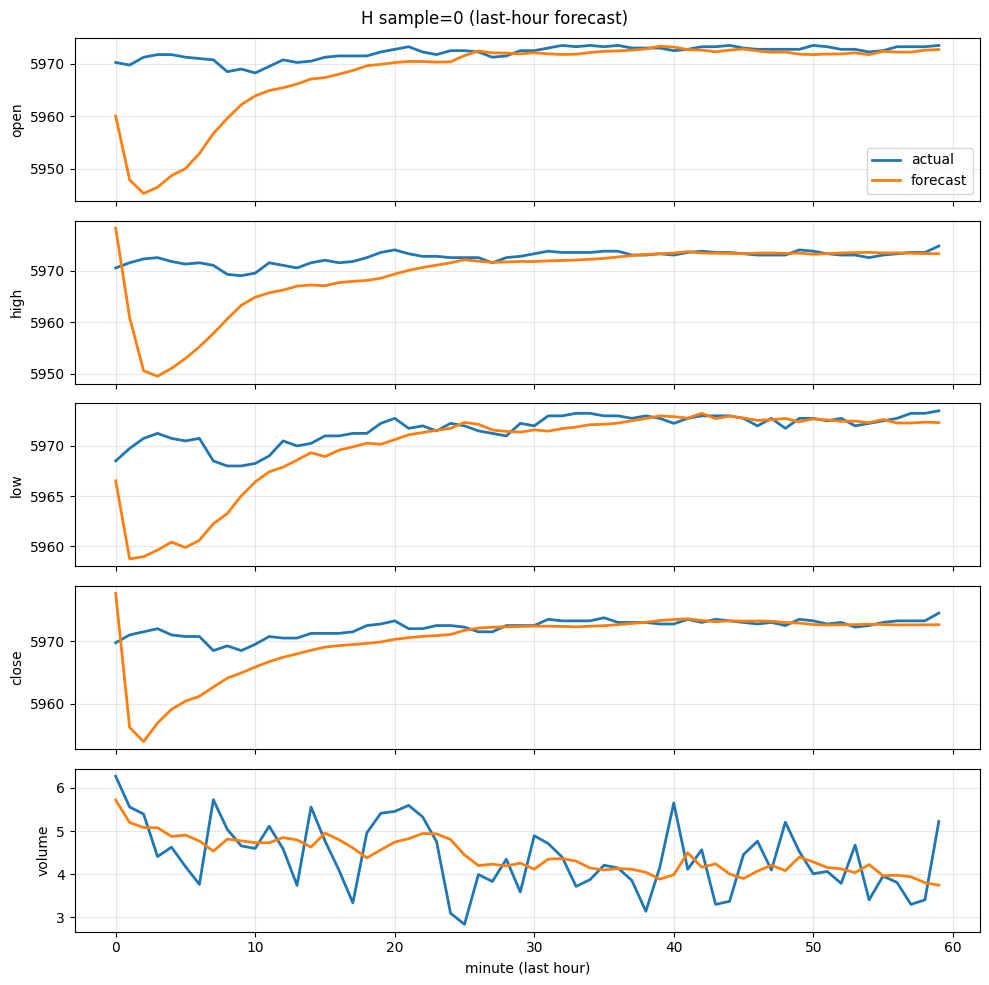

plot_saved: /content/artifacts/plot_H_test_1.png


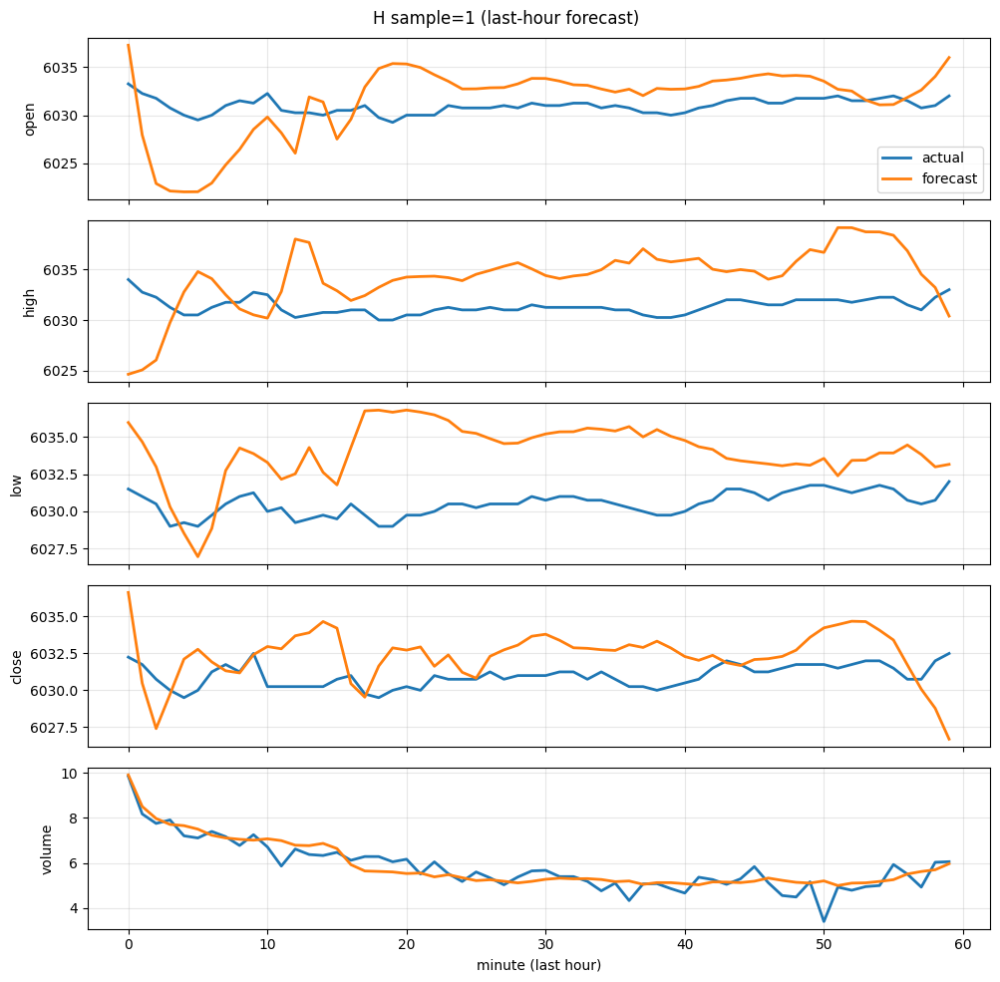

plot_saved: /content/artifacts/plot_H_test_2.png


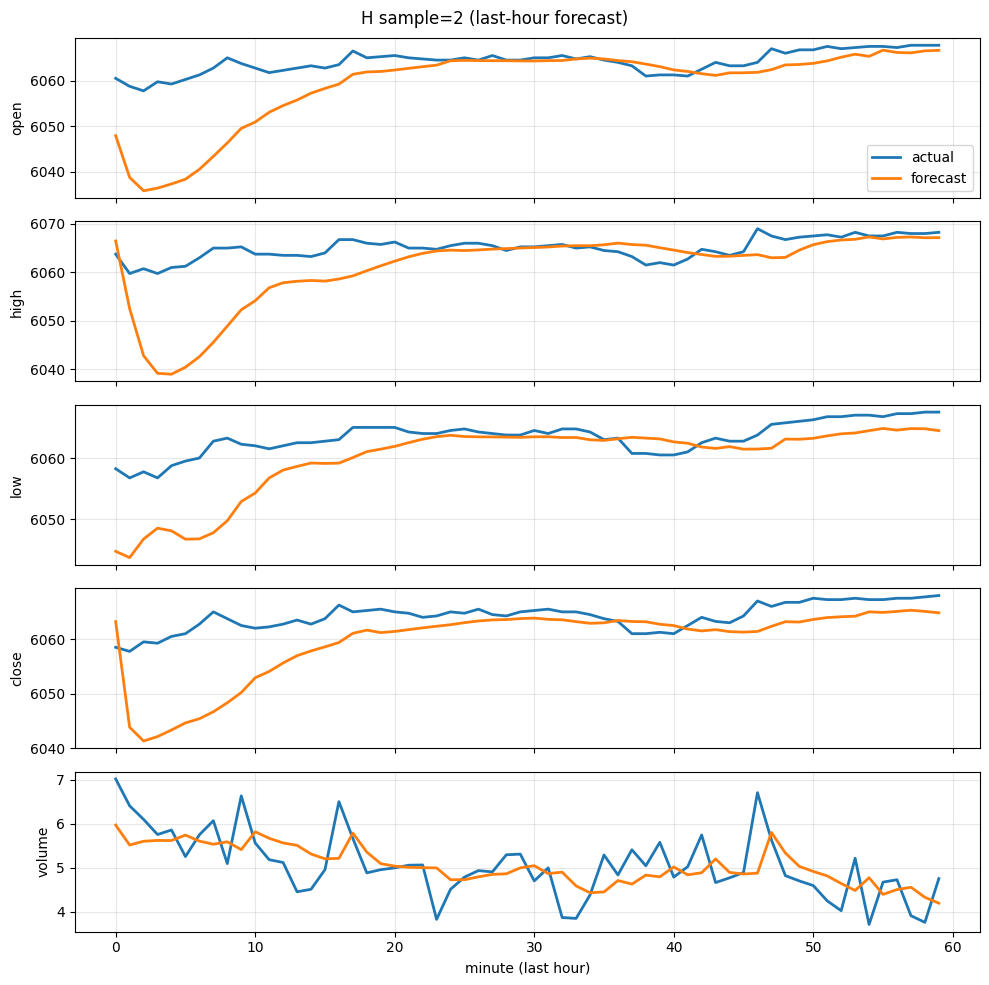

plot_saved: /content/artifacts/plot_H_test_3.png


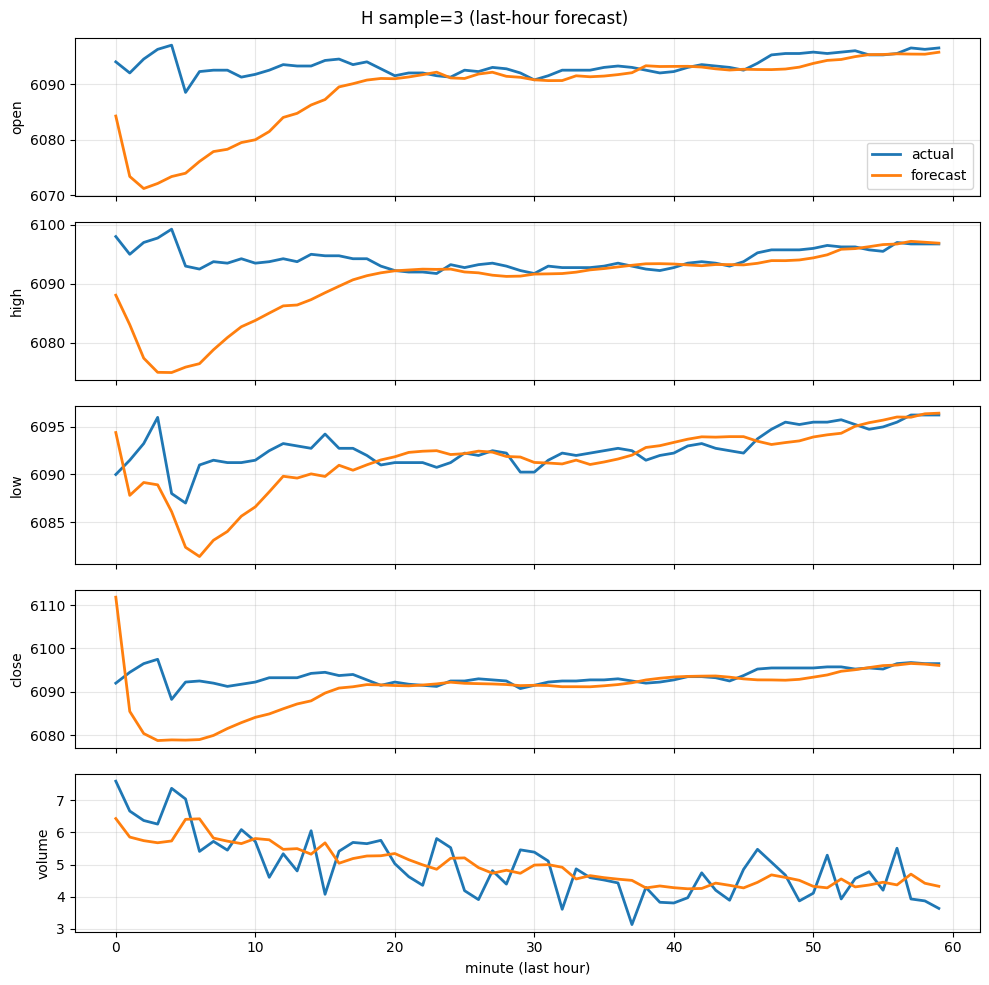

plot_saved: /content/artifacts/plot_H_test_4.png


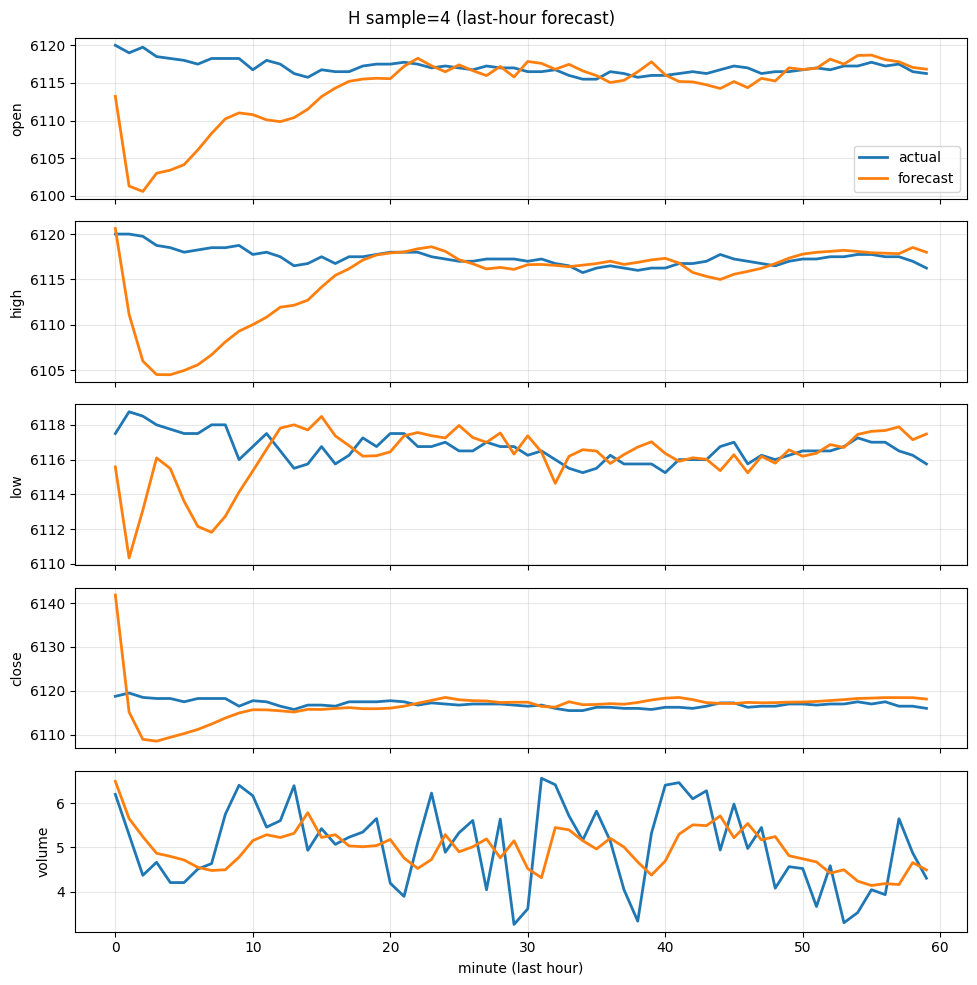

plot_saved: /content/artifacts/plot_H_test_5.png


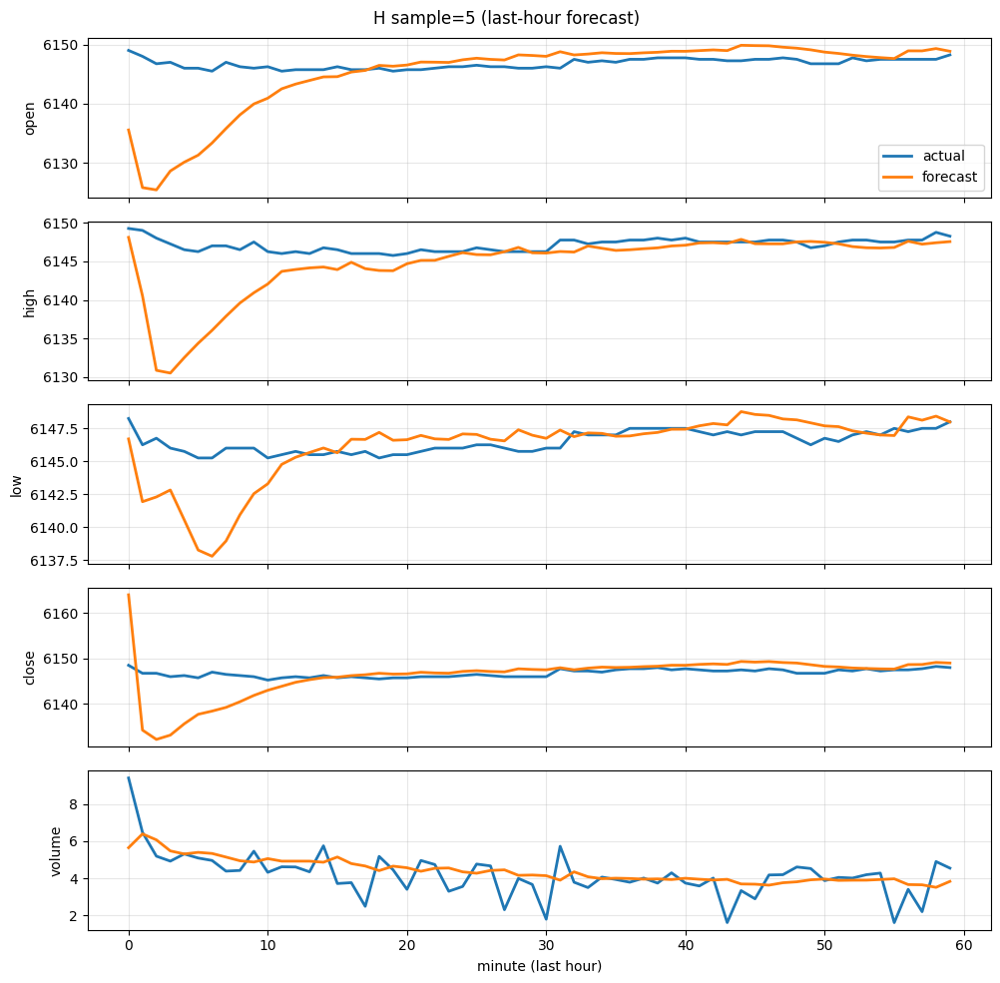

plot_saved: /content/artifacts/plot_H_test_6.png


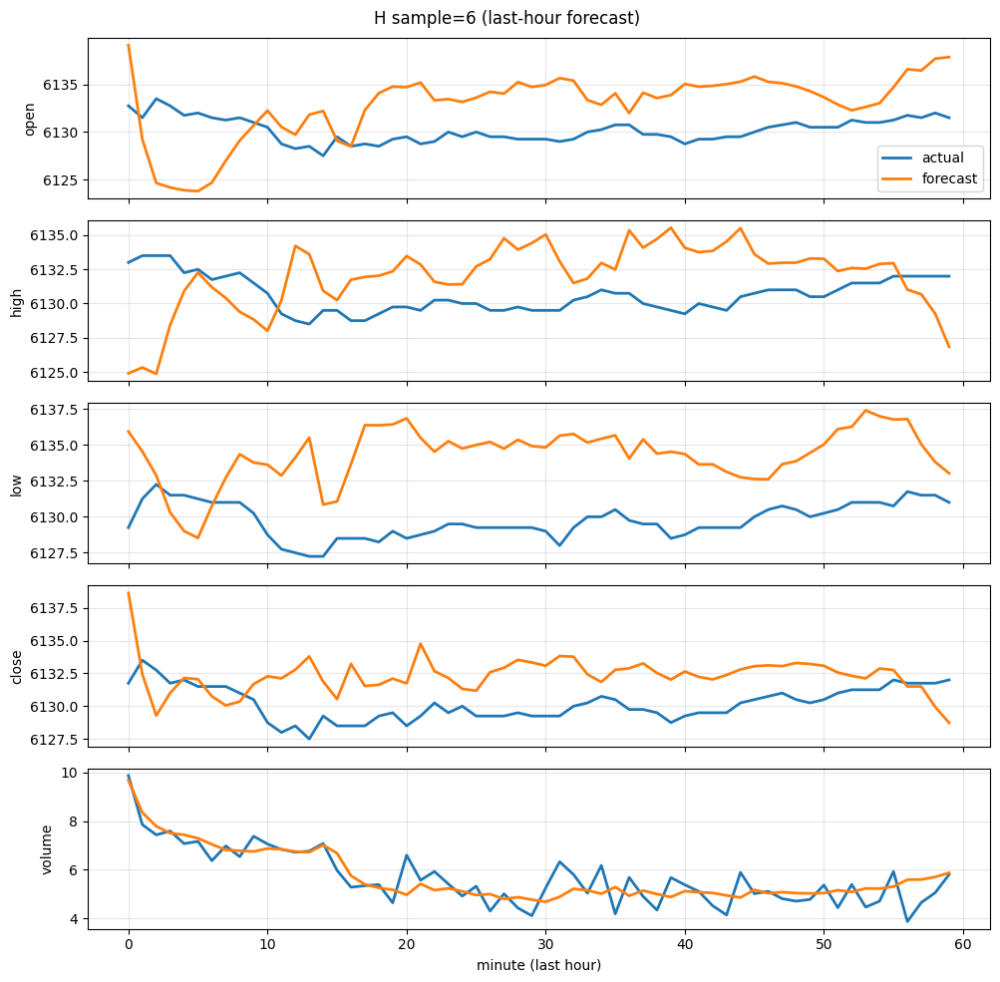

plot_saved: /content/artifacts/plot_H_test_7.png


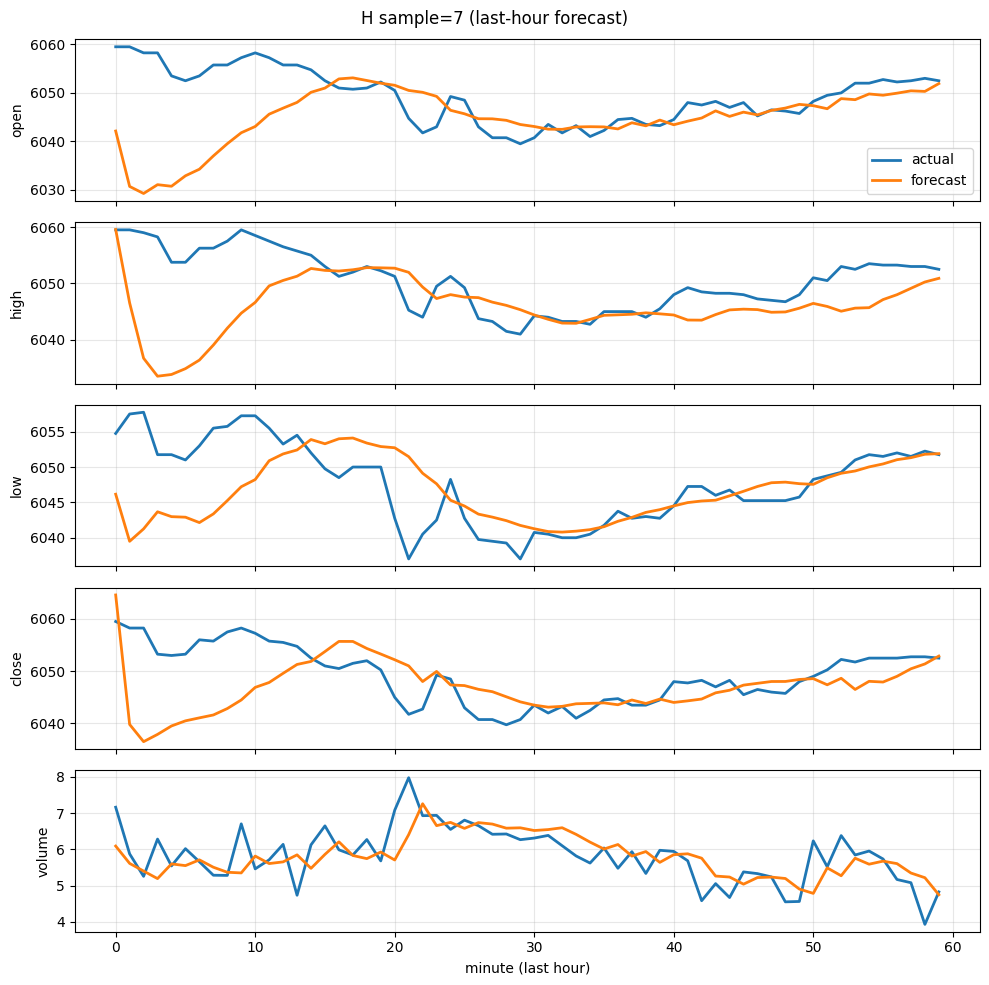

plot_saved: /content/artifacts/plot_H_test_8.png


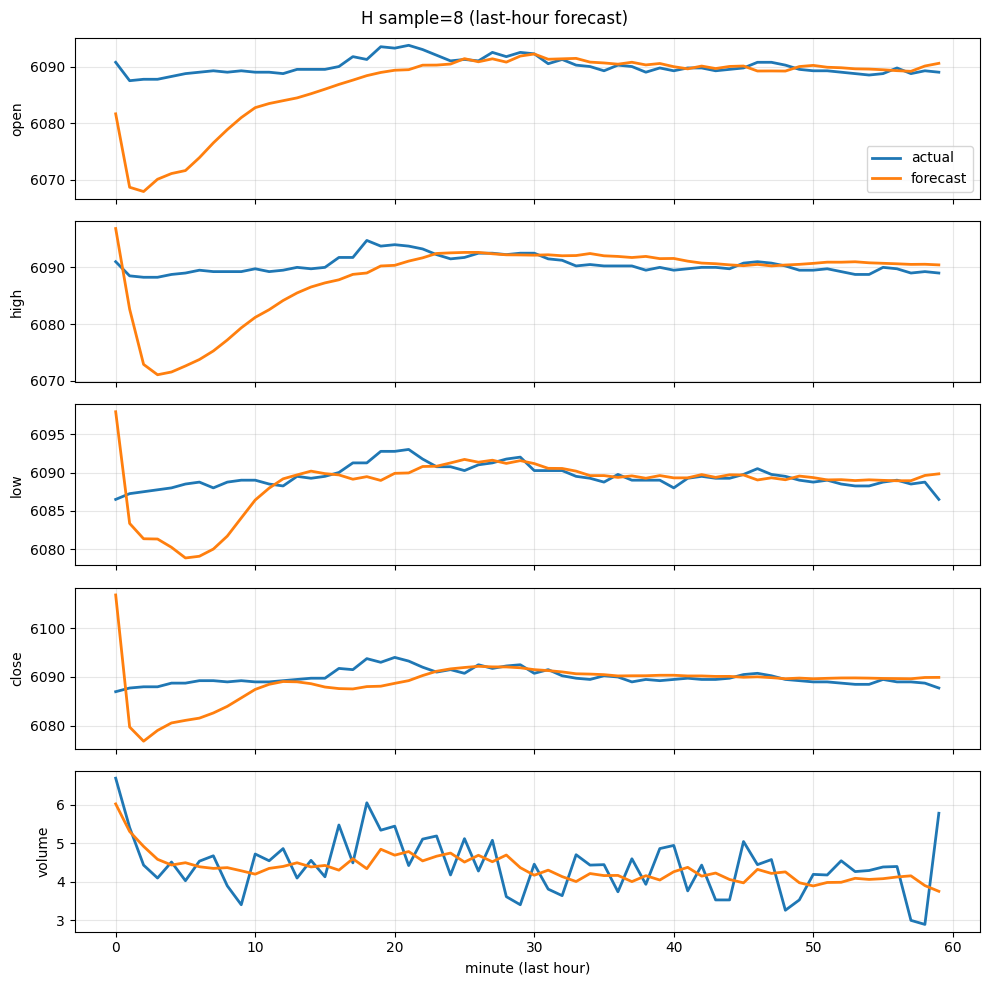

plot_saved: /content/artifacts/plot_H_test_9.png


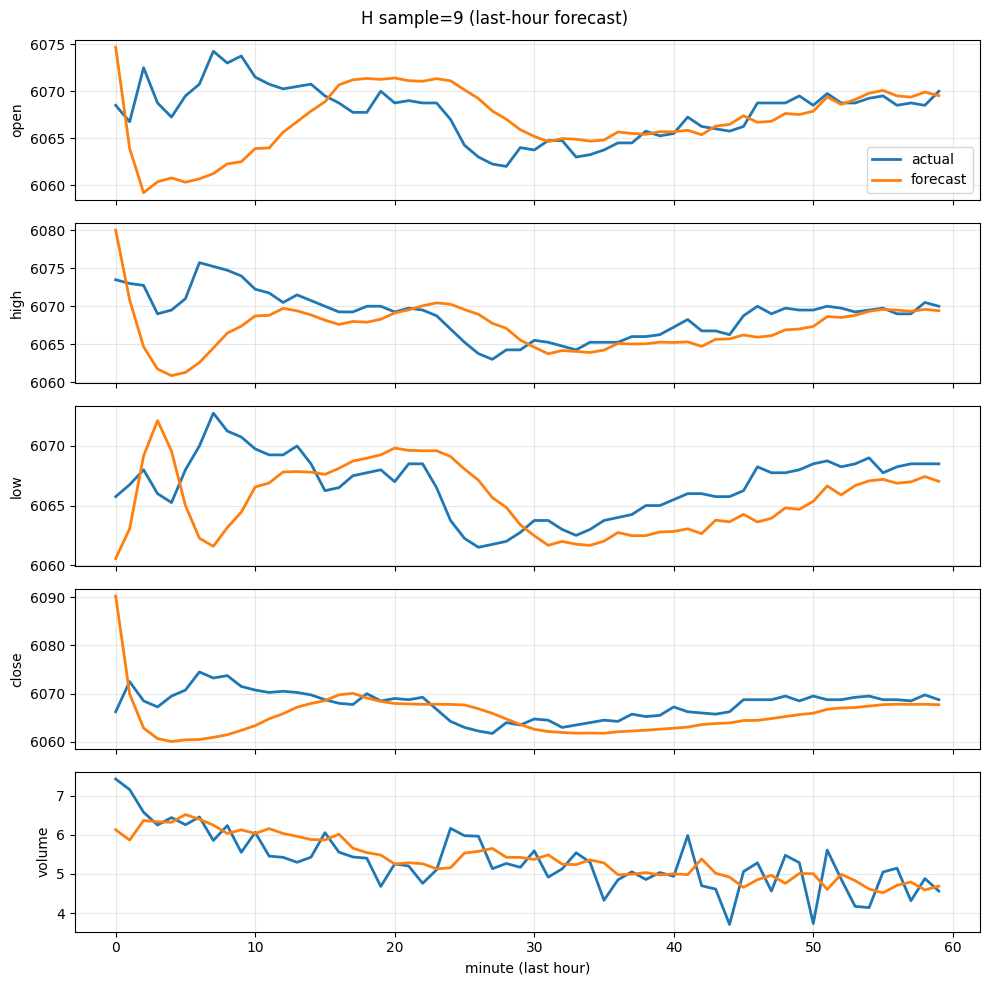

plot_saved: /content/artifacts/plot_H_test_10.png


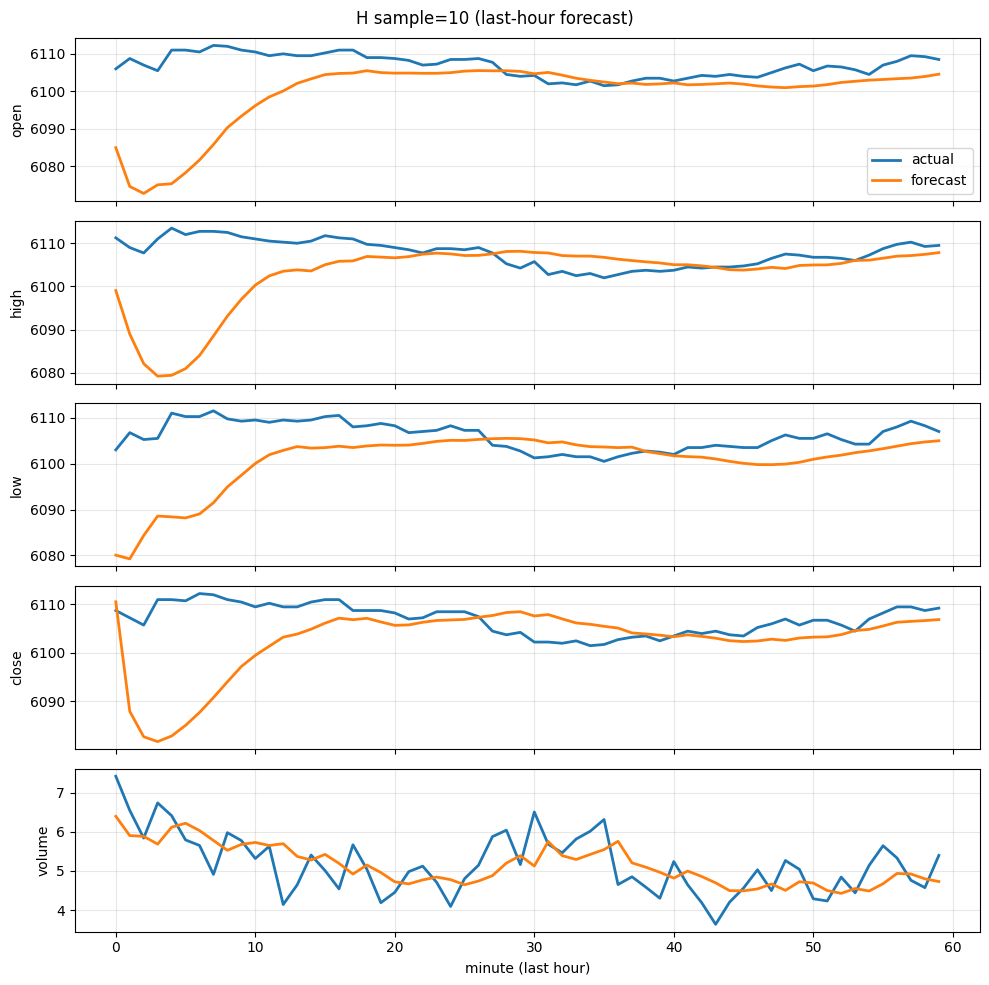

plot_saved: /content/artifacts/plot_H_test_11.png


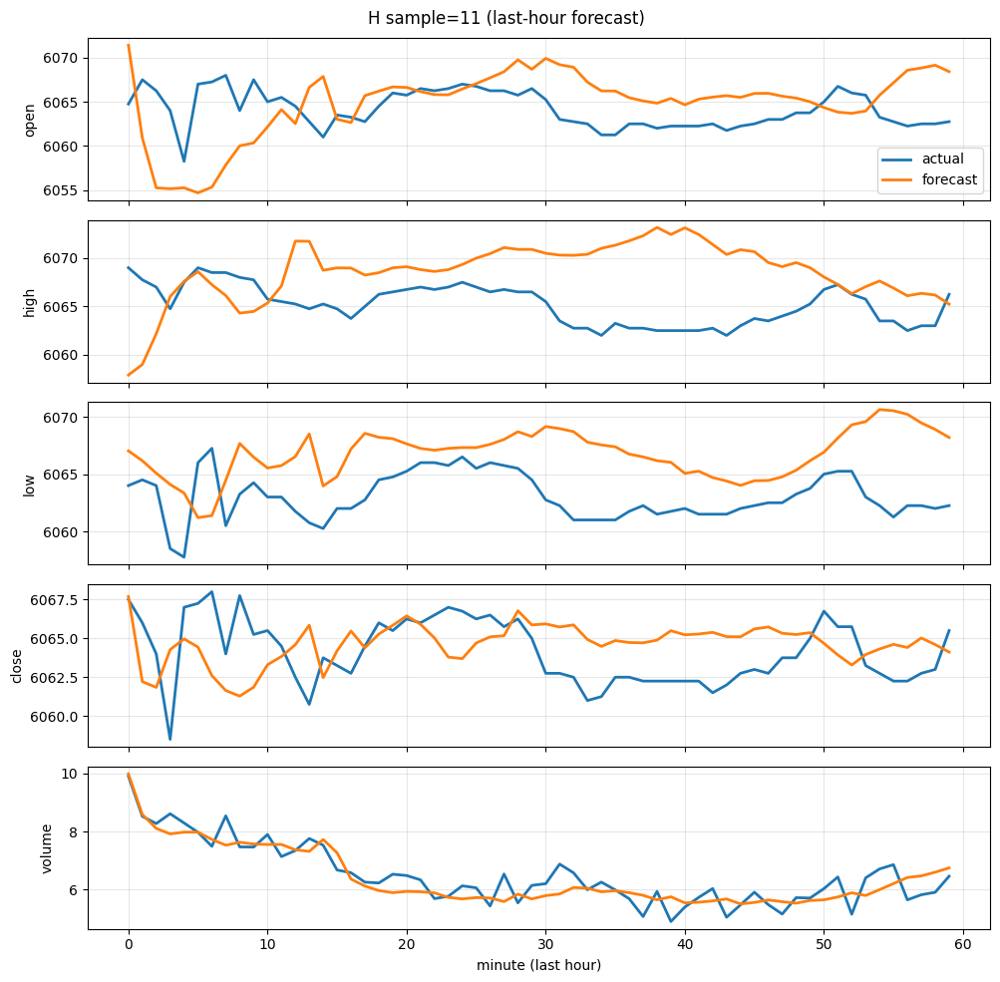

plot_saved: /content/artifacts/plot_H_test_12.png


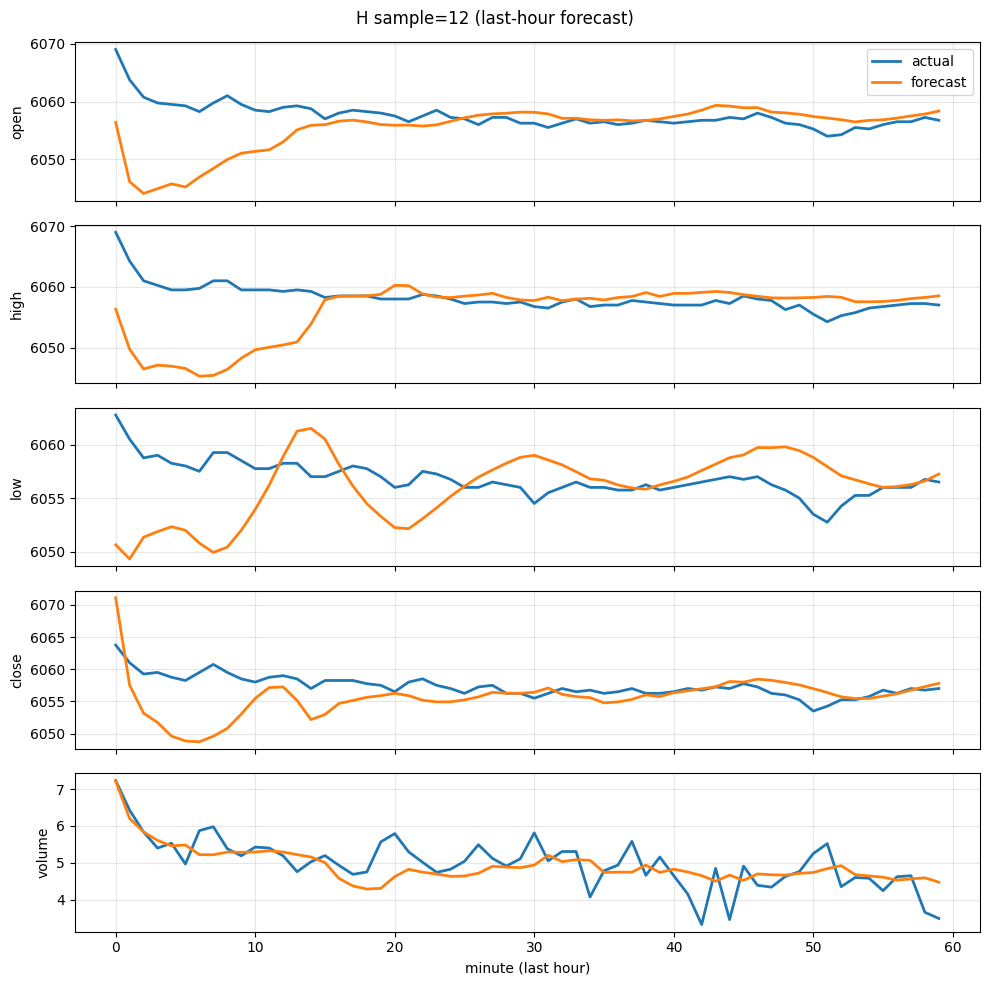

plot_saved: /content/artifacts/plot_H_test_13.png


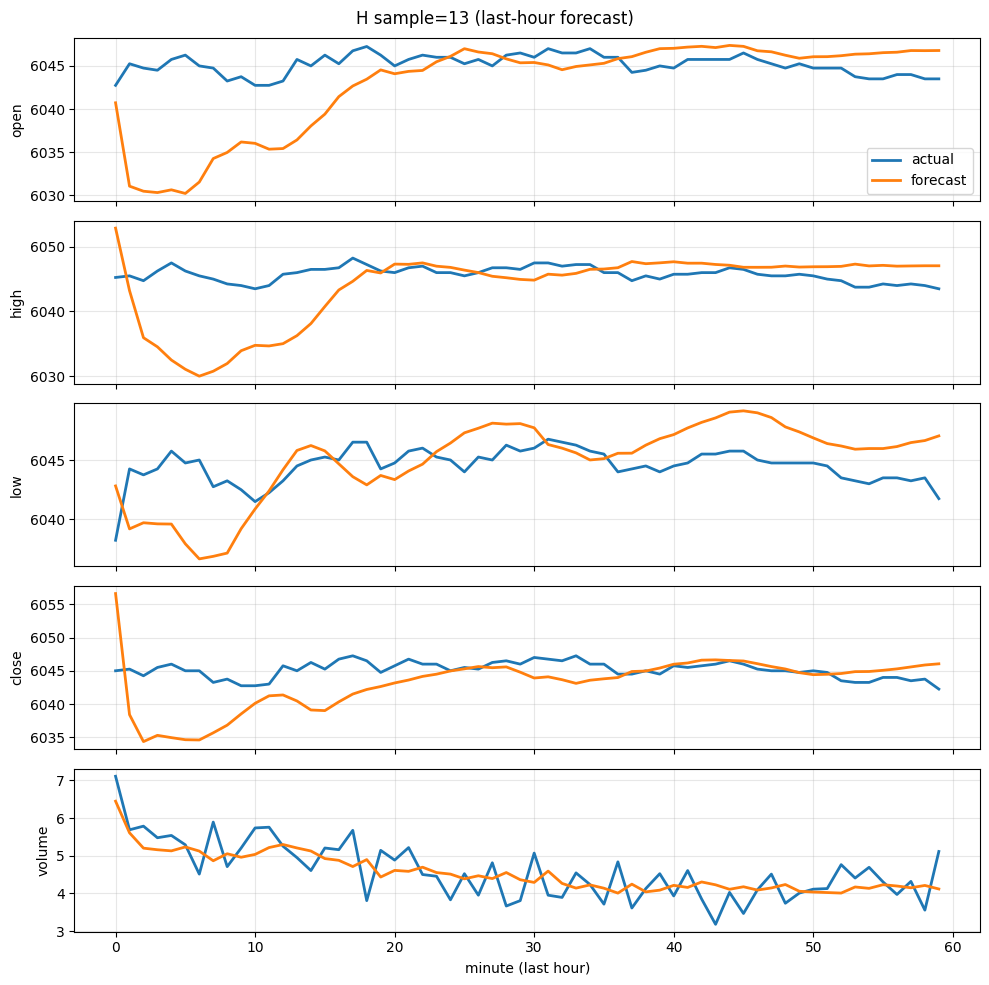

plot_saved: /content/artifacts/plot_H_test_14.png


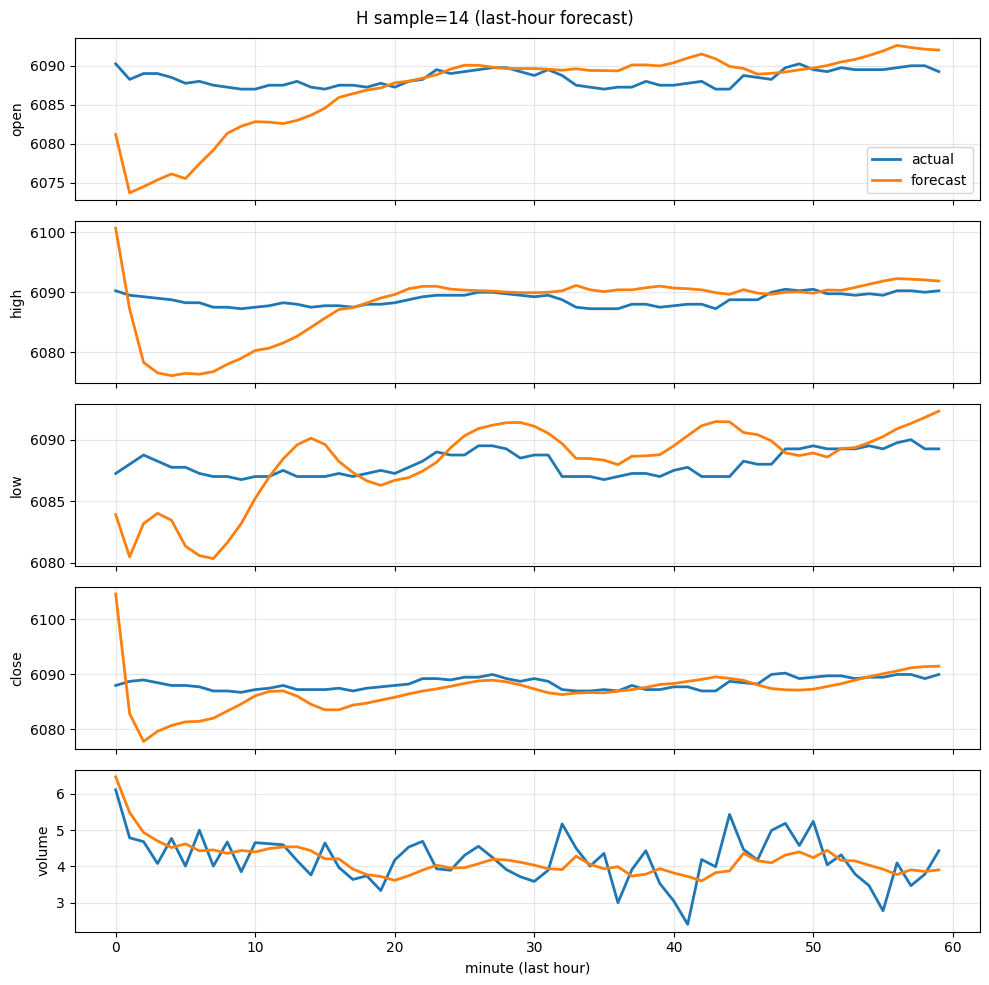

plot_saved: /content/artifacts/plot_H_test_15.png


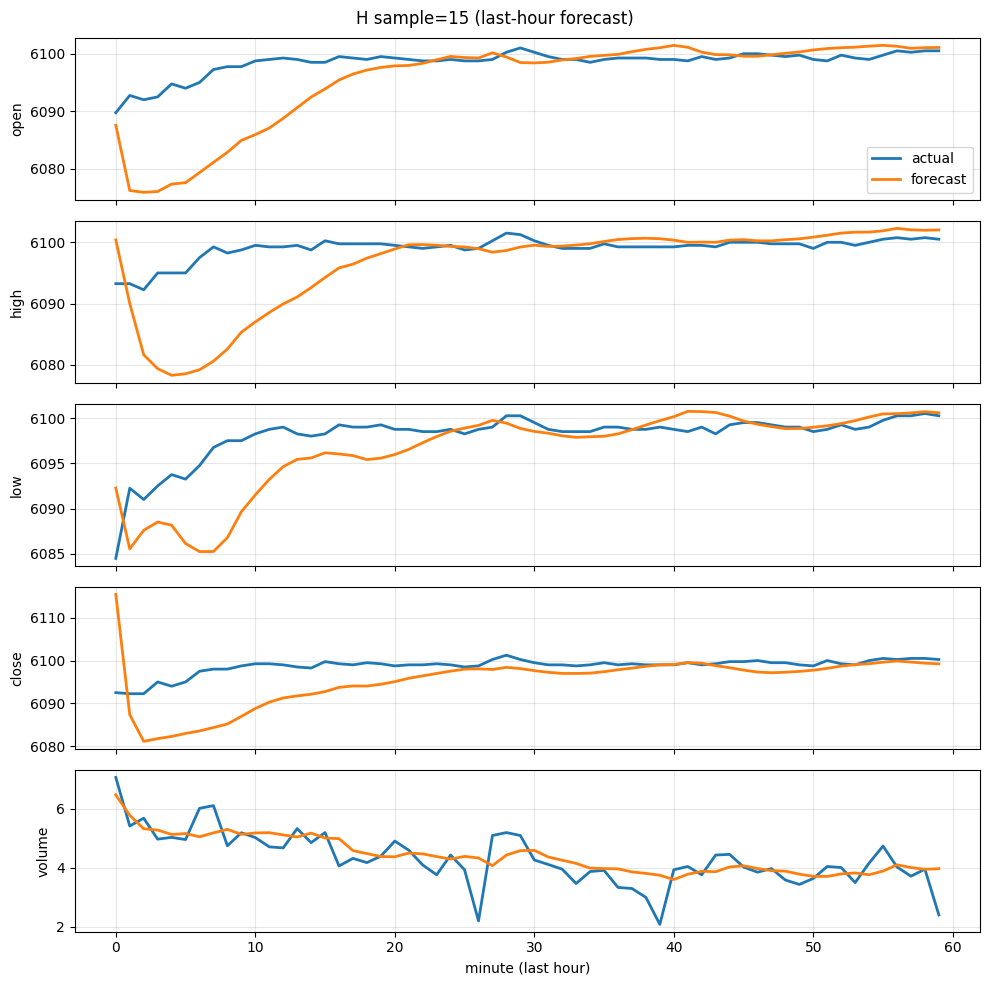

plot_saved: /content/artifacts/plot_H_test_16.png


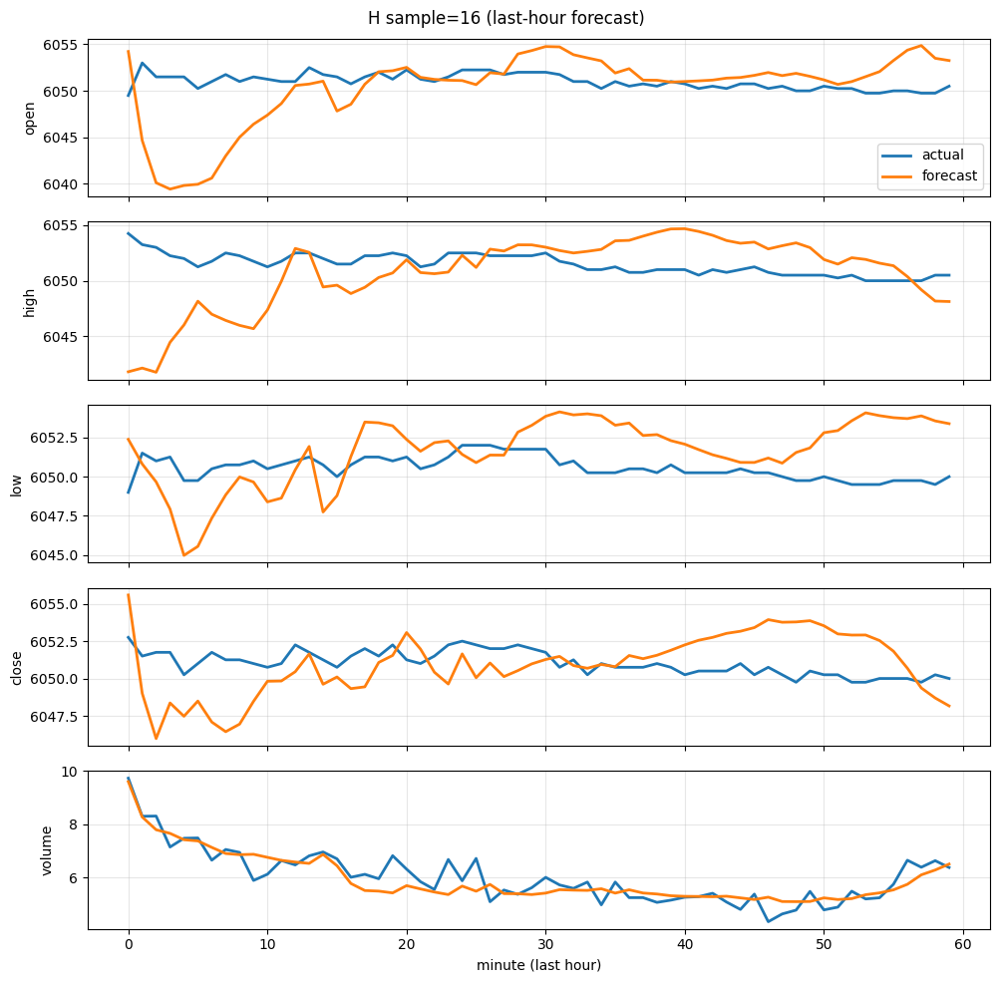

plot_saved: /content/artifacts/plot_H_test_17.png


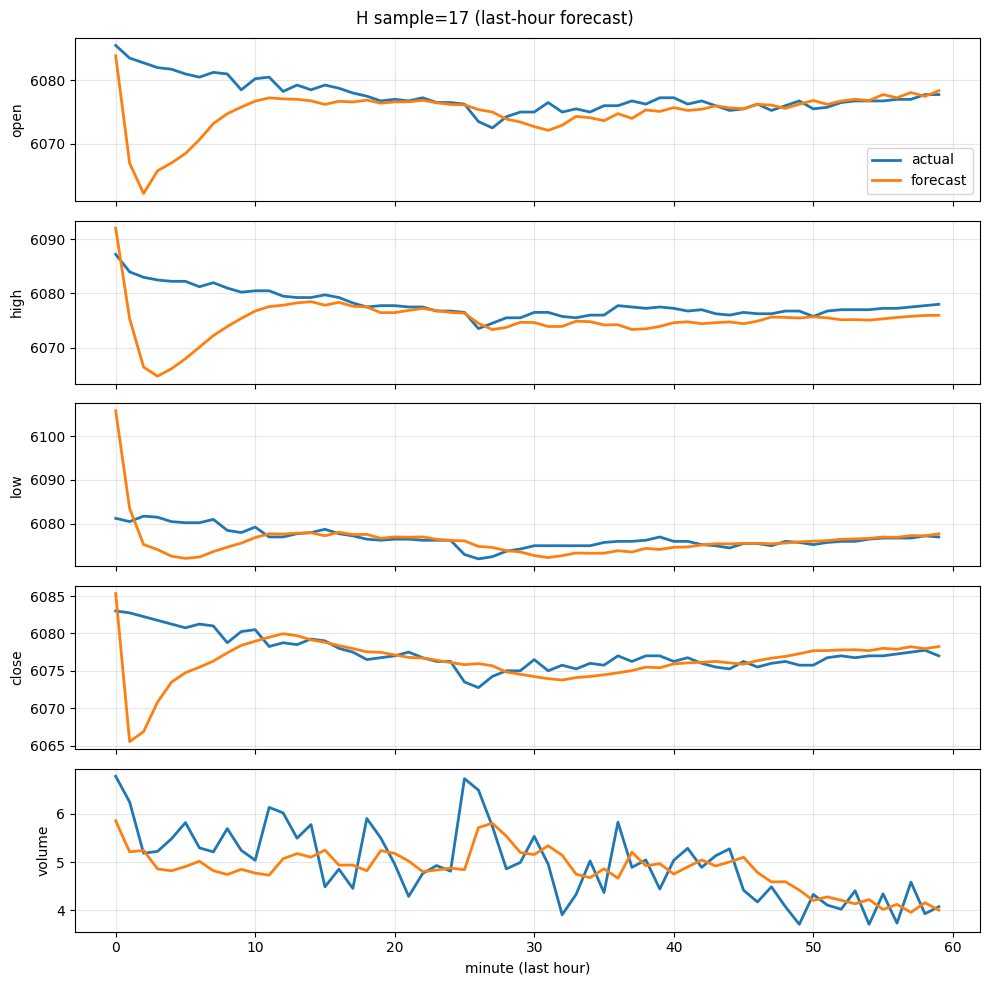

plot_saved: /content/artifacts/plot_H_test_18.png


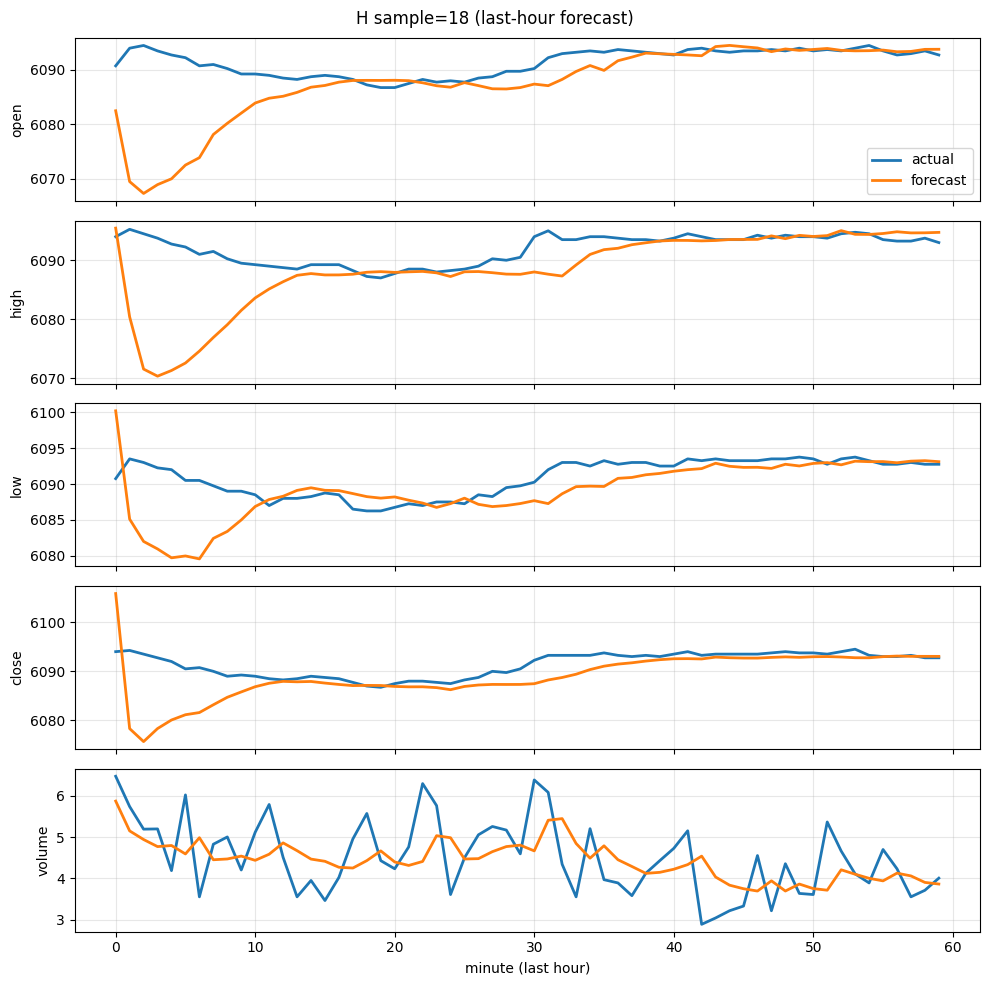

plot_saved: /content/artifacts/plot_H_test_19.png


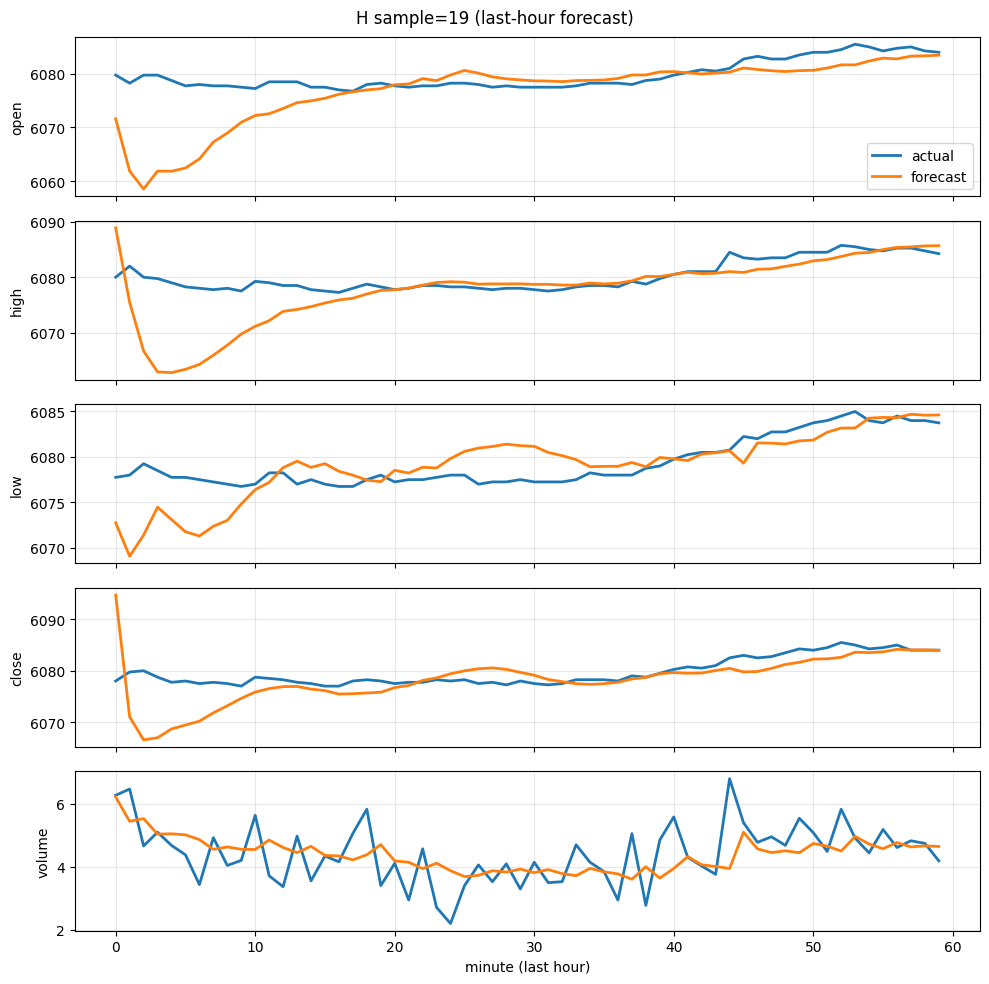

plot_saved: /content/artifacts/plot_H_test_20.png


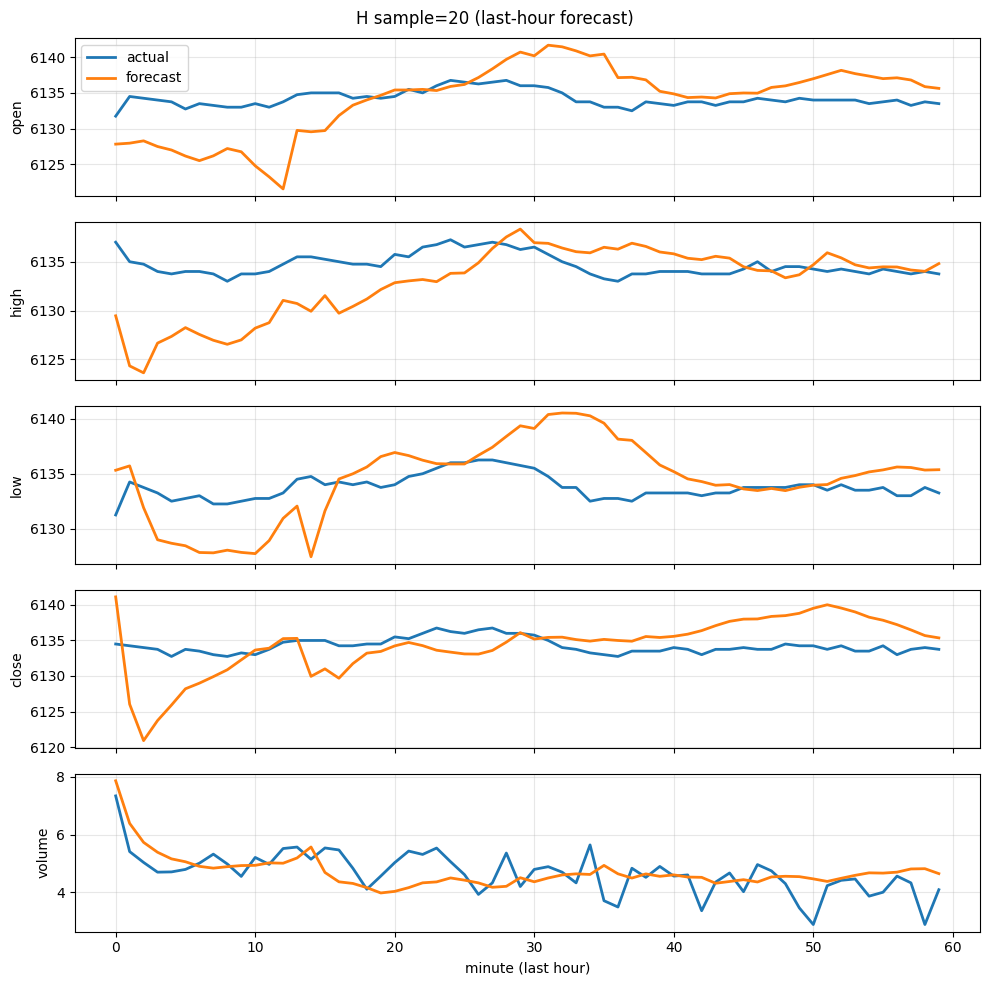

plot_saved: /content/artifacts/plot_H_test_21.png


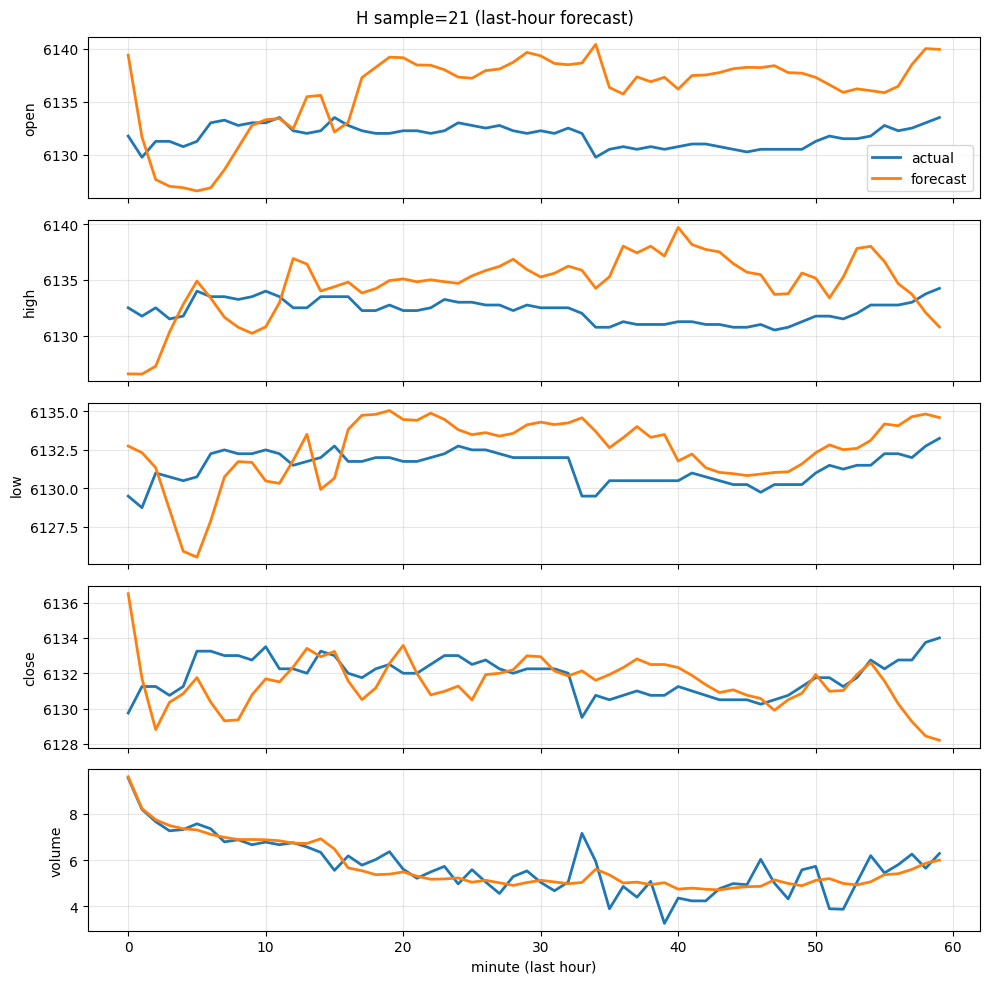

plot_saved: /content/artifacts/plot_H_test_22.png


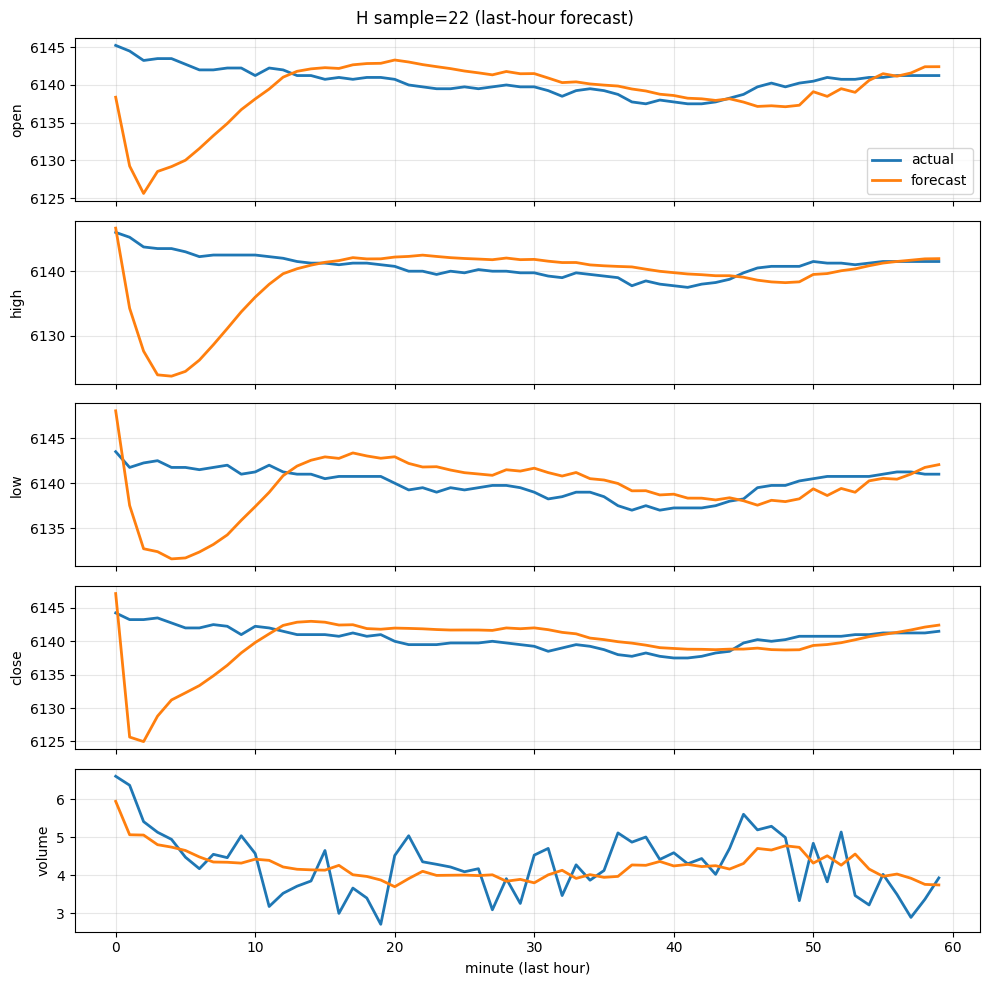

plot_saved: /content/artifacts/plot_H_test_23.png


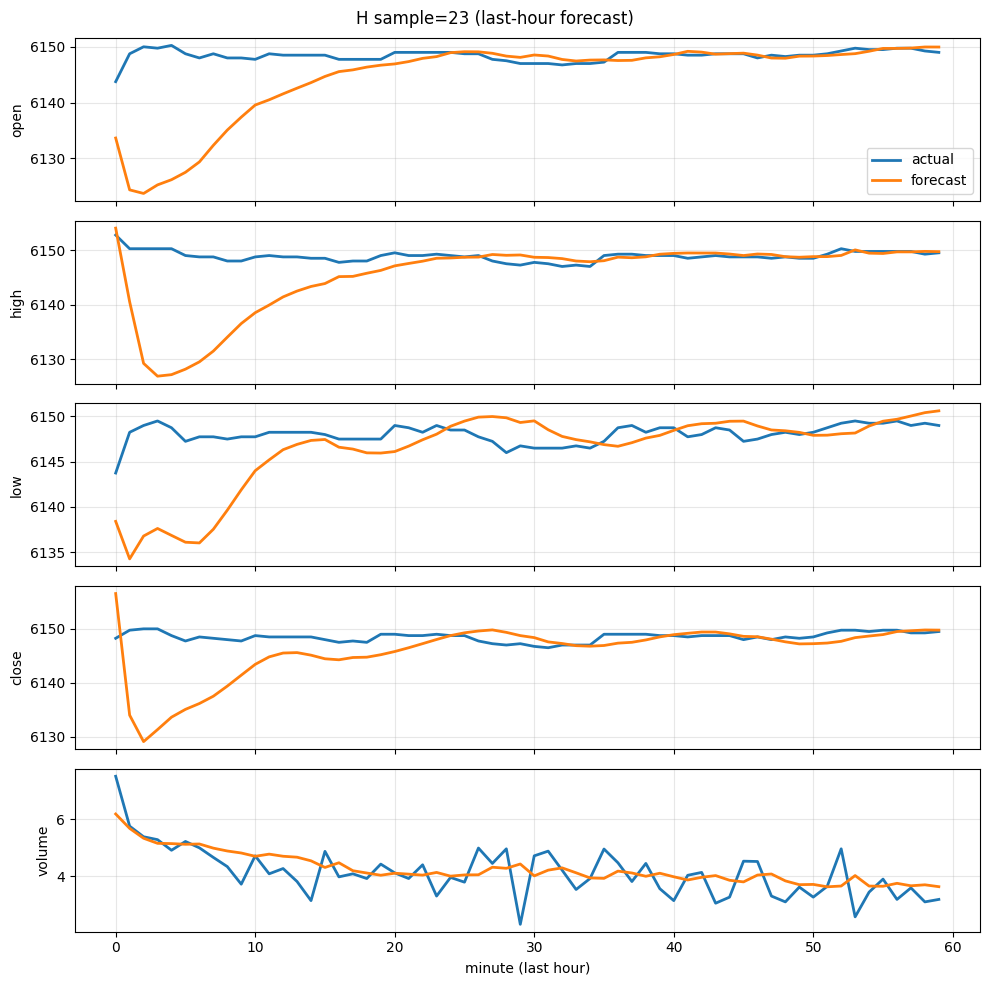

plot_saved: /content/artifacts/plot_H_test_24.png


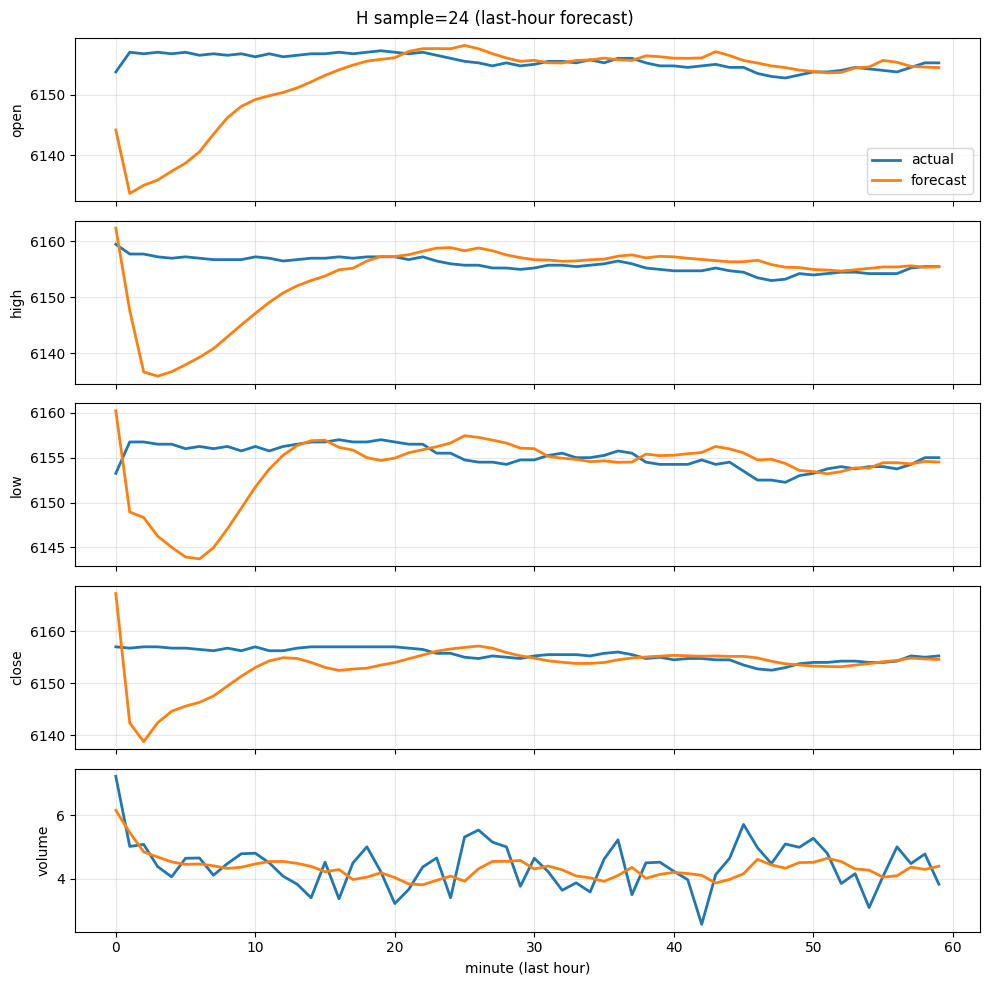

plot_saved: /content/artifacts/plot_H_test_25.png


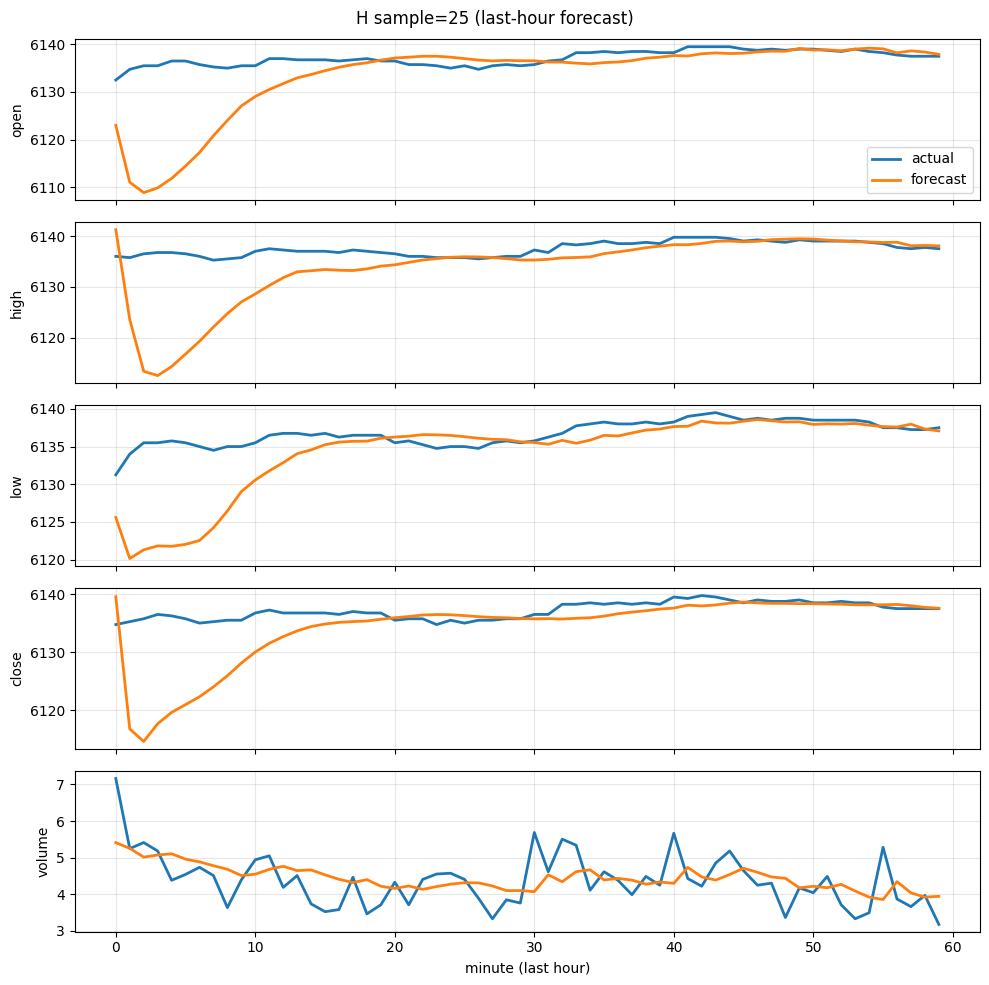

plot_saved: /content/artifacts/plot_H_test_26.png


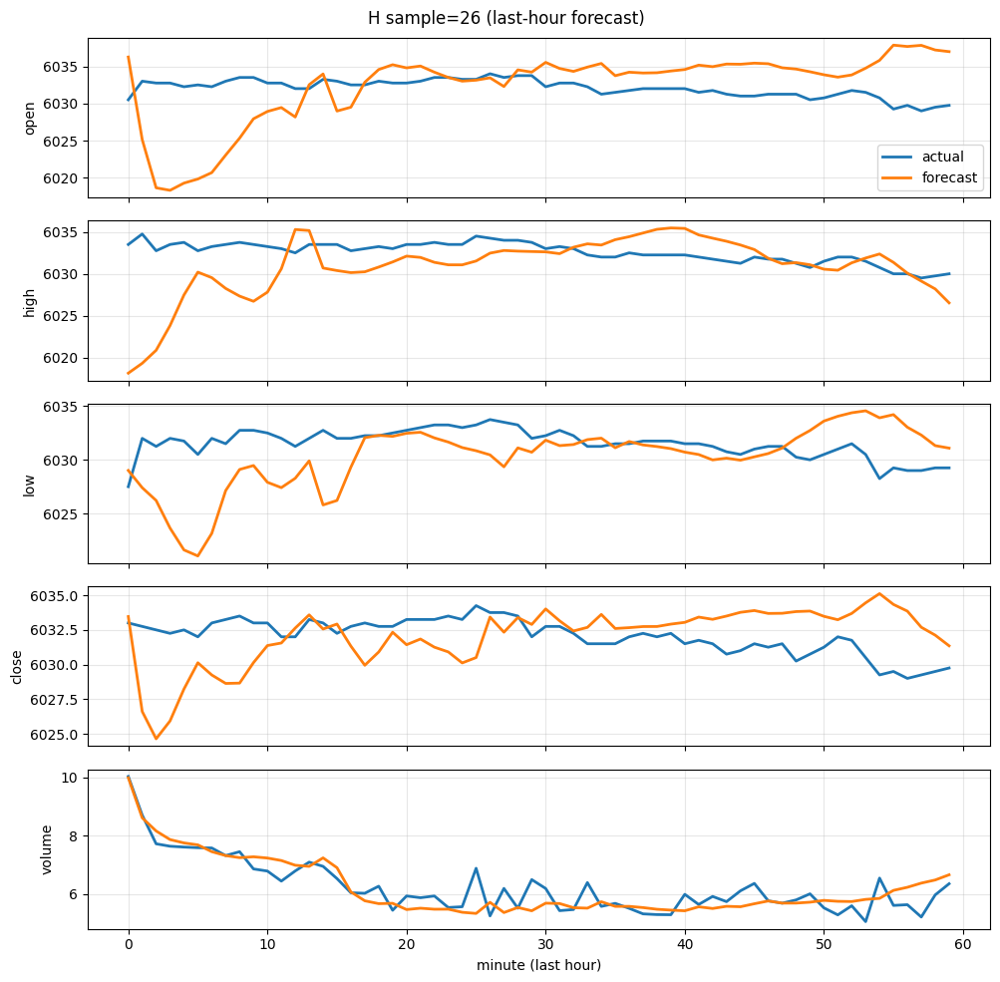

plot_saved: /content/artifacts/plot_H_test_27.png


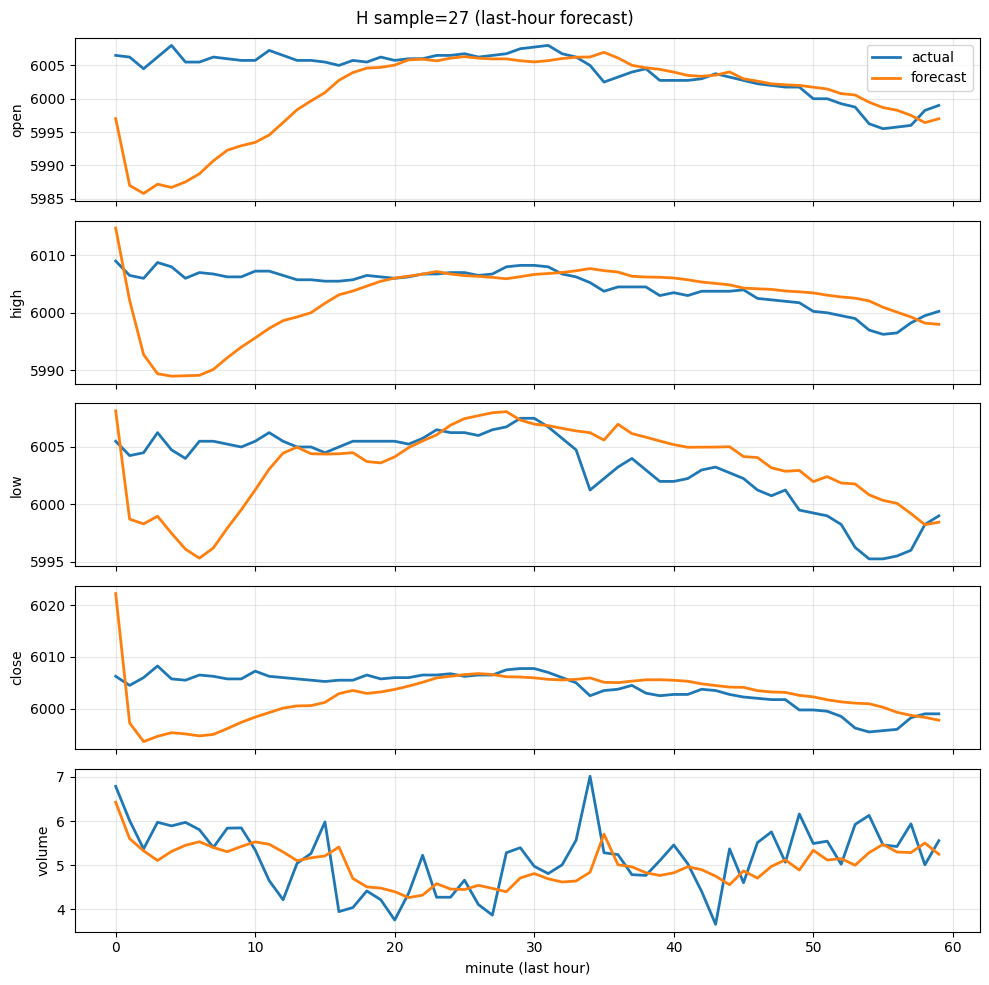

plot_saved: /content/artifacts/plot_H_test_28.png


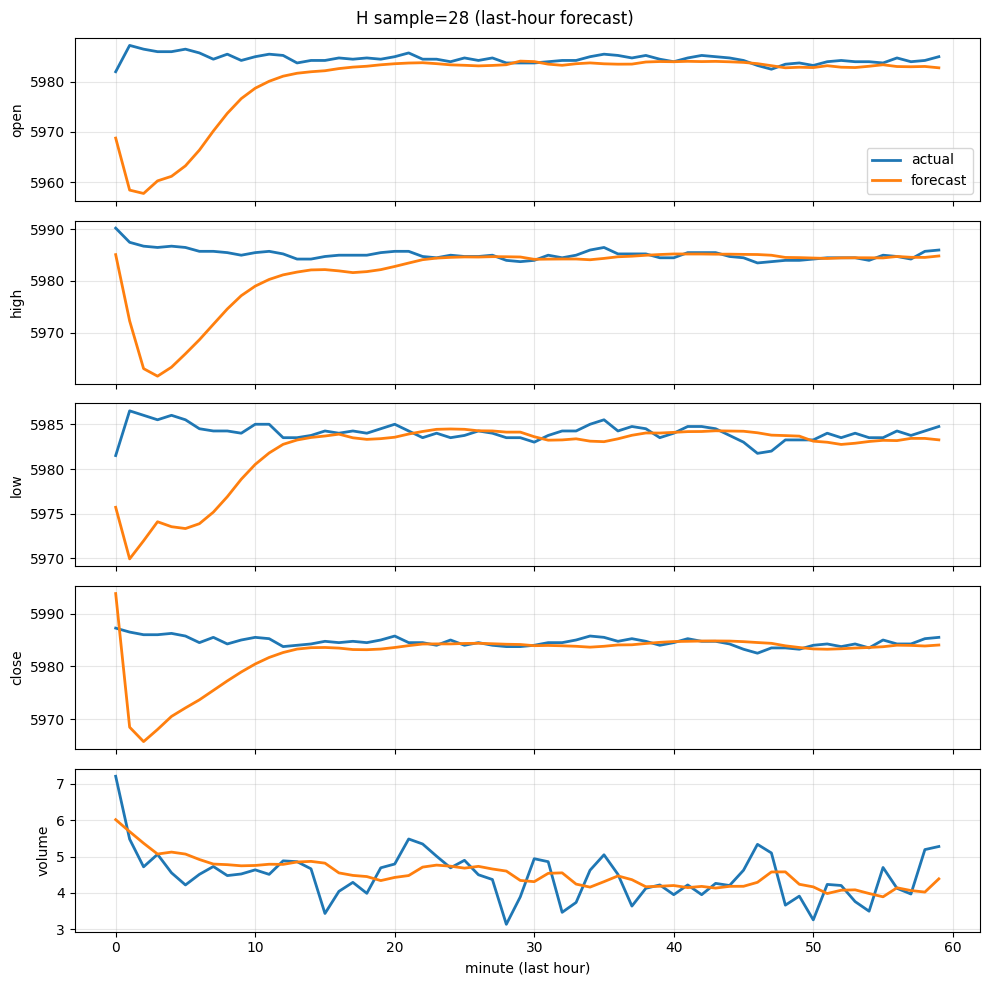

plot_saved: /content/artifacts/plot_H_test_29.png


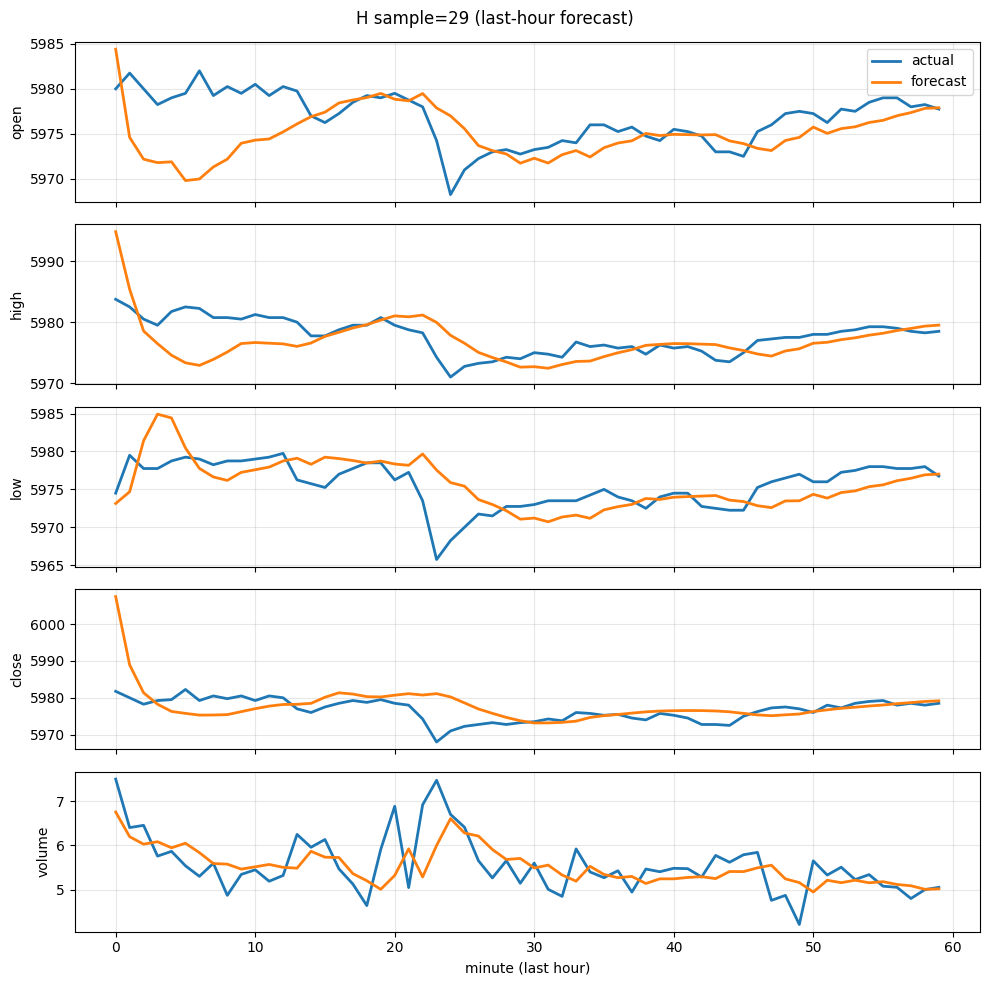

plot_saved: /content/artifacts/plot_H_test_30.png


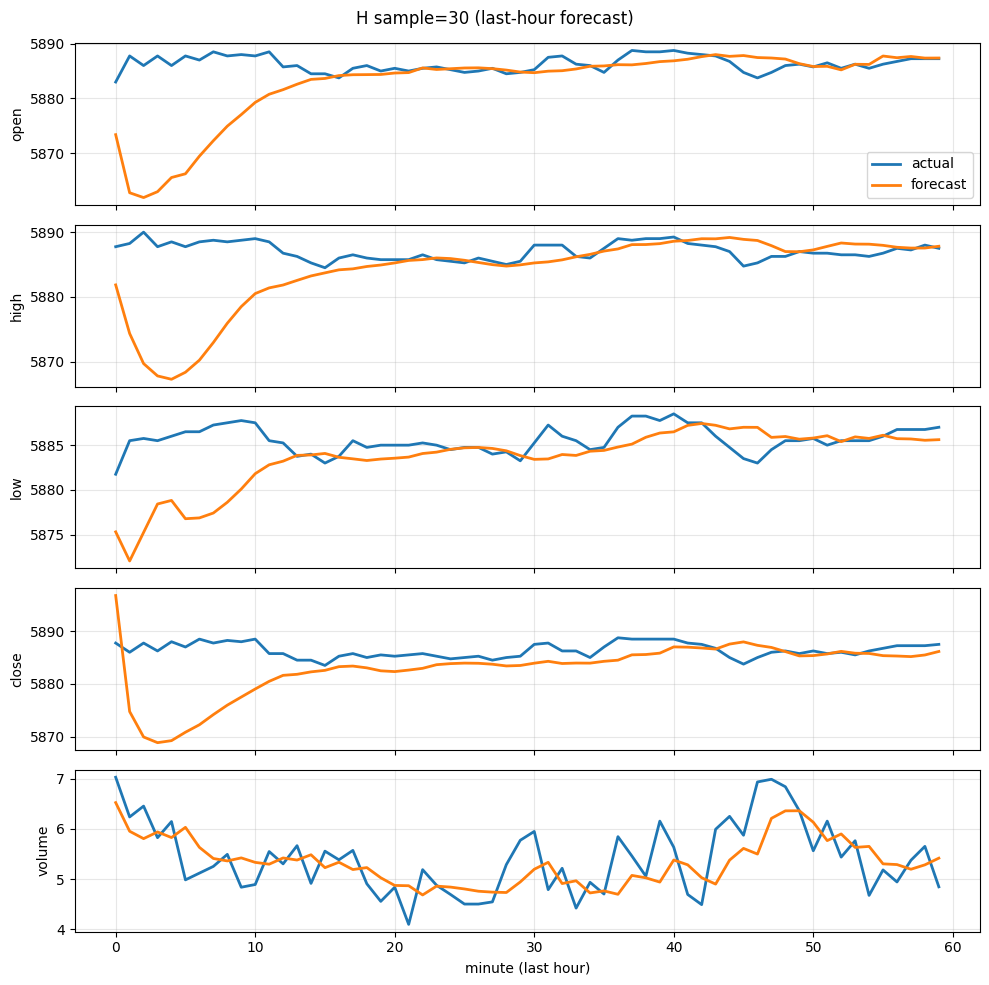

plot_saved: /content/artifacts/plot_H_test_31.png


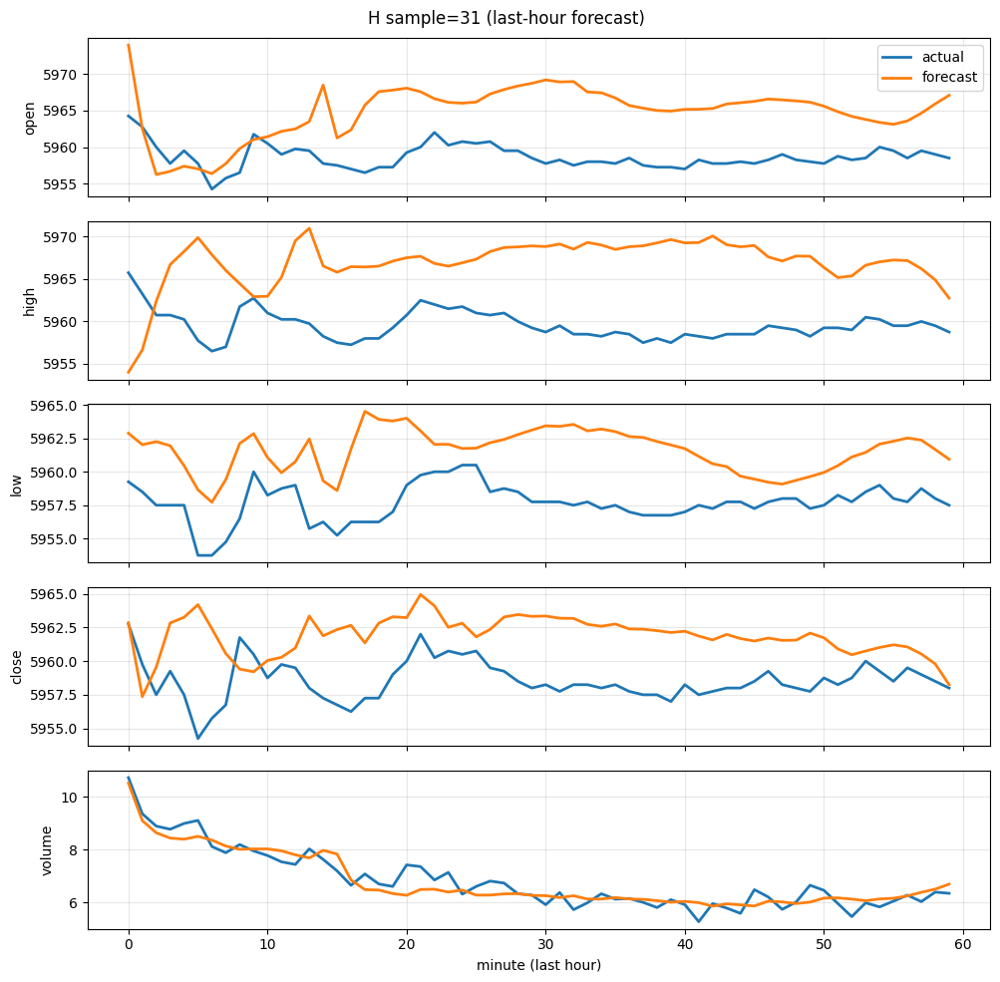

plot_saved: /content/artifacts/plot_H_test_32.png


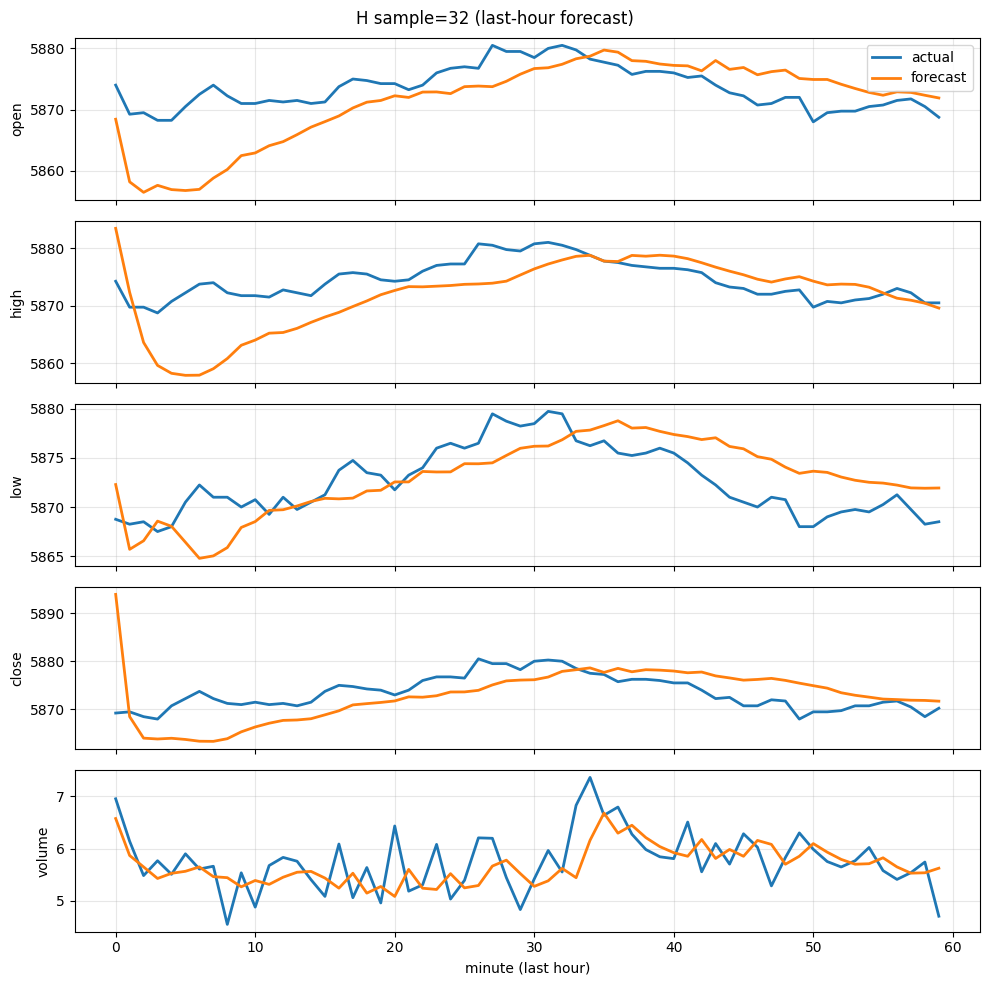

plot_saved: /content/artifacts/plot_H_test_33.png


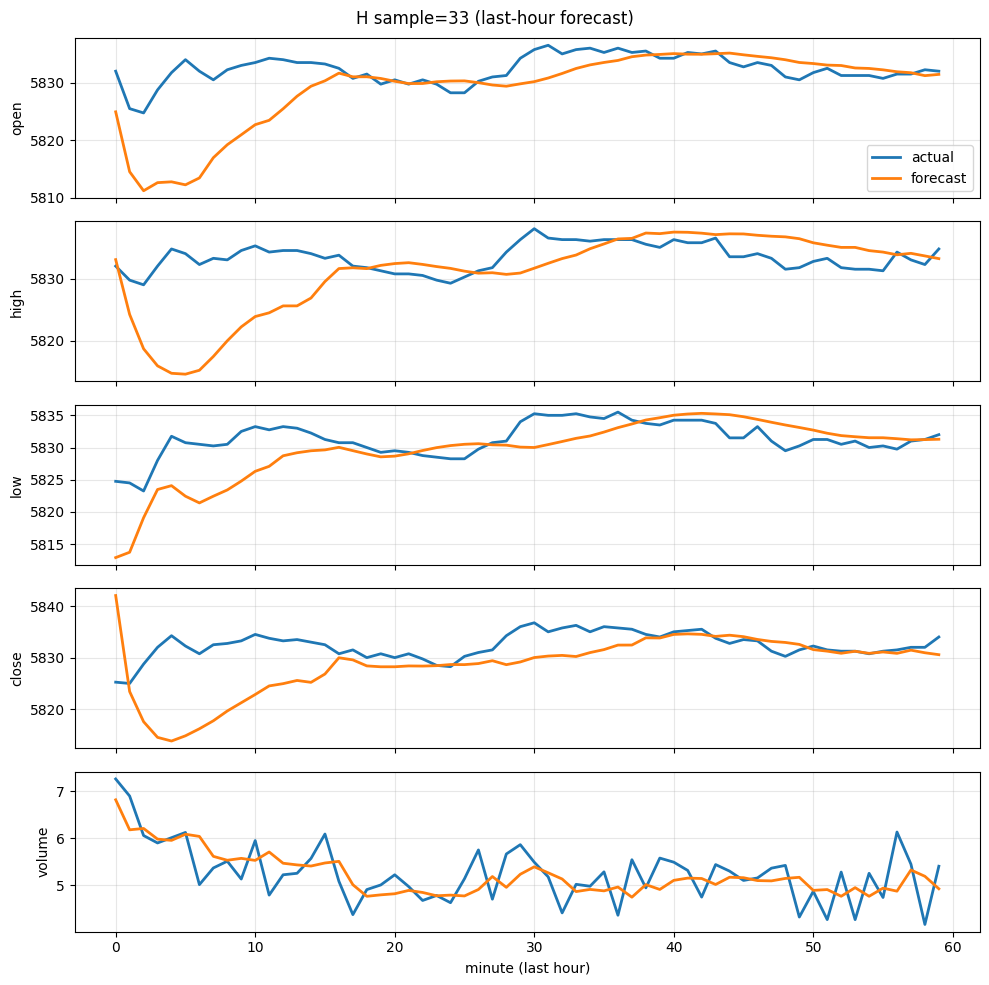

plot_saved: /content/artifacts/plot_H_test_34.png


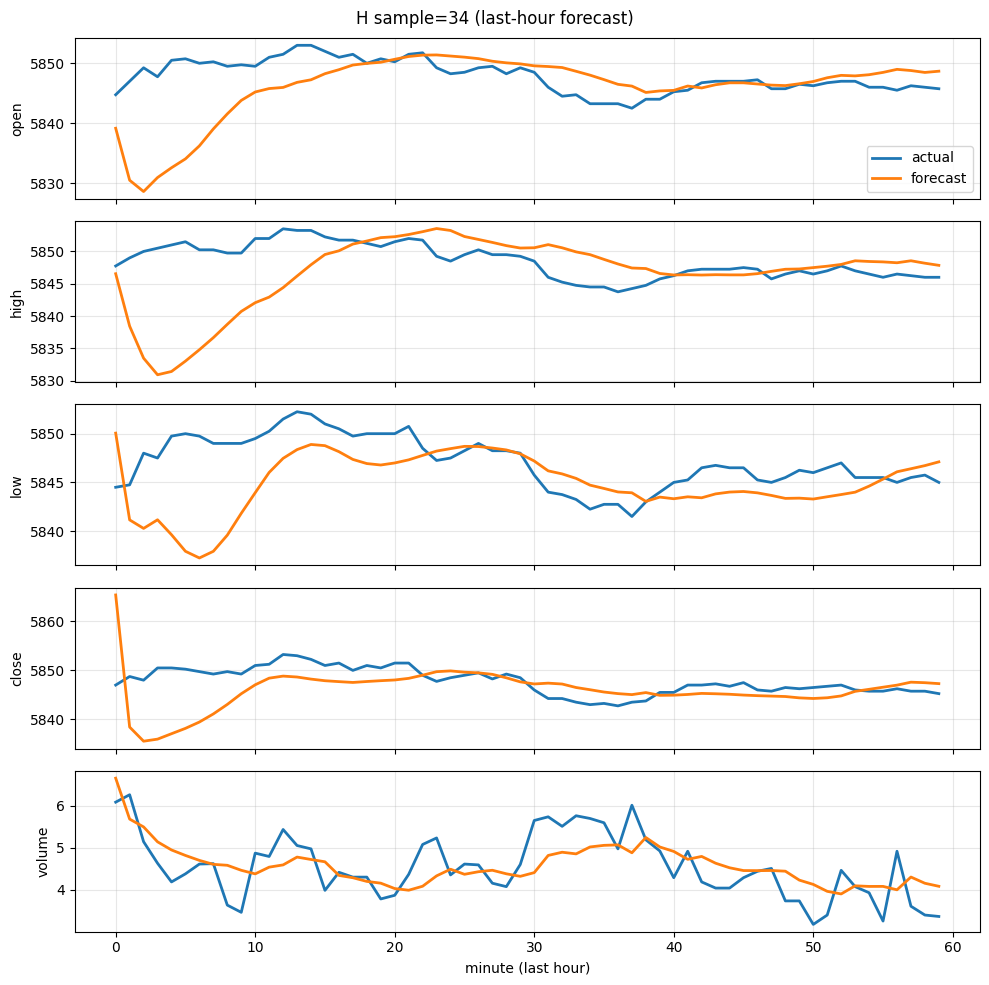

plot_saved: /content/artifacts/plot_H_test_35.png


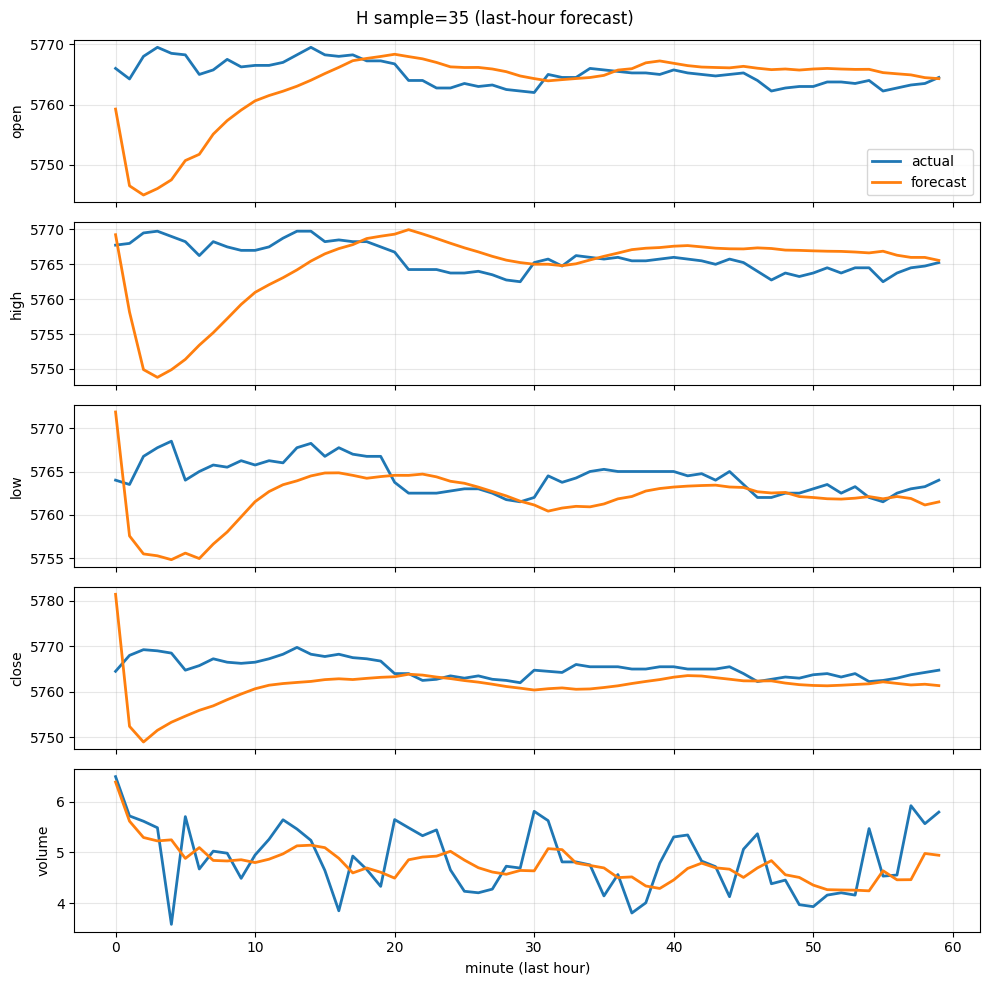

plot_saved: /content/artifacts/plot_H_test_36.png


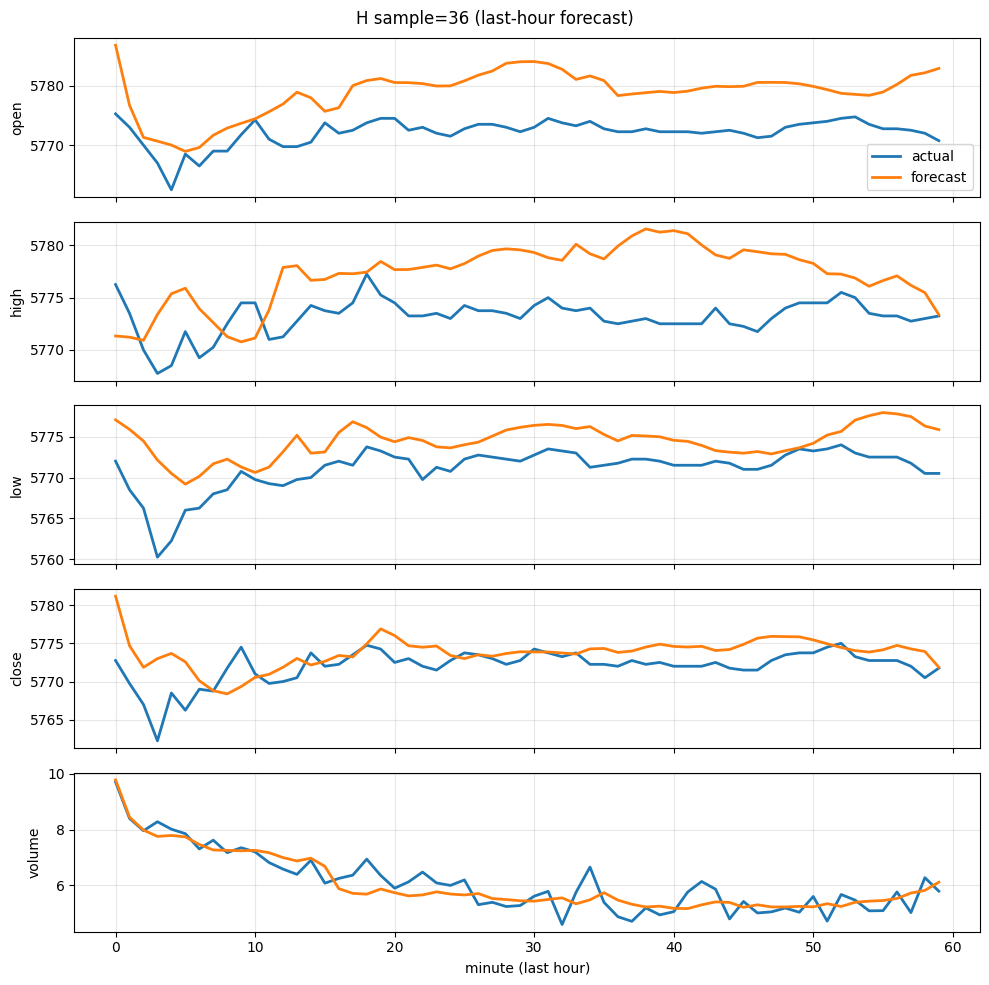

plot_saved: /content/artifacts/plot_H_test_37.png


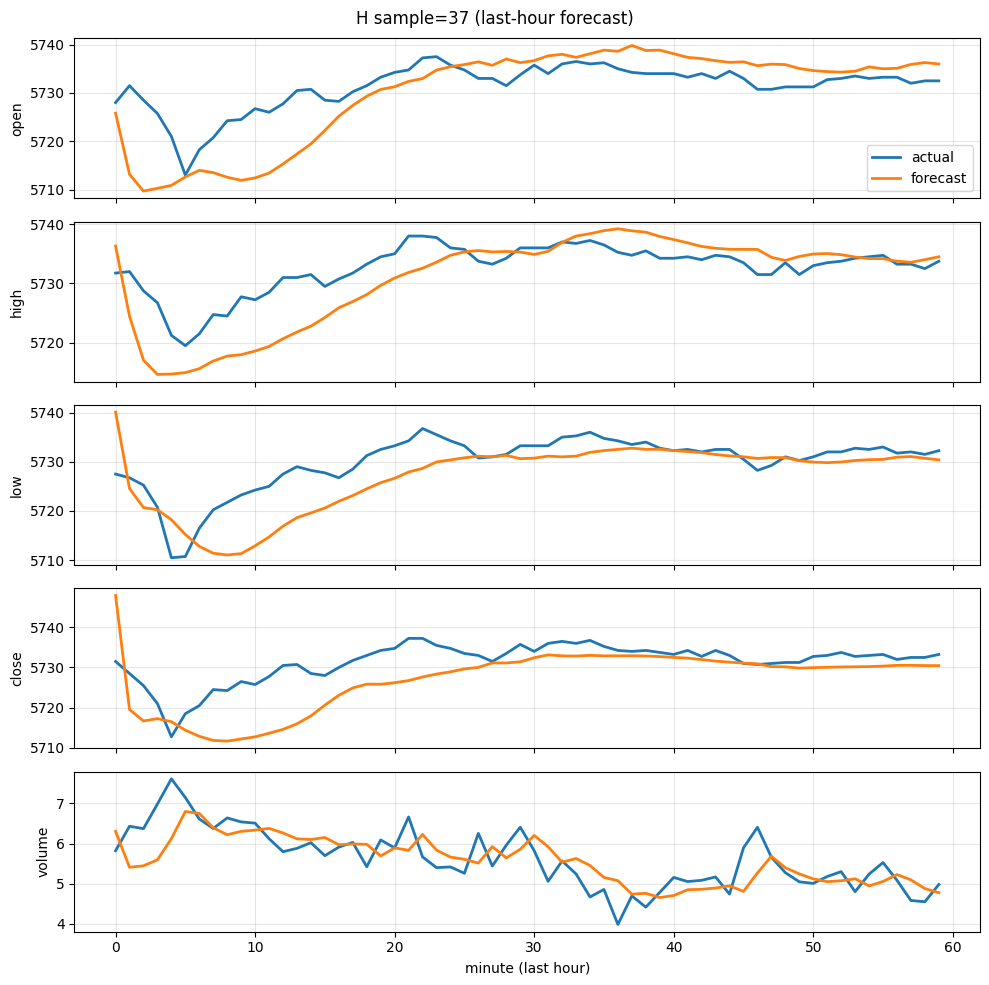

plot_saved: /content/artifacts/plot_H_test_38.png


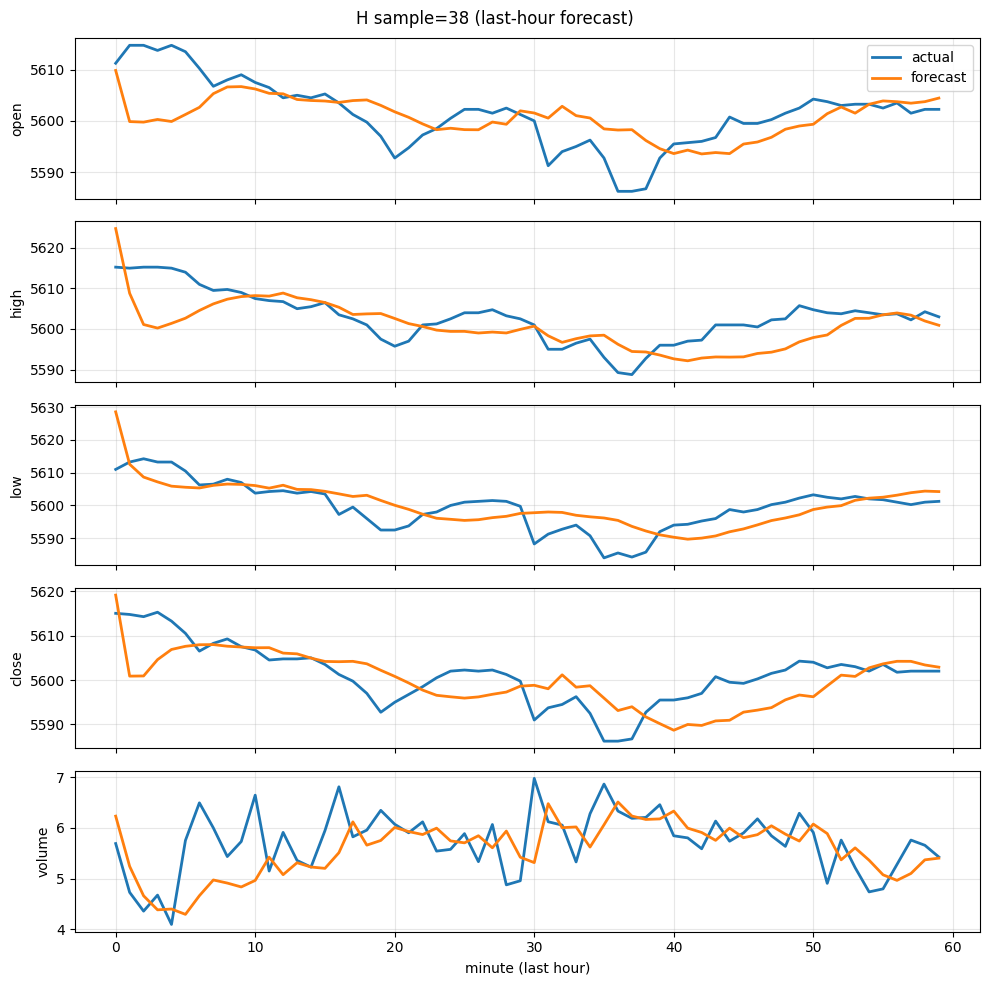

plot_saved: /content/artifacts/plot_H_test_39.png


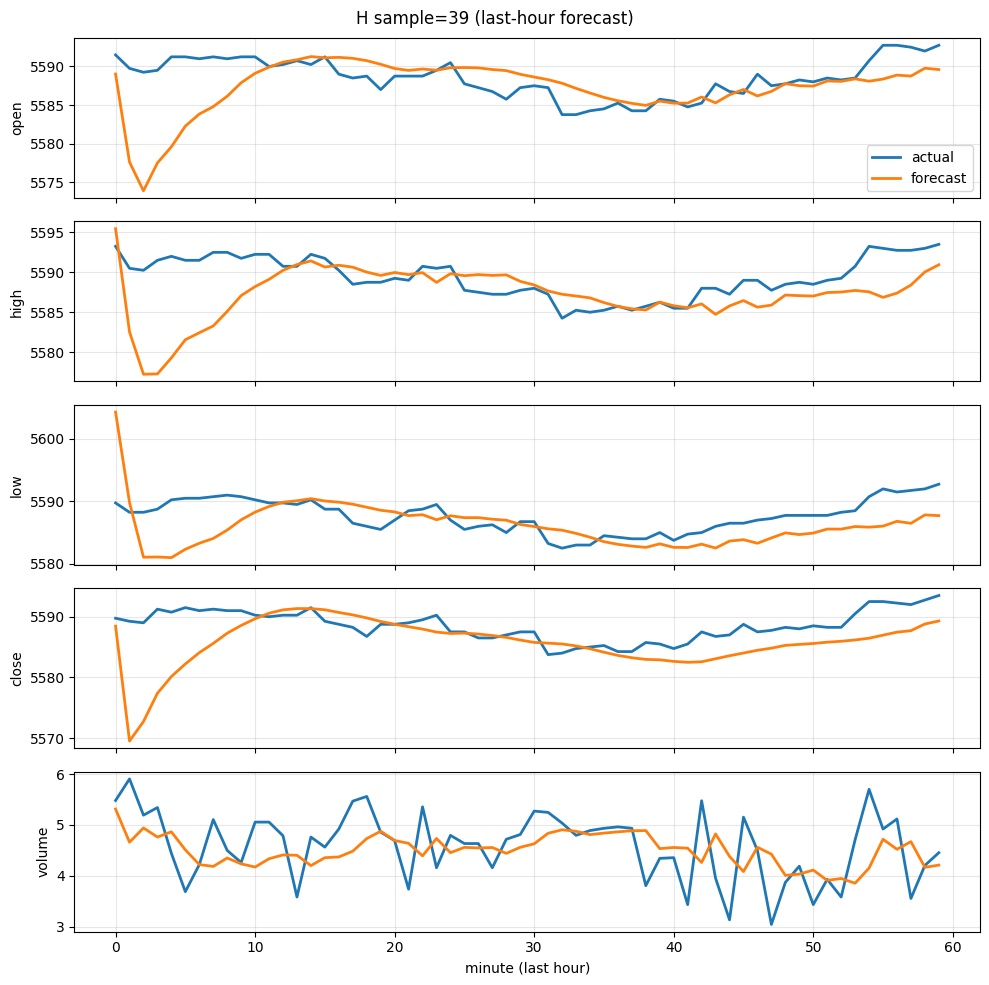

plot_saved: /content/artifacts/plot_H_test_40.png


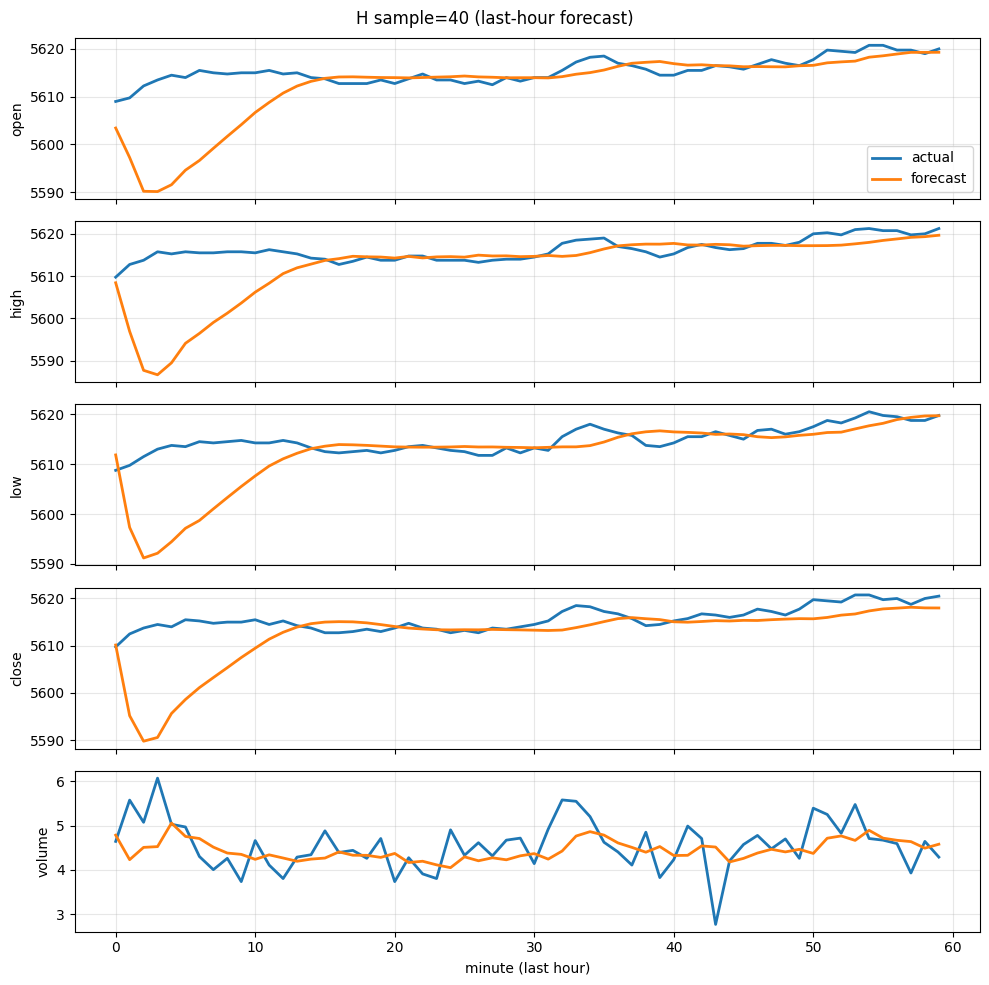

plot_saved: /content/artifacts/plot_H_test_41.png


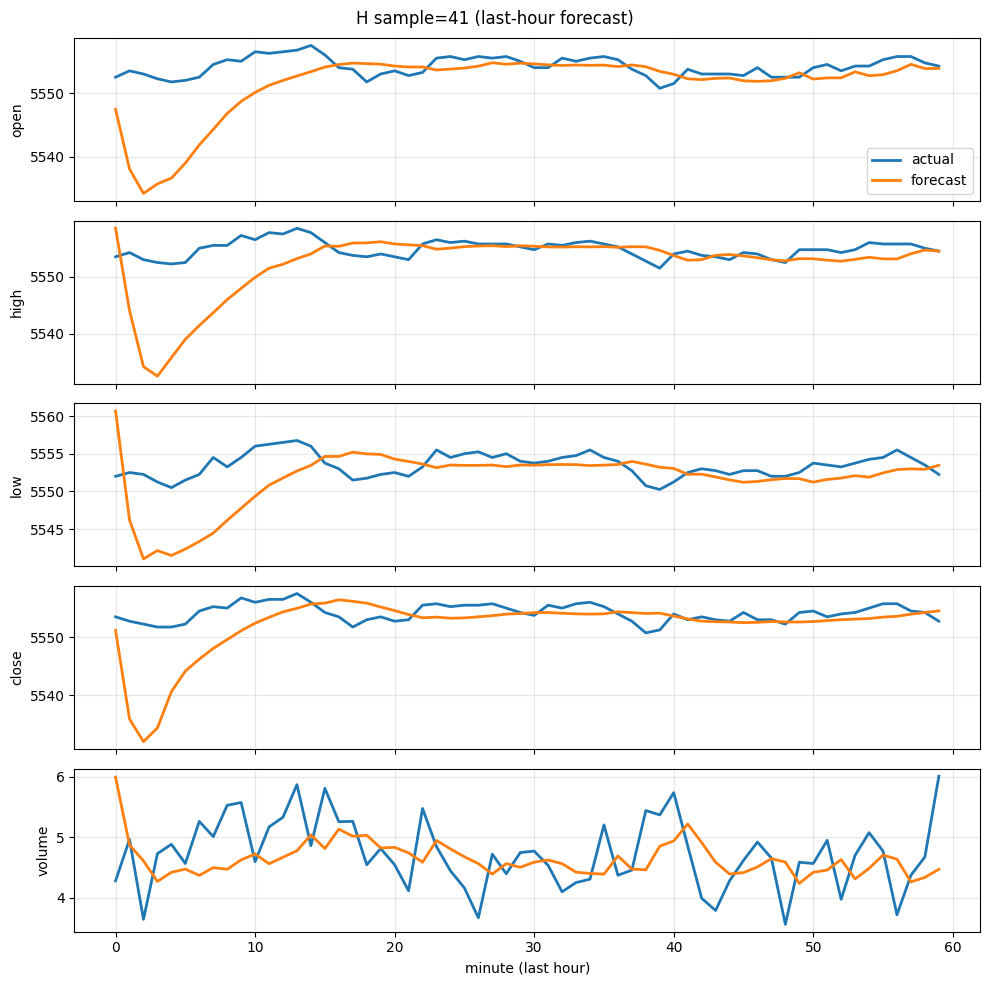

plot_saved: /content/artifacts/plot_H_test_42.png


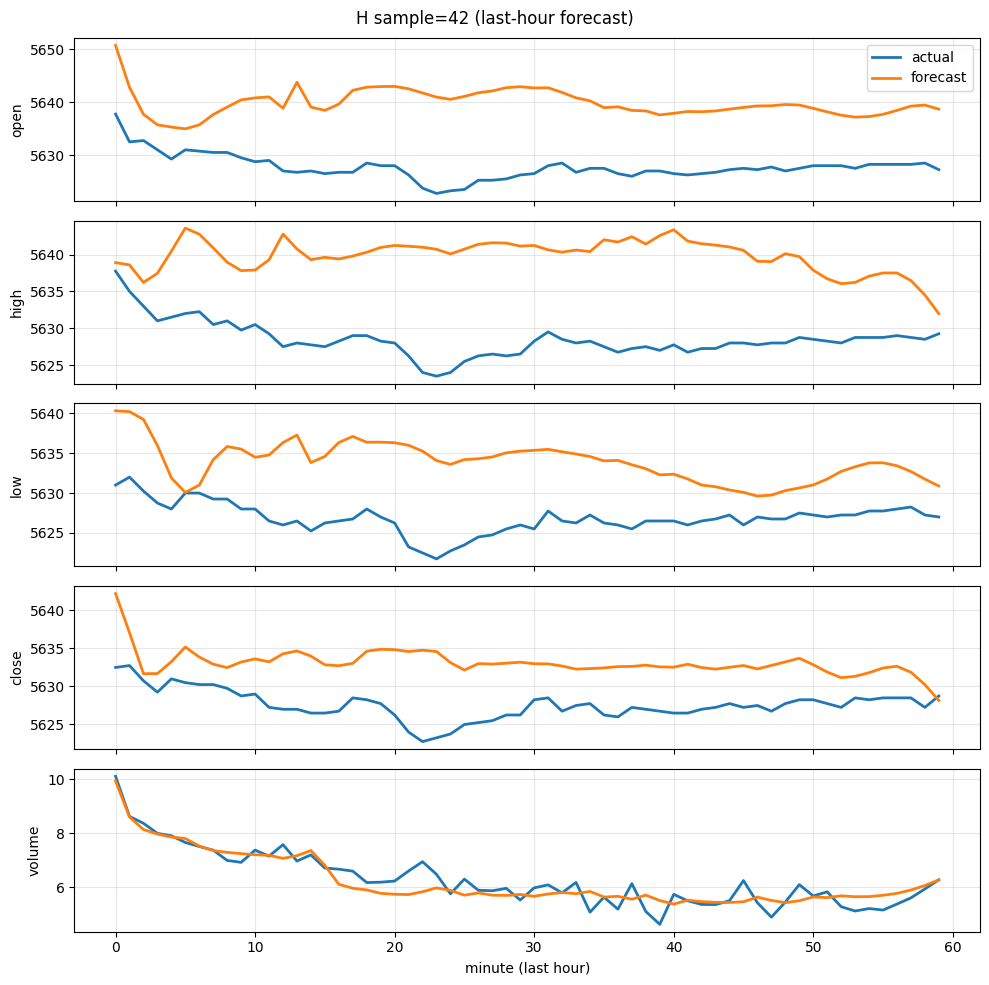

plot_saved: /content/artifacts/plot_H_test_43.png


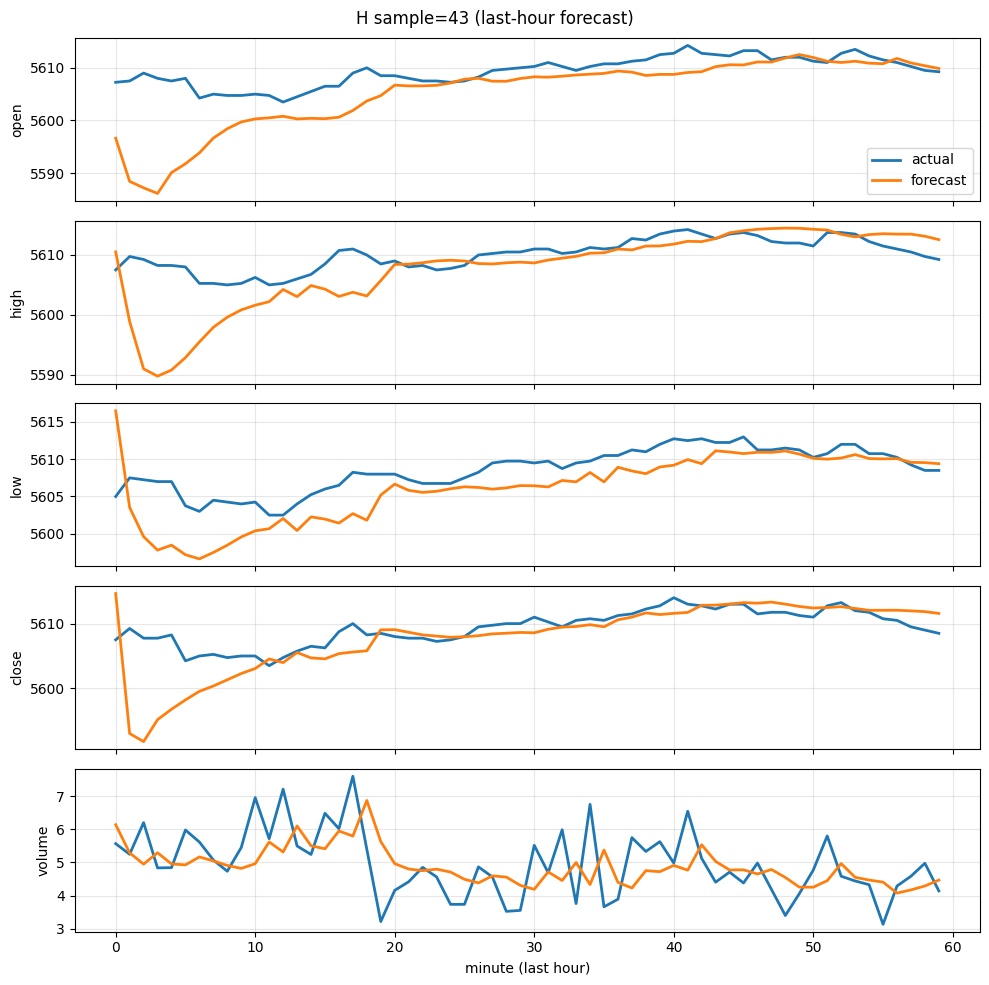

plot_saved: /content/artifacts/plot_H_test_44.png


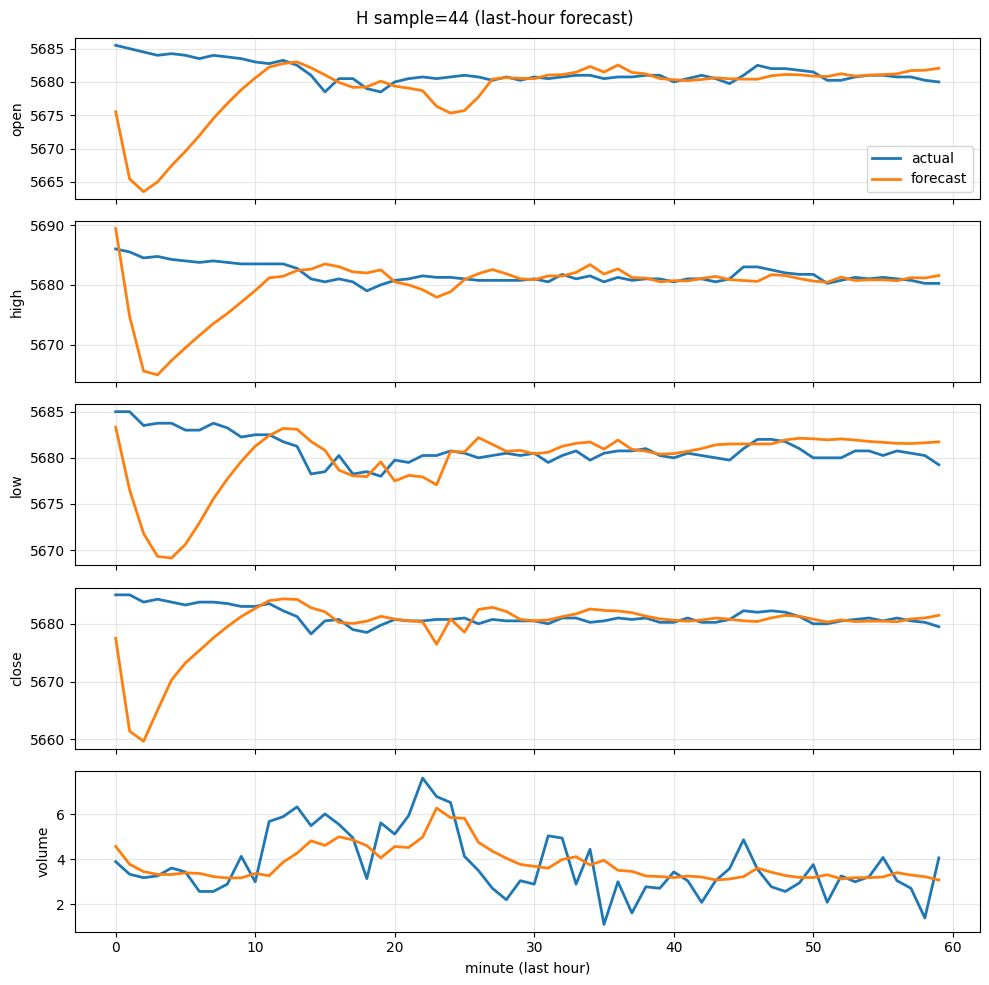

plot_saved: /content/artifacts/plot_H_test_45.png


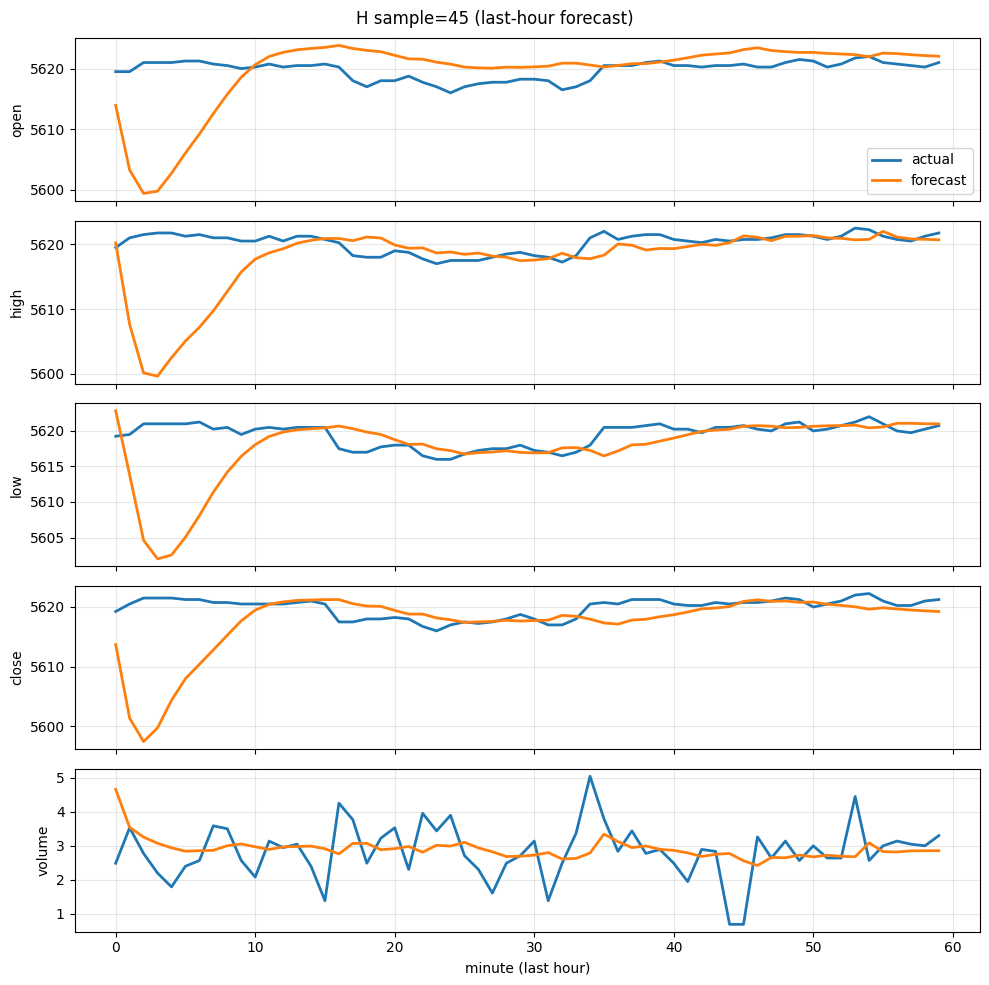

plot_saved: /content/artifacts/plot_H_test_46.png


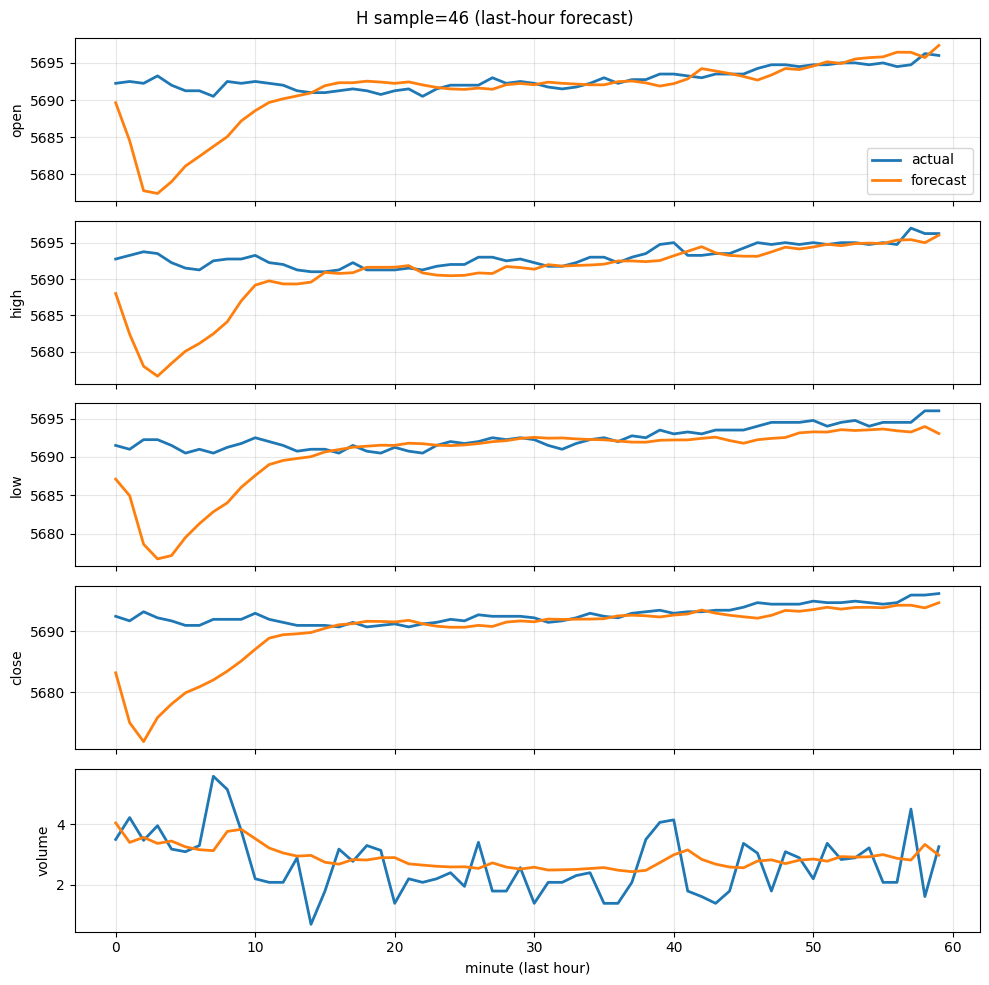

plot_saved: /content/artifacts/plot_H_test_47.png


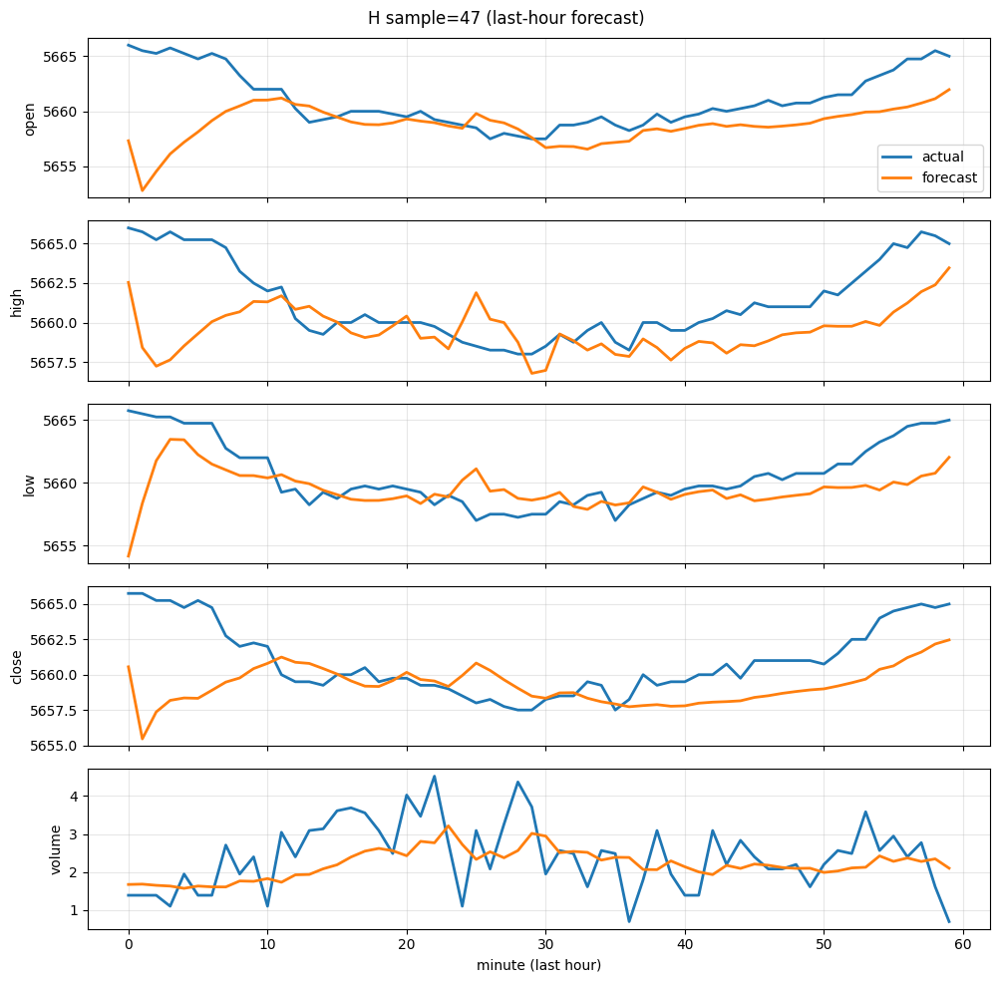

plot_saved: /content/artifacts/plot_H_test_48.png


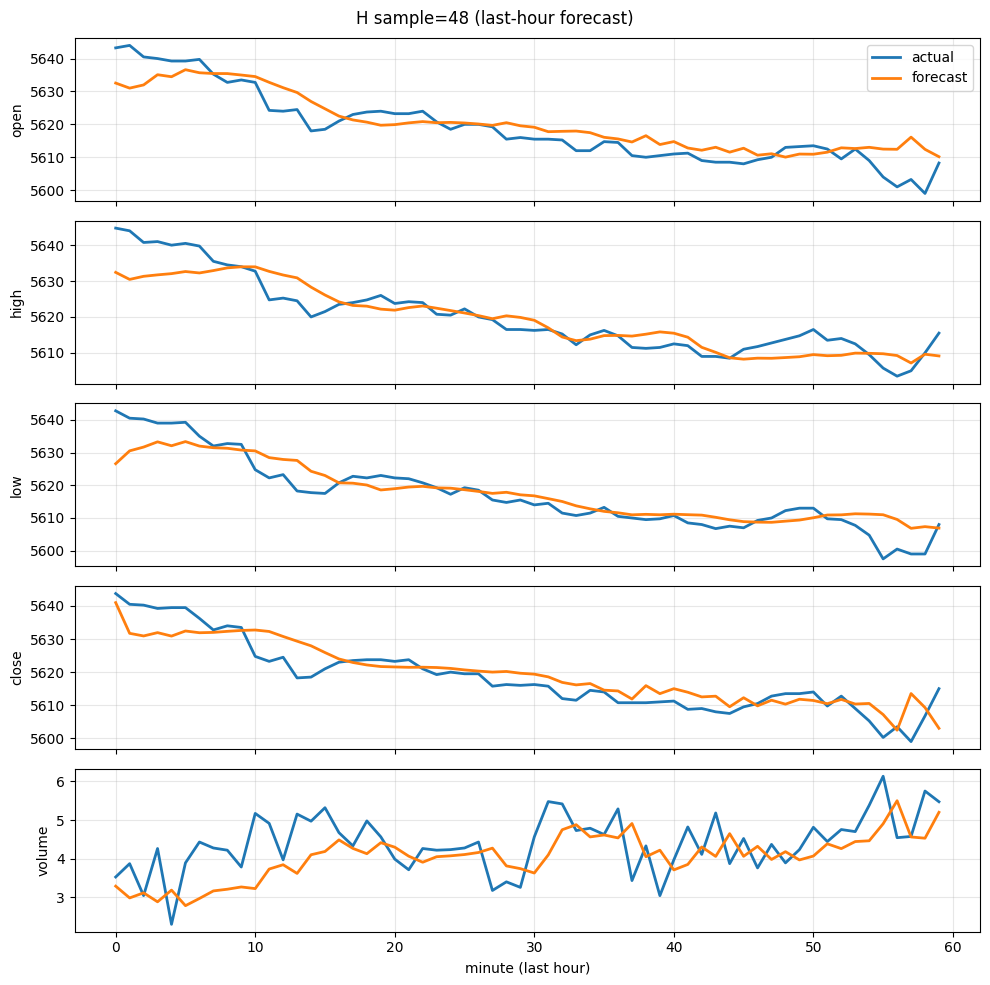

plot_saved: /content/artifacts/plot_H_test_49.png


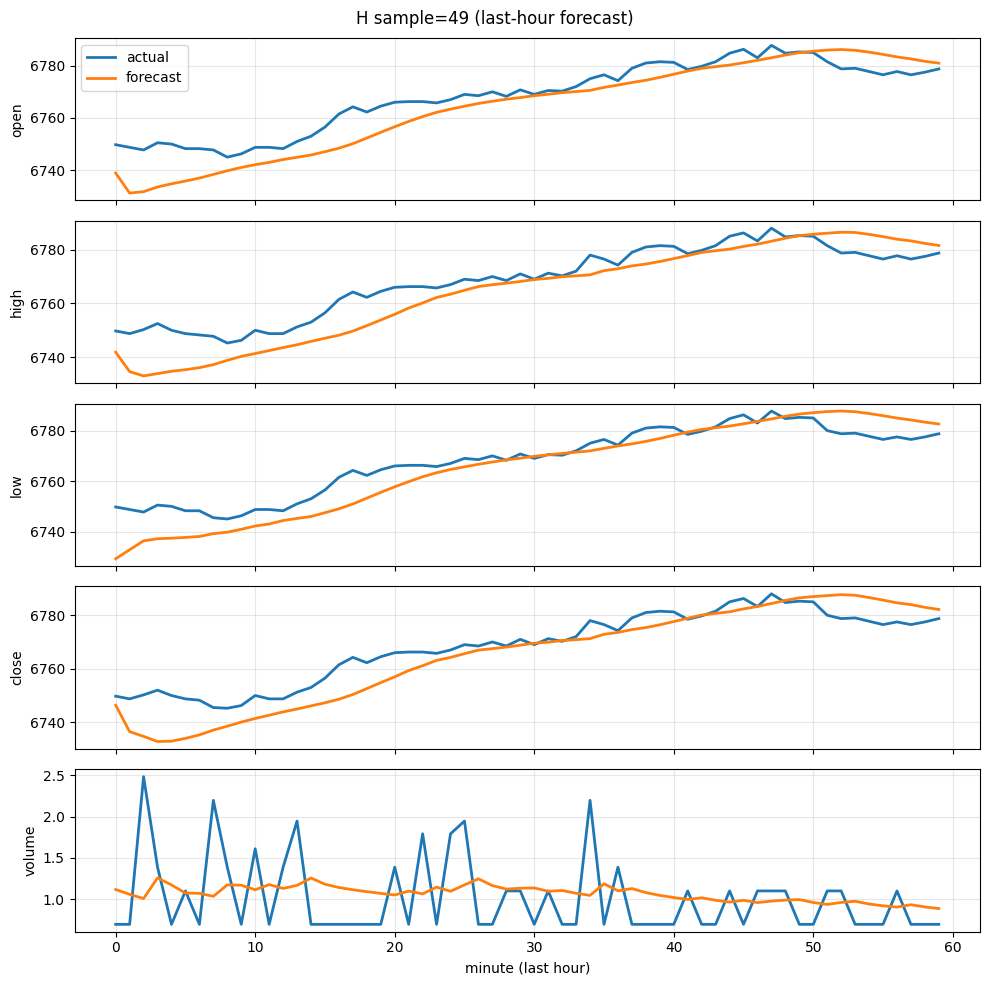

plot_saved: /content/artifacts/plot_H_test_50.png


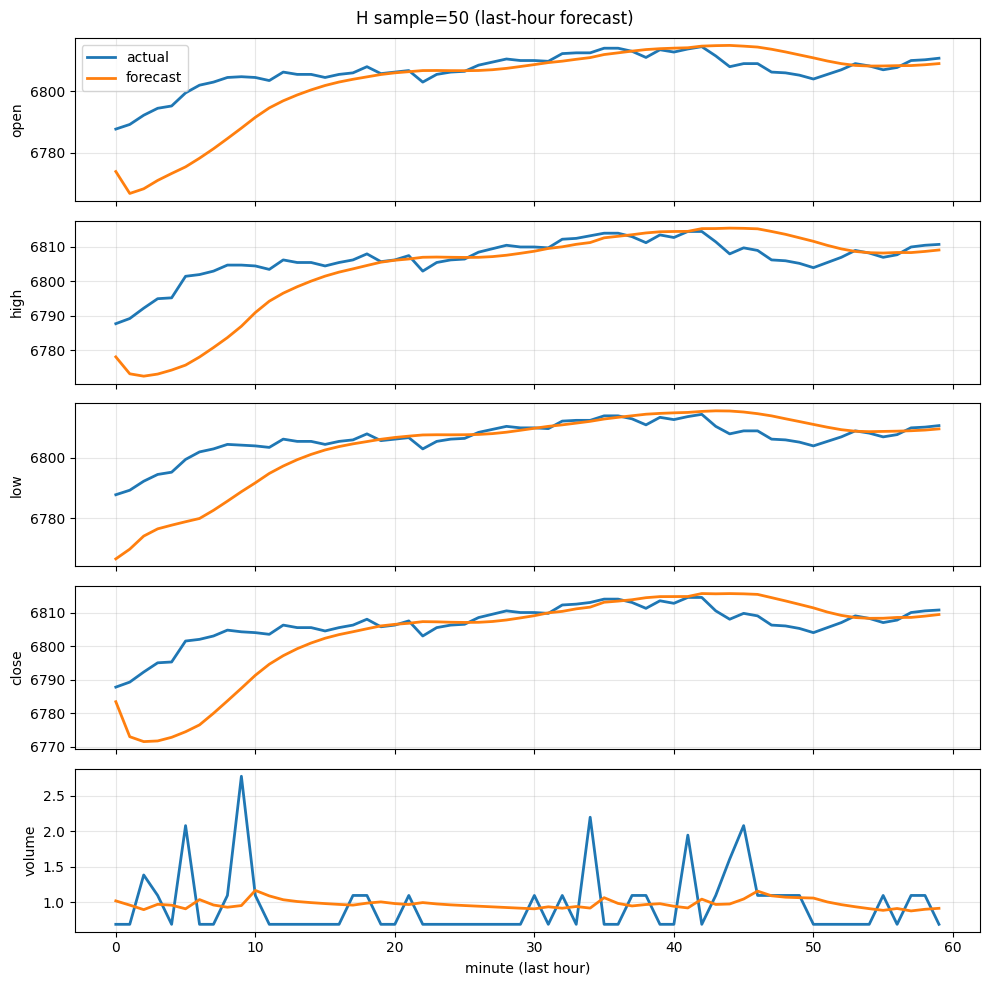

plot_saved: /content/artifacts/plot_H_test_51.png


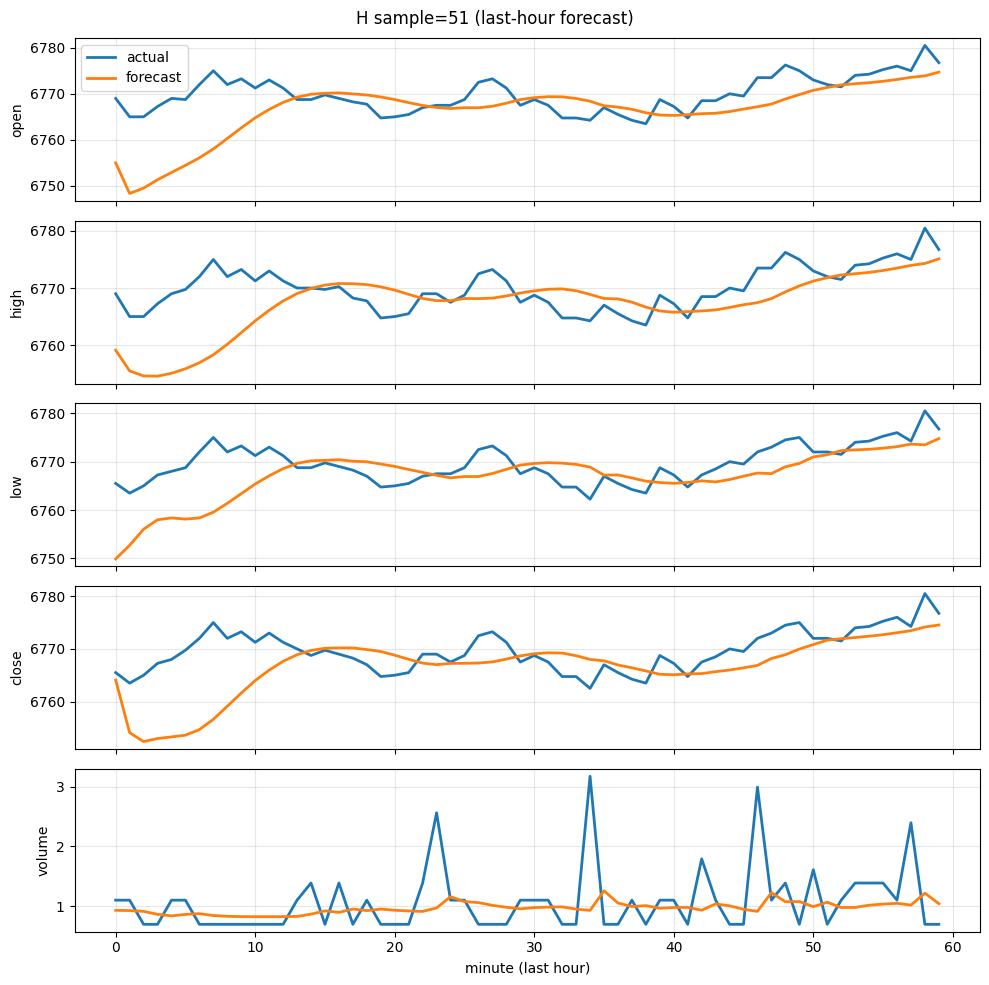

plot_saved: /content/artifacts/plot_H_test_52.png


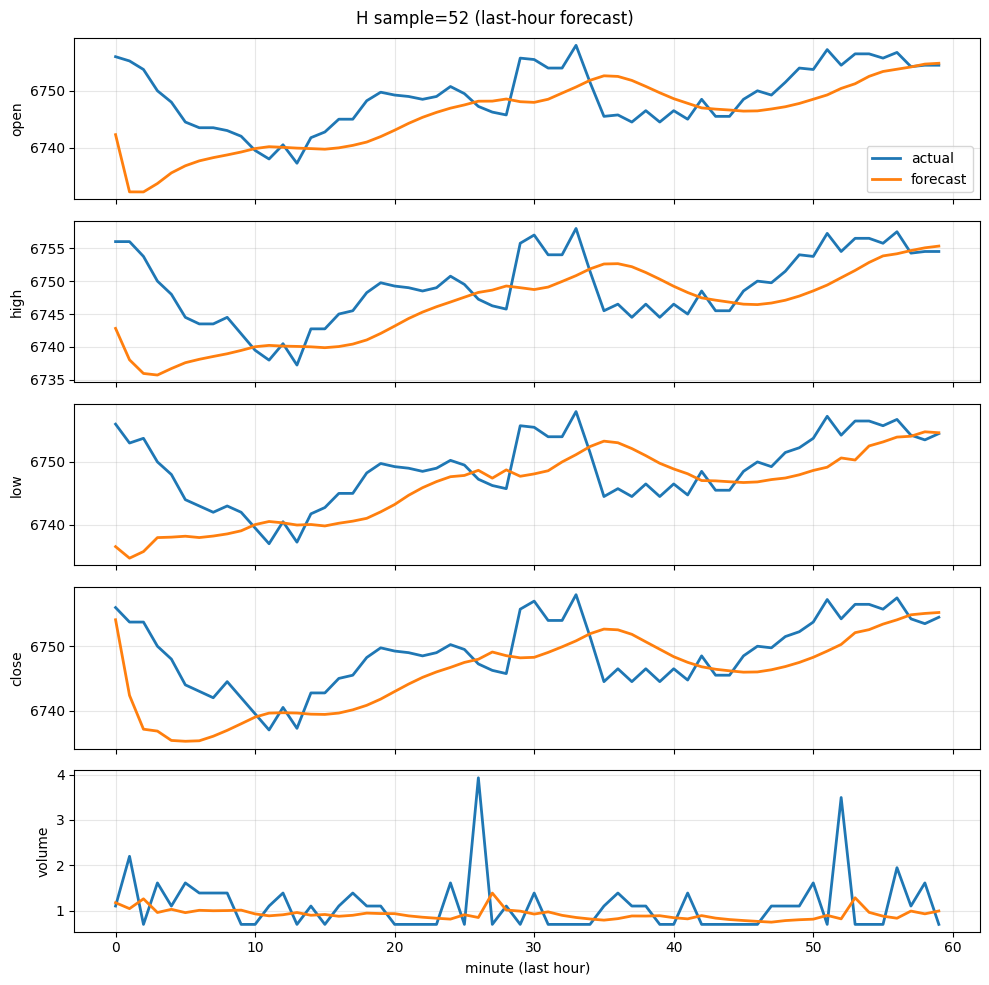

plot_saved: /content/artifacts/plot_H_test_53.png


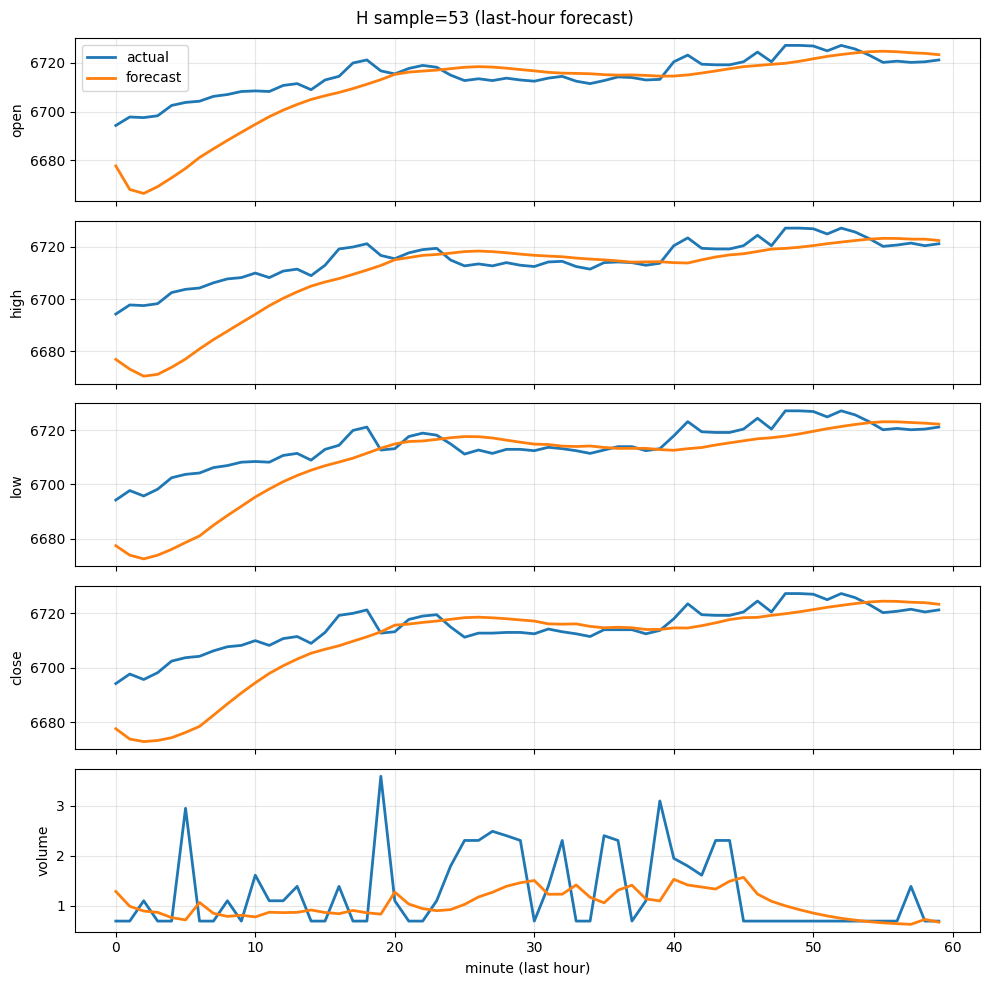

plot_saved: /content/artifacts/plot_H_test_54.png


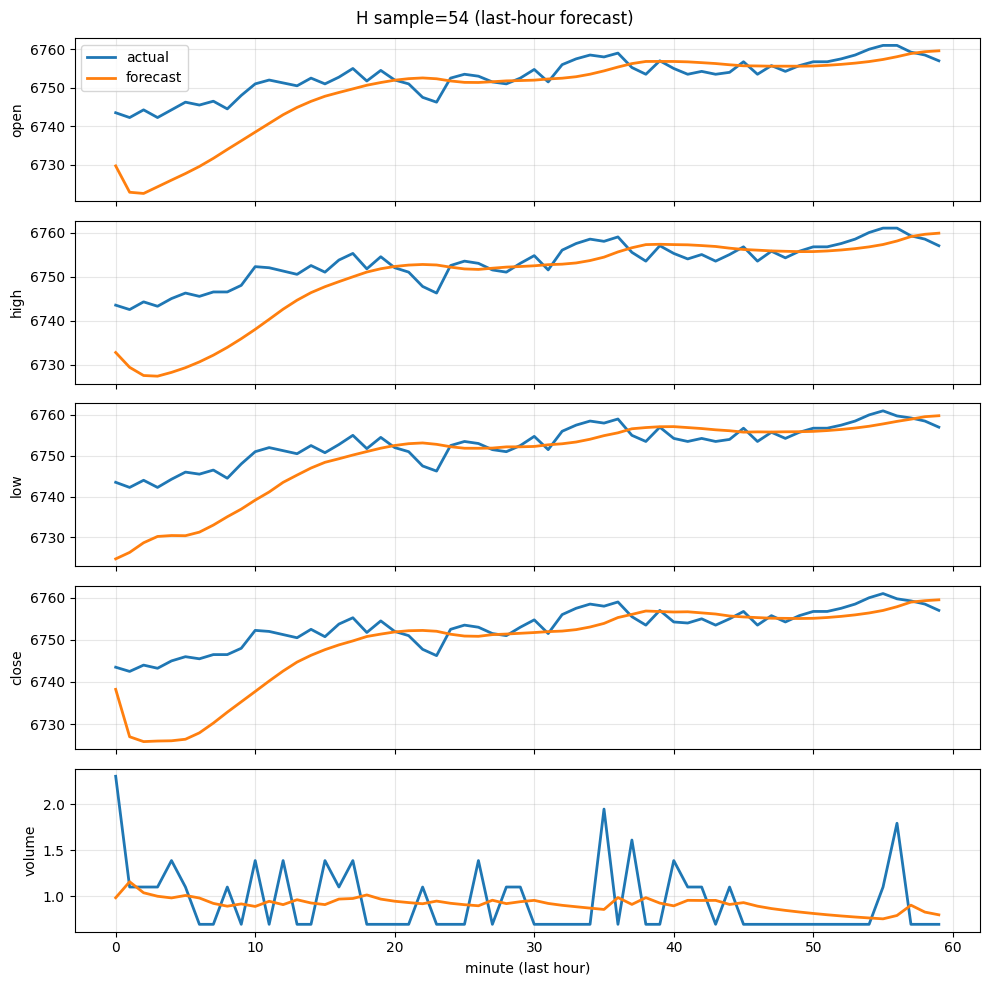

plot_saved: /content/artifacts/plot_H_test_55.png


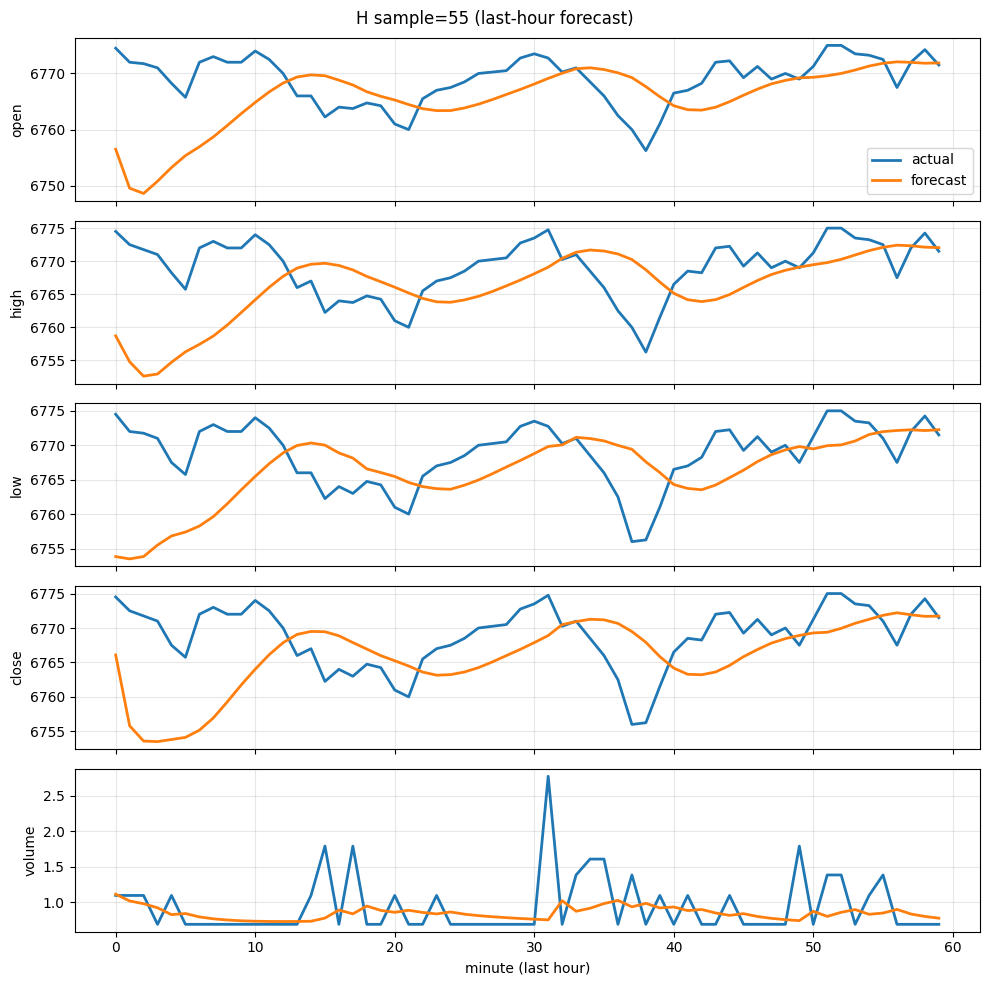

plot_saved: /content/artifacts/plot_H_test_56.png


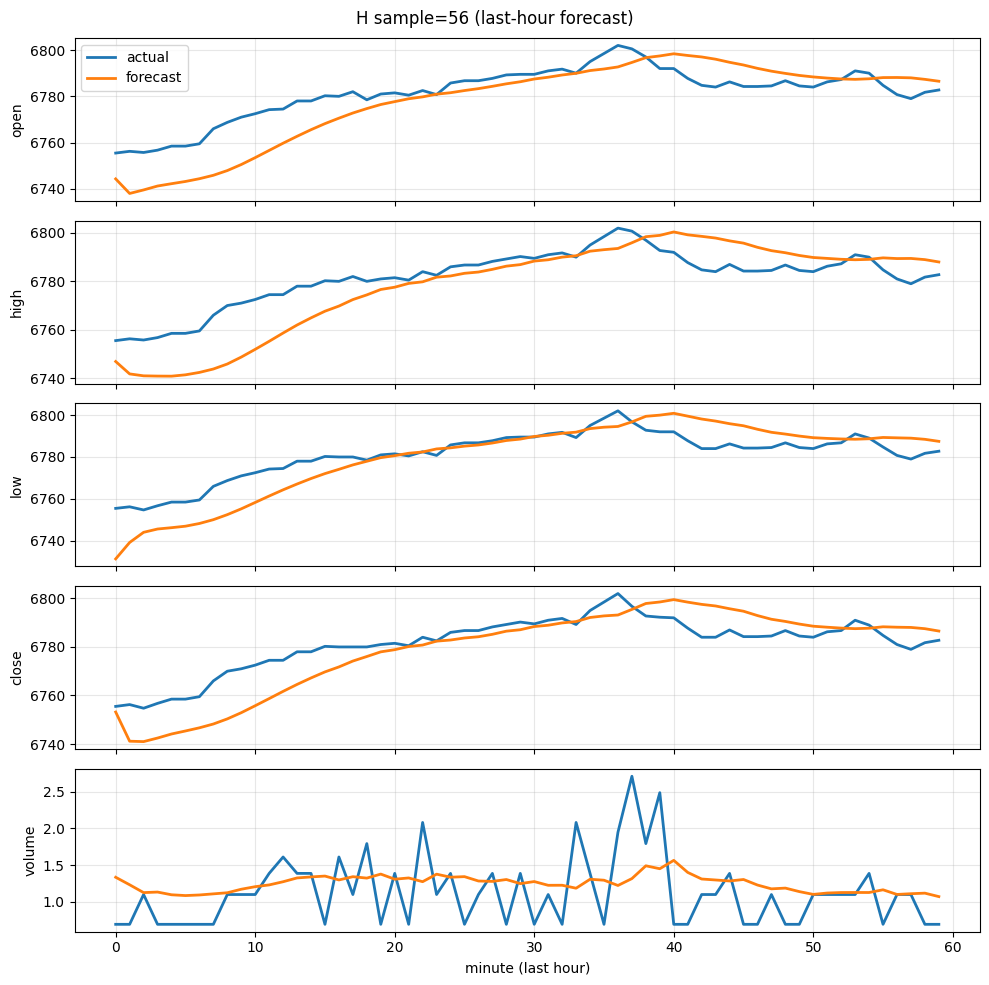

plot_saved: /content/artifacts/plot_H_test_57.png


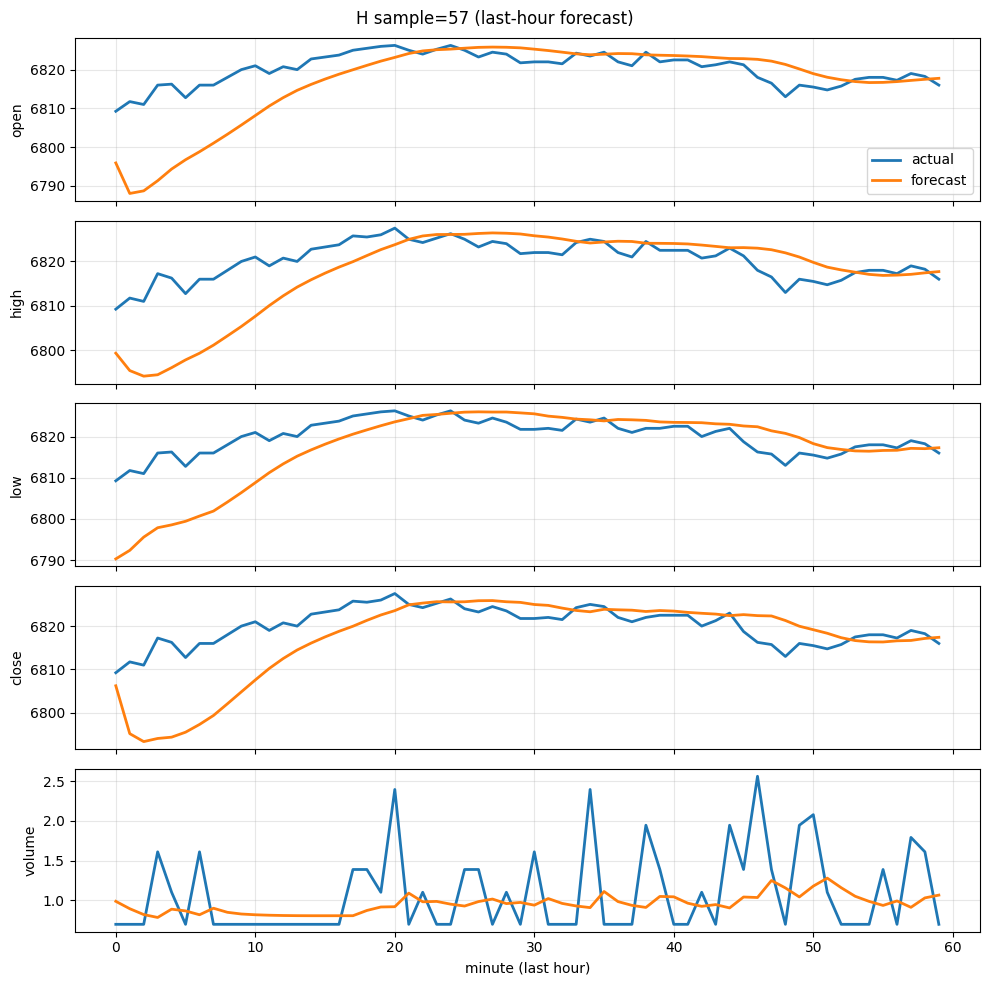

plot_saved: /content/artifacts/plot_H_test_58.png


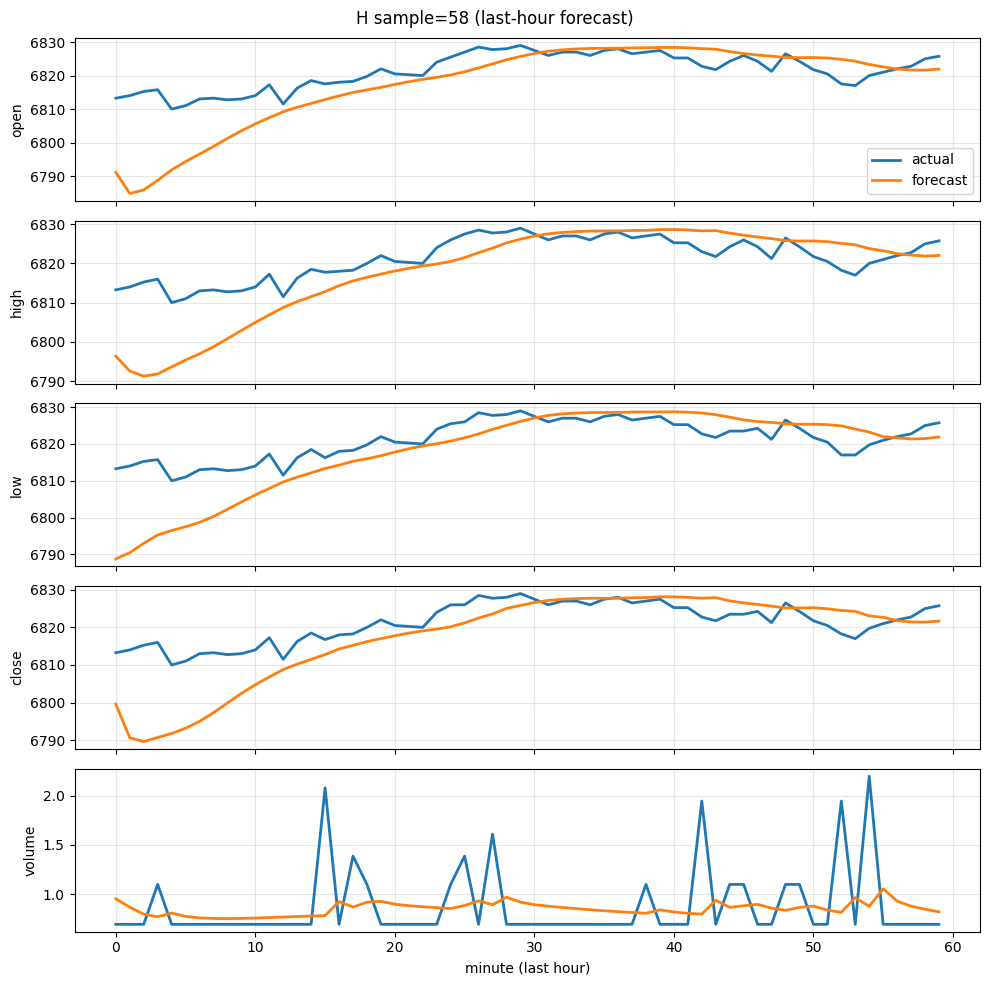

plot_saved: /content/artifacts/plot_H_test_59.png


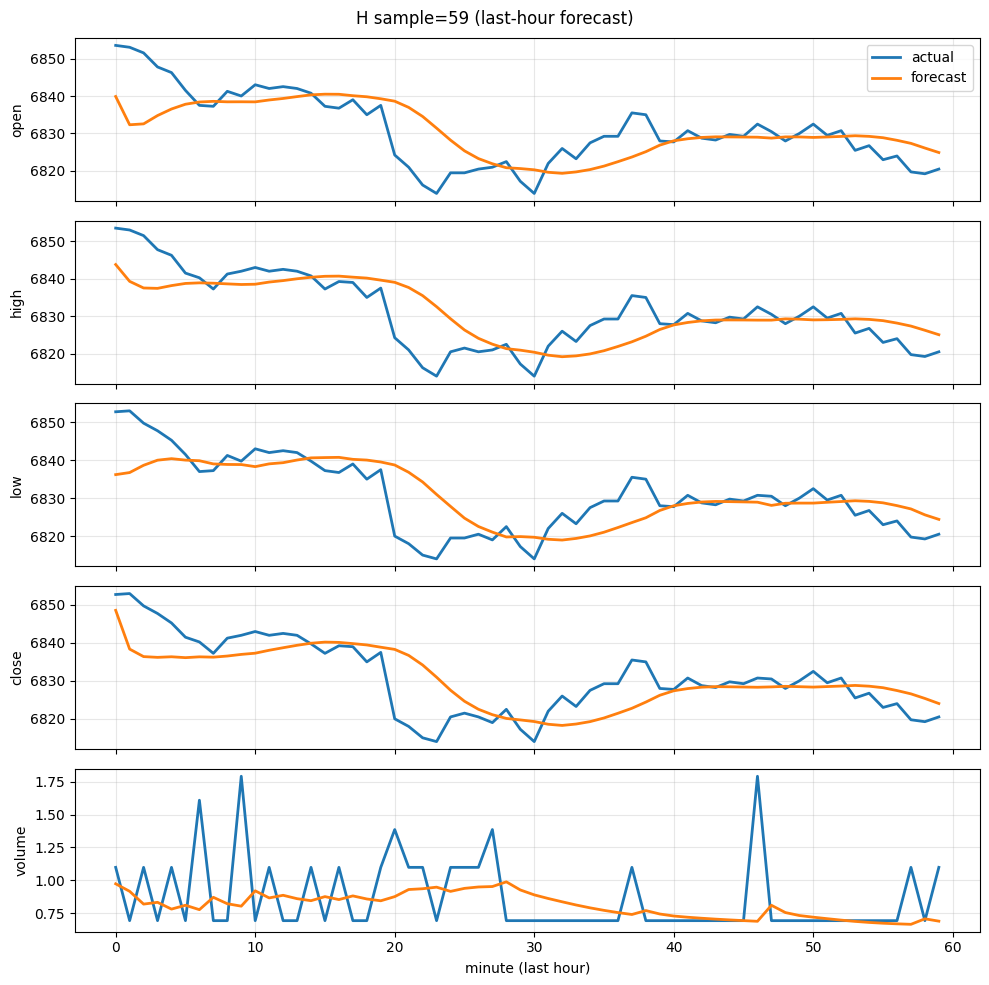

plot_saved: /content/artifacts/plot_H_test_60.png


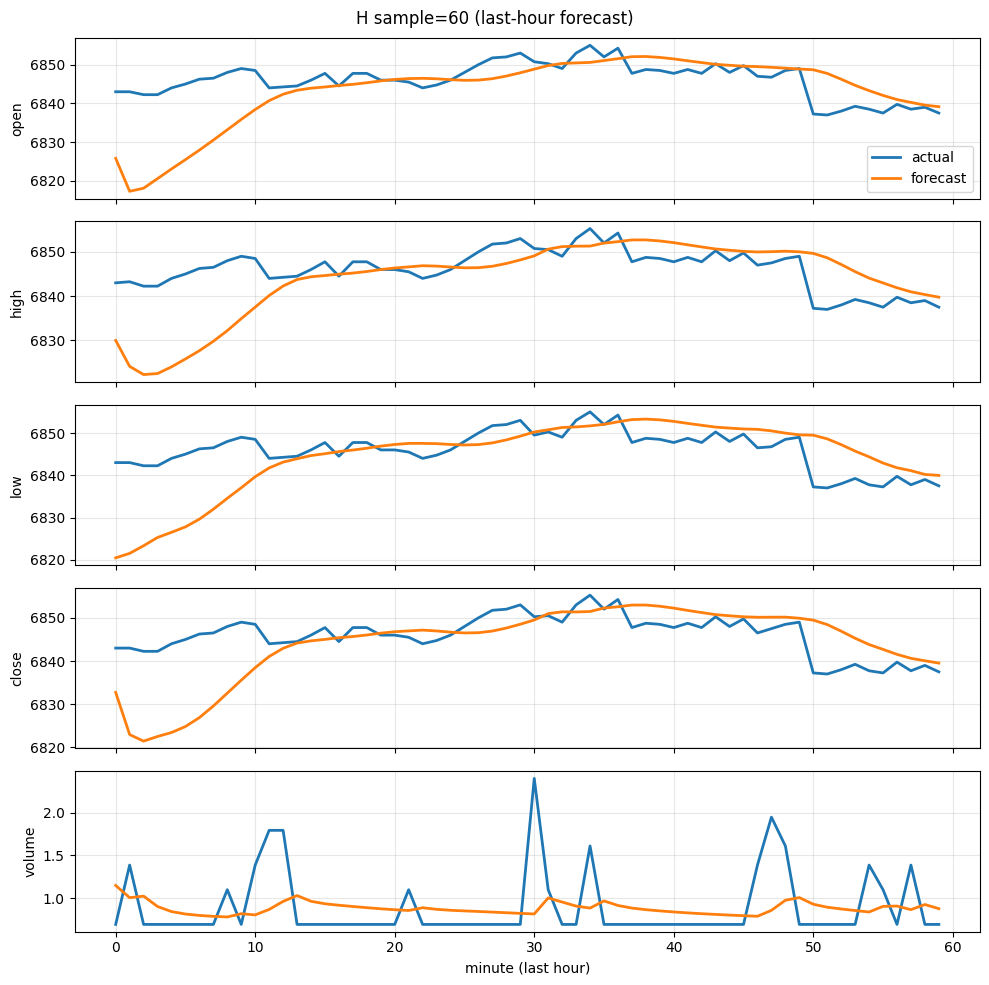

plot_saved: /content/artifacts/plot_H_test_61.png


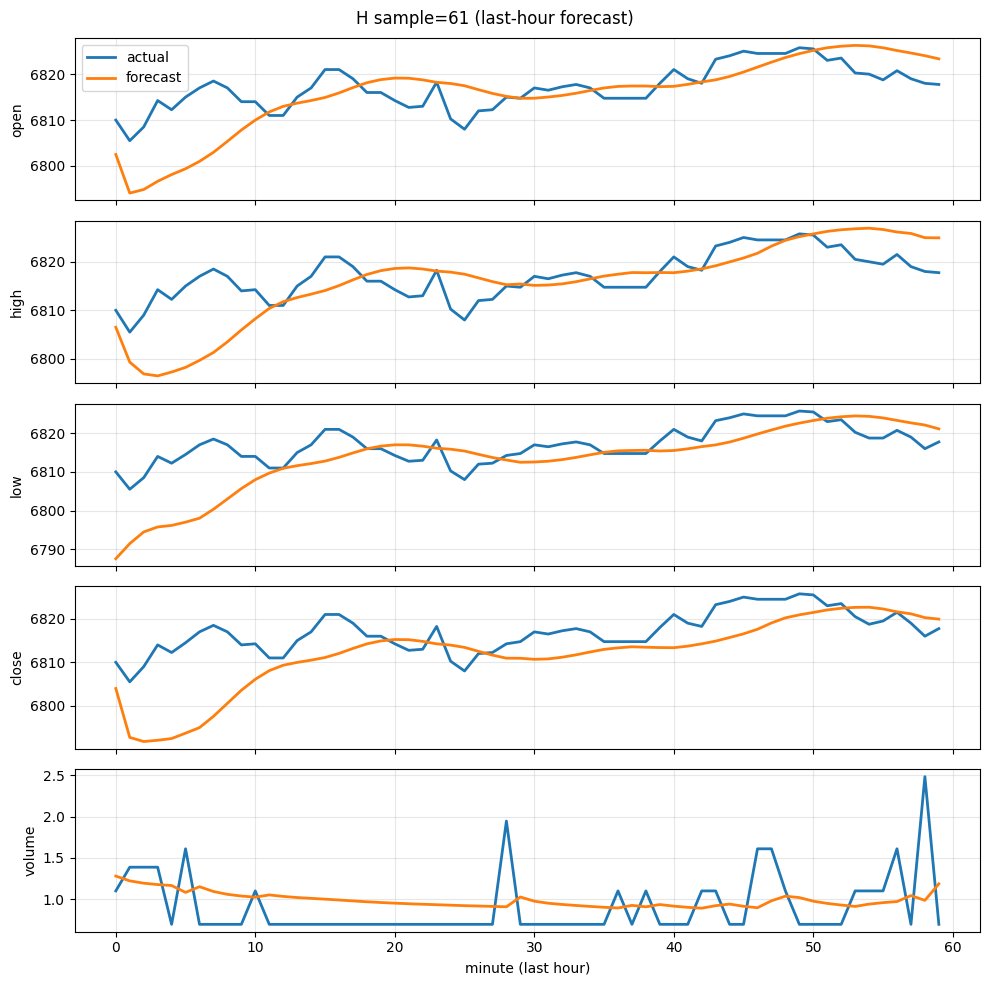

plot_saved: /content/artifacts/plot_H_test_62.png


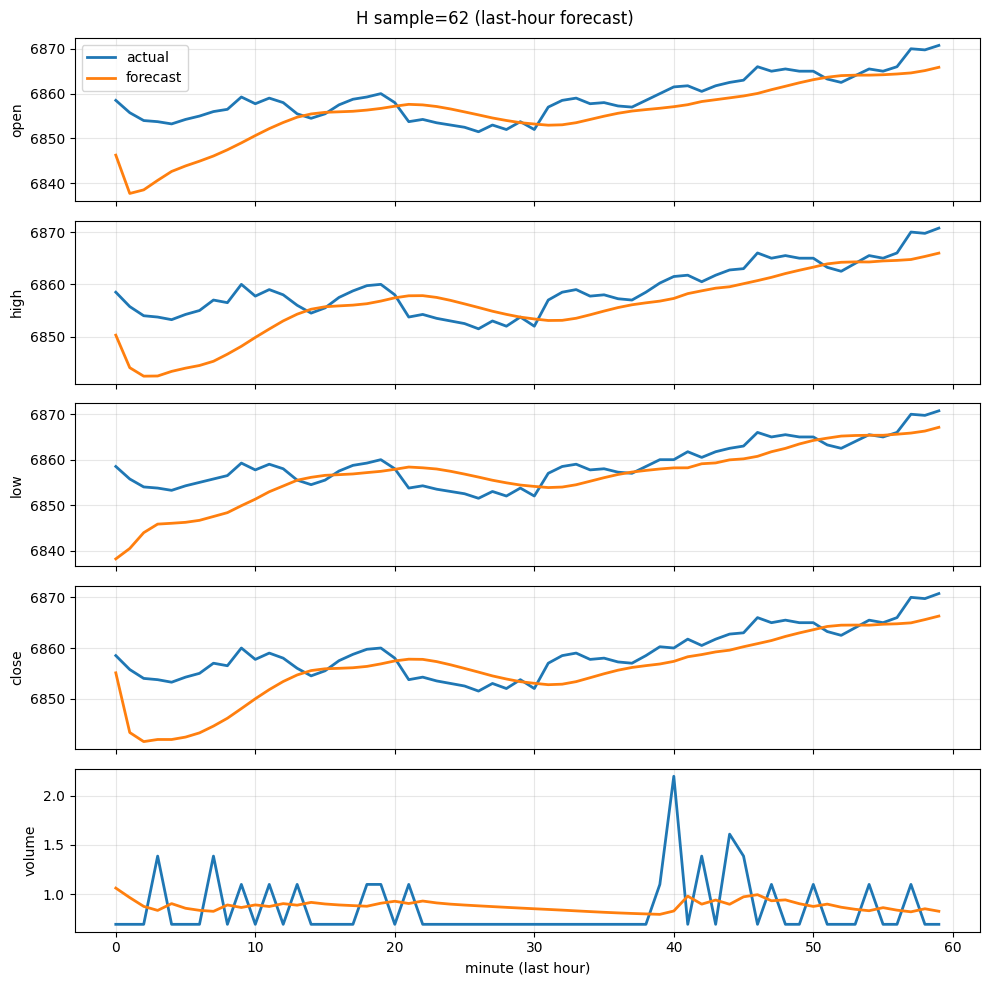

plot_saved: /content/artifacts/plot_H_test_63.png


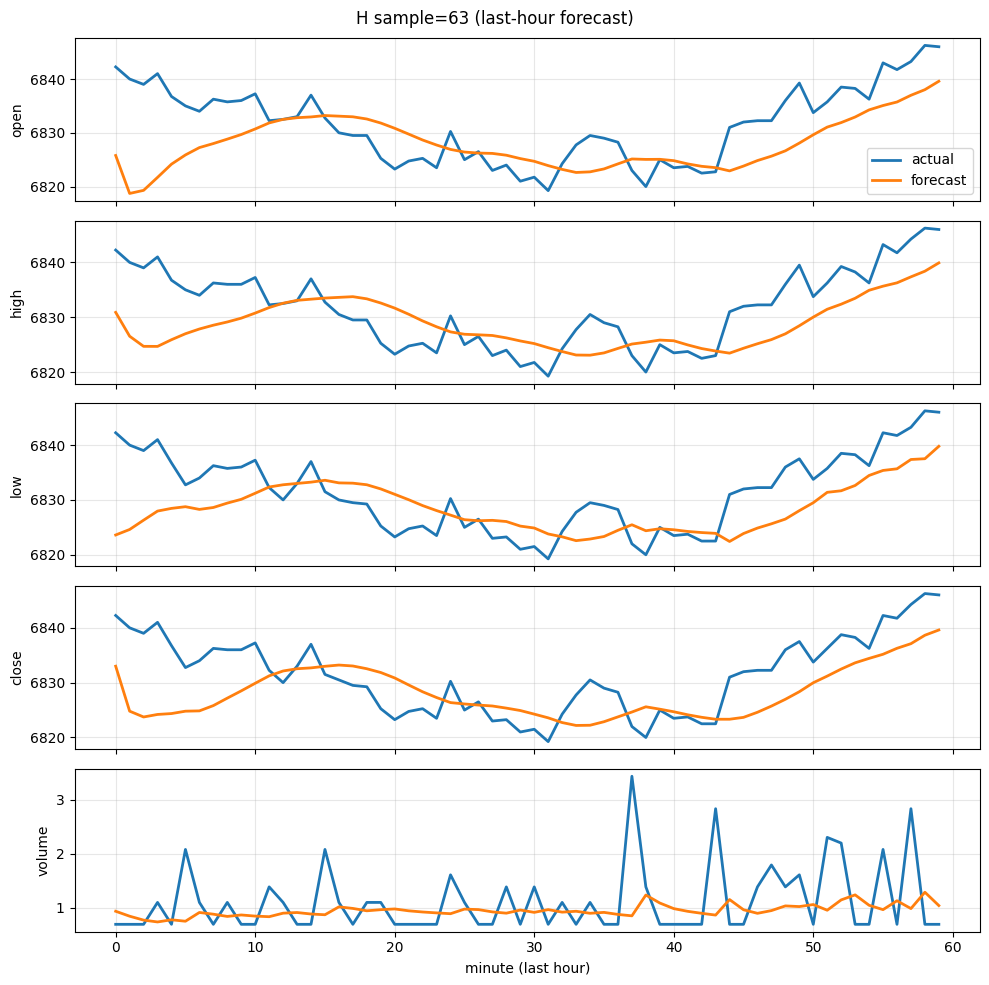

plot_saved: /content/artifacts/plot_H_test_64.png


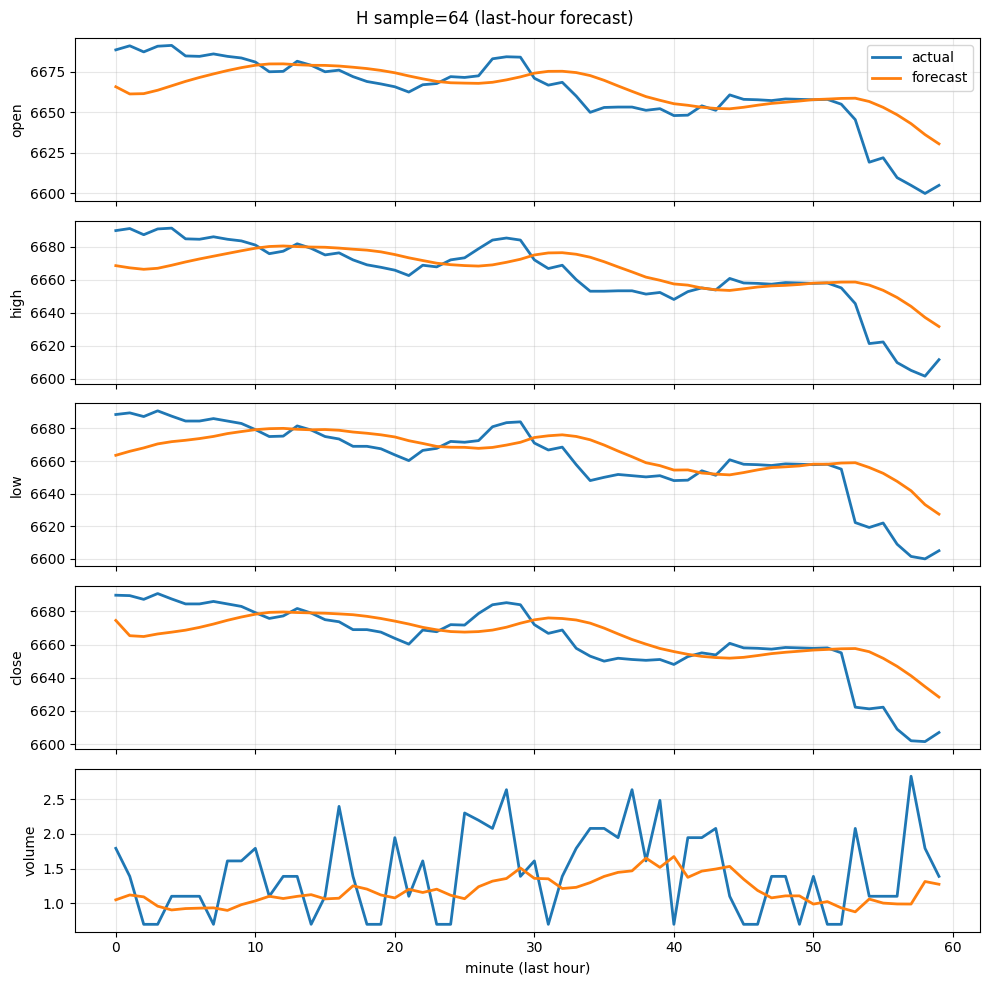

plot_saved: /content/artifacts/plot_H_test_65.png


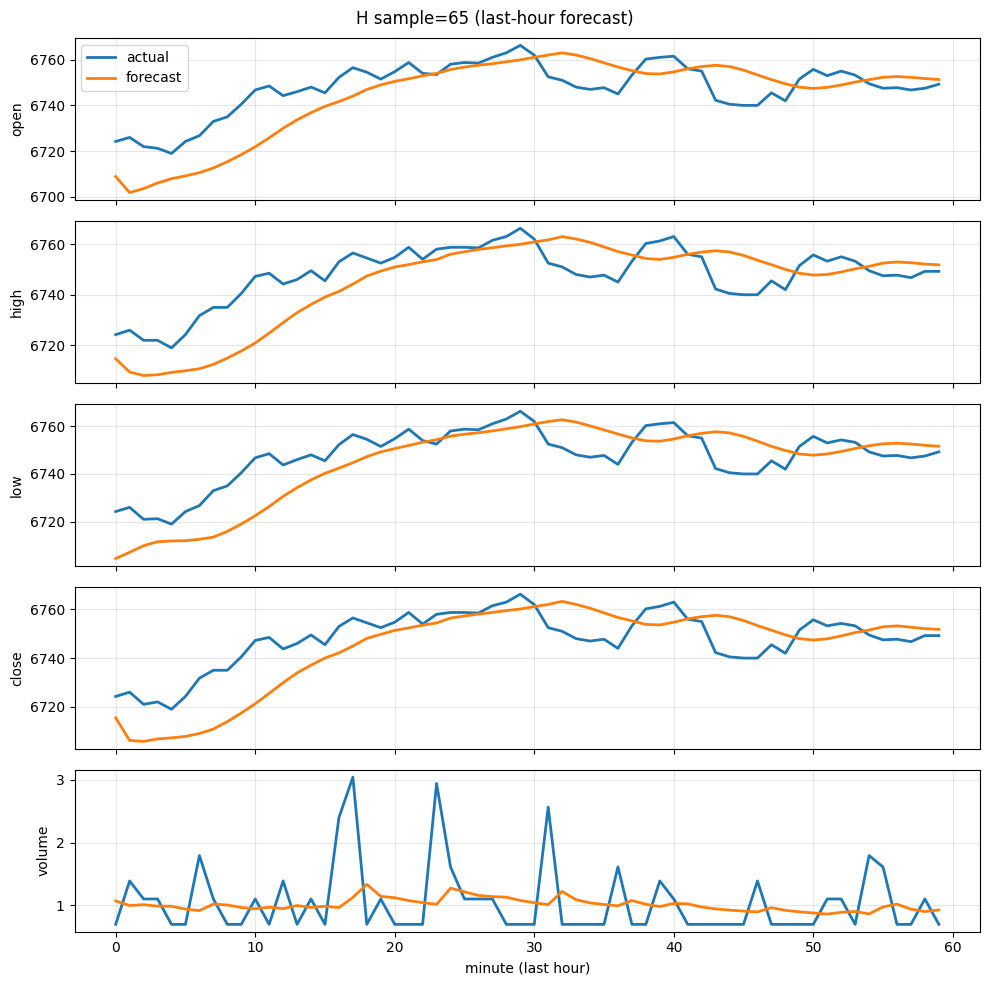

plot_saved: /content/artifacts/plot_H_test_66.png


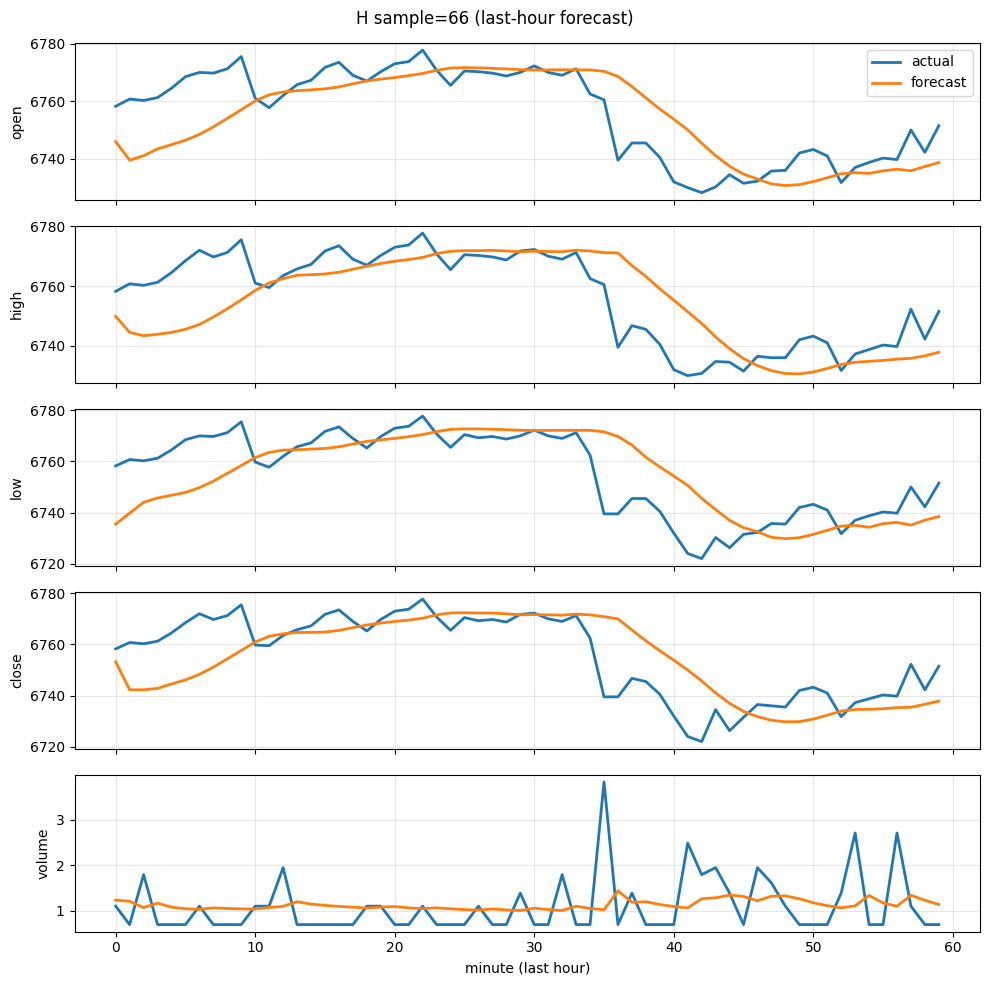

plot_saved: /content/artifacts/plot_H_test_67.png


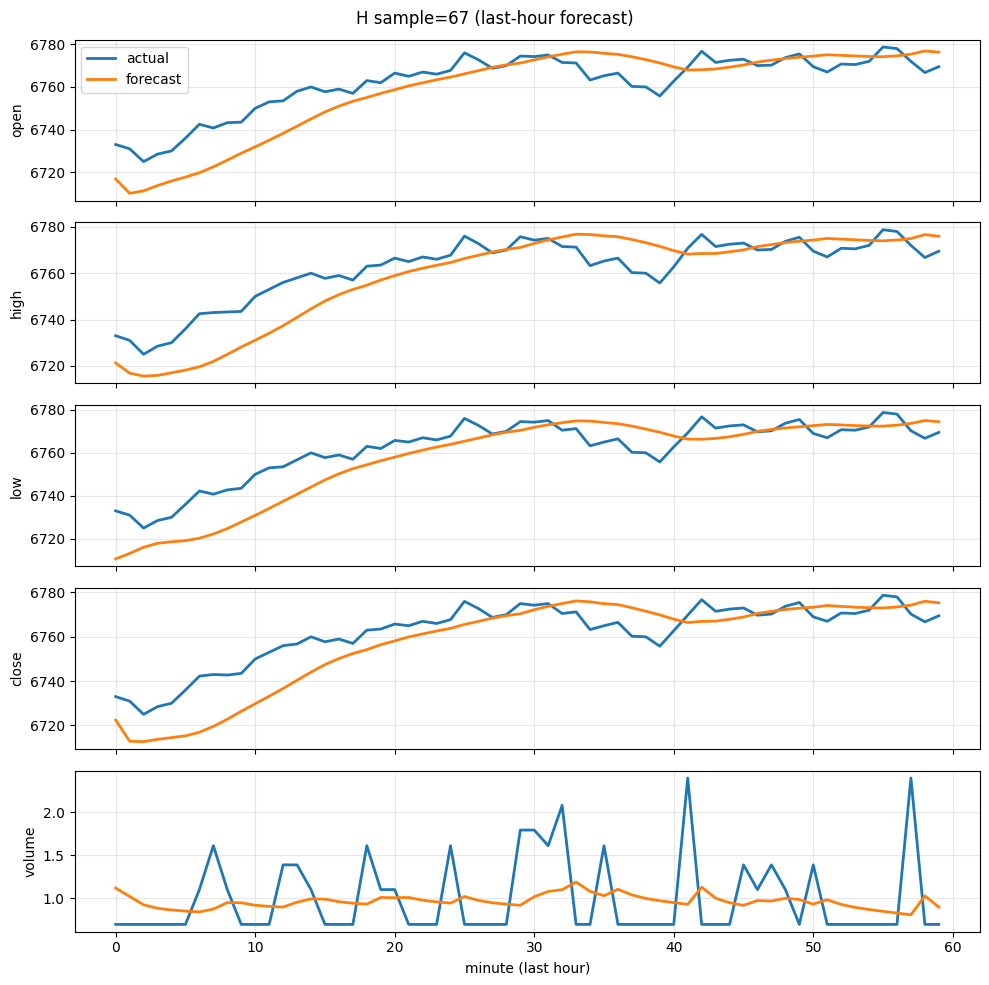

plot_saved: /content/artifacts/plot_H_test_68.png


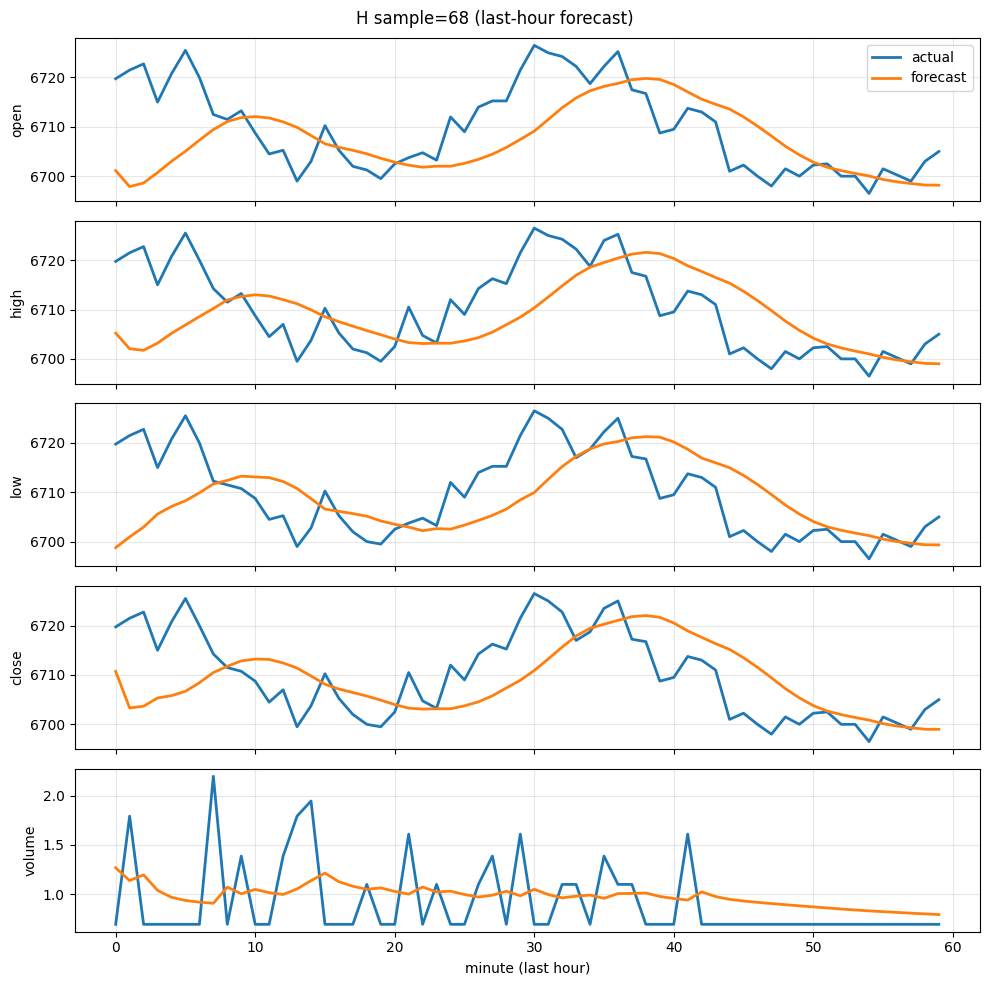

plot_saved: /content/artifacts/plot_H_test_69.png


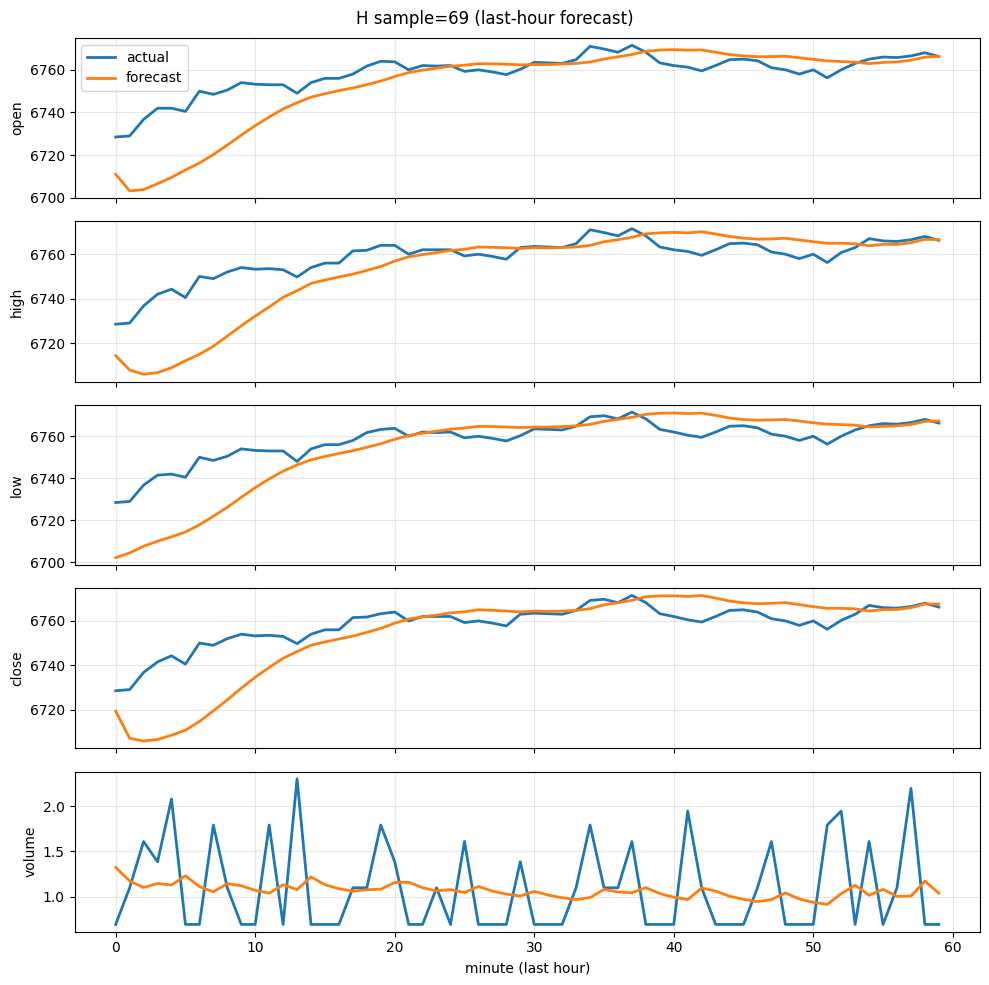

plot_saved: /content/artifacts/plot_H_test_70.png


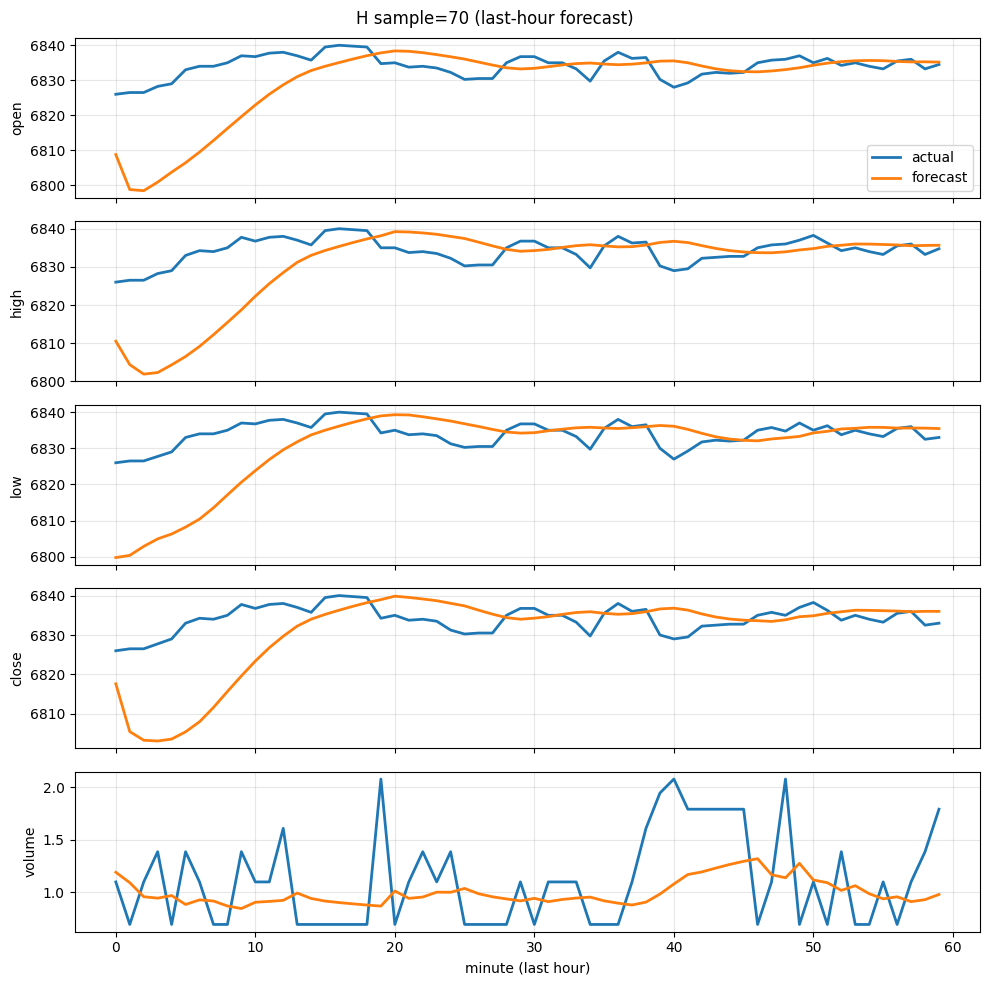

plot_saved: /content/artifacts/plot_H_test_71.png


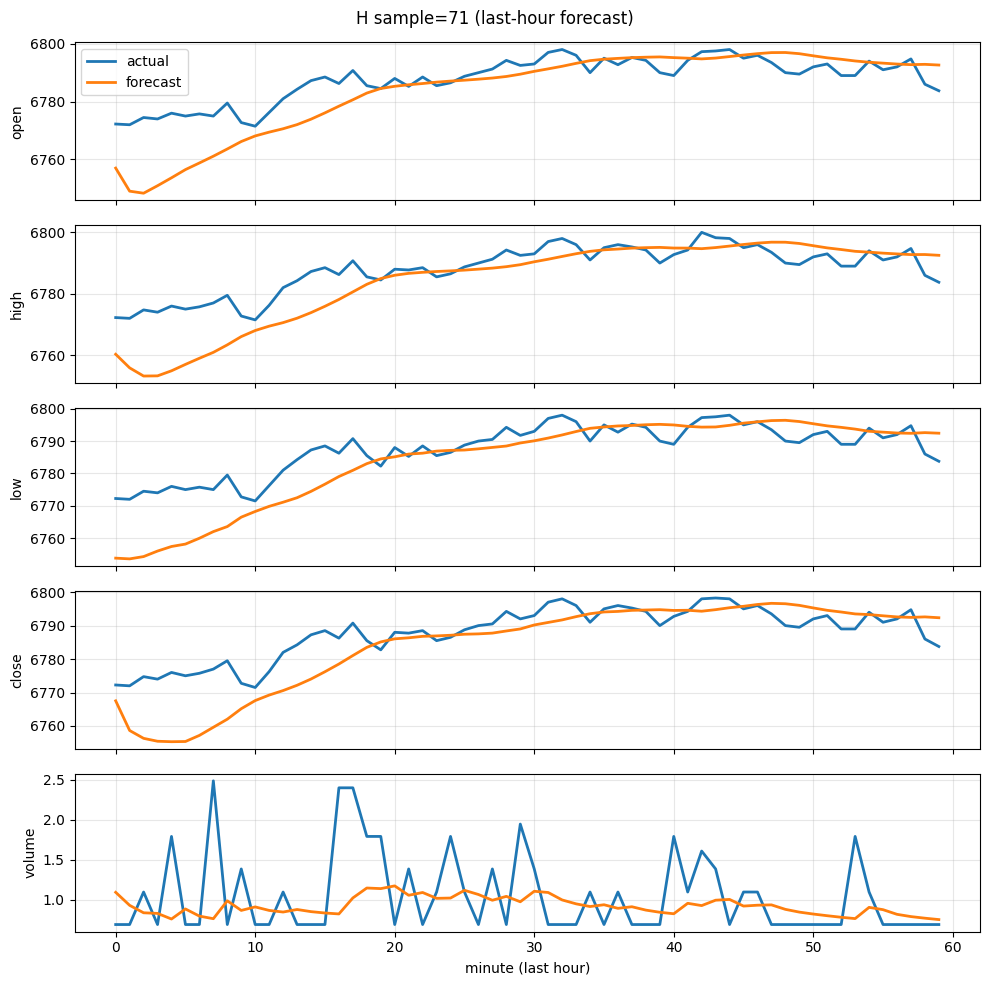

plot_saved: /content/artifacts/plot_H_test_72.png


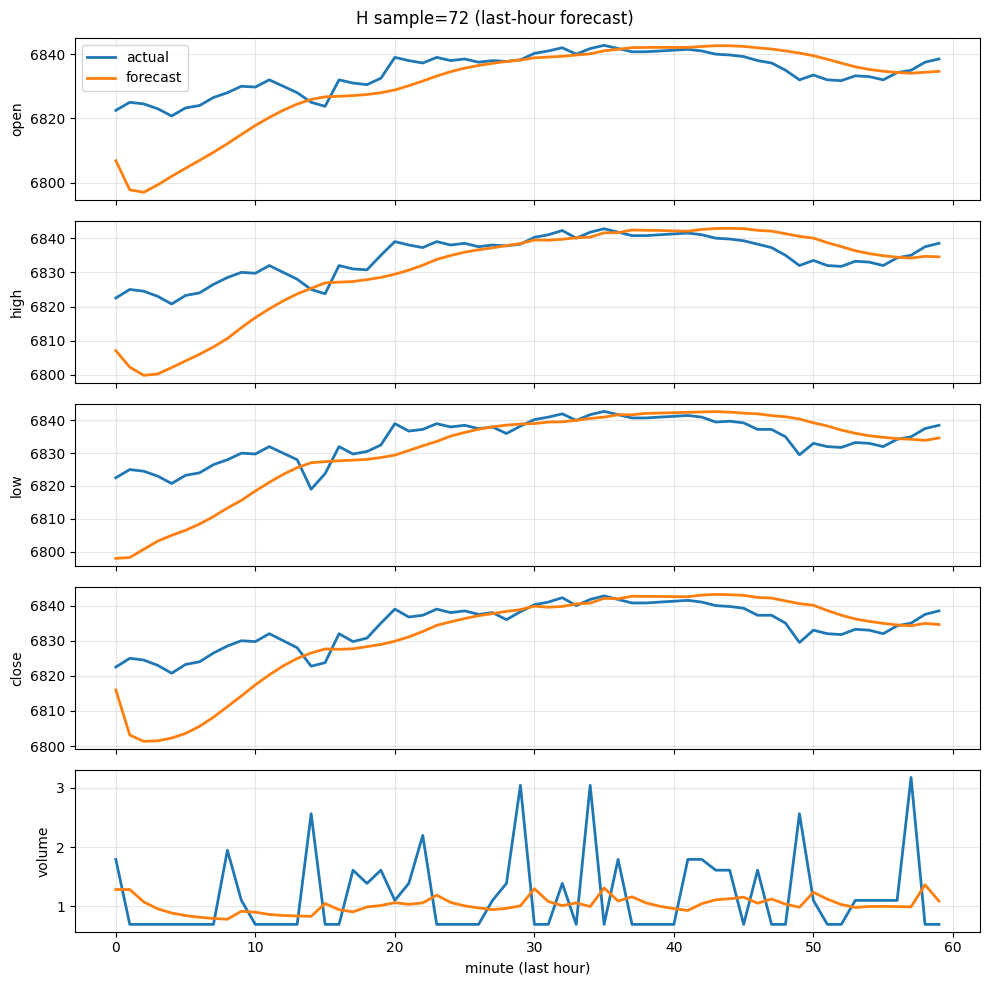

plot_saved: /content/artifacts/plot_H_test_73.png


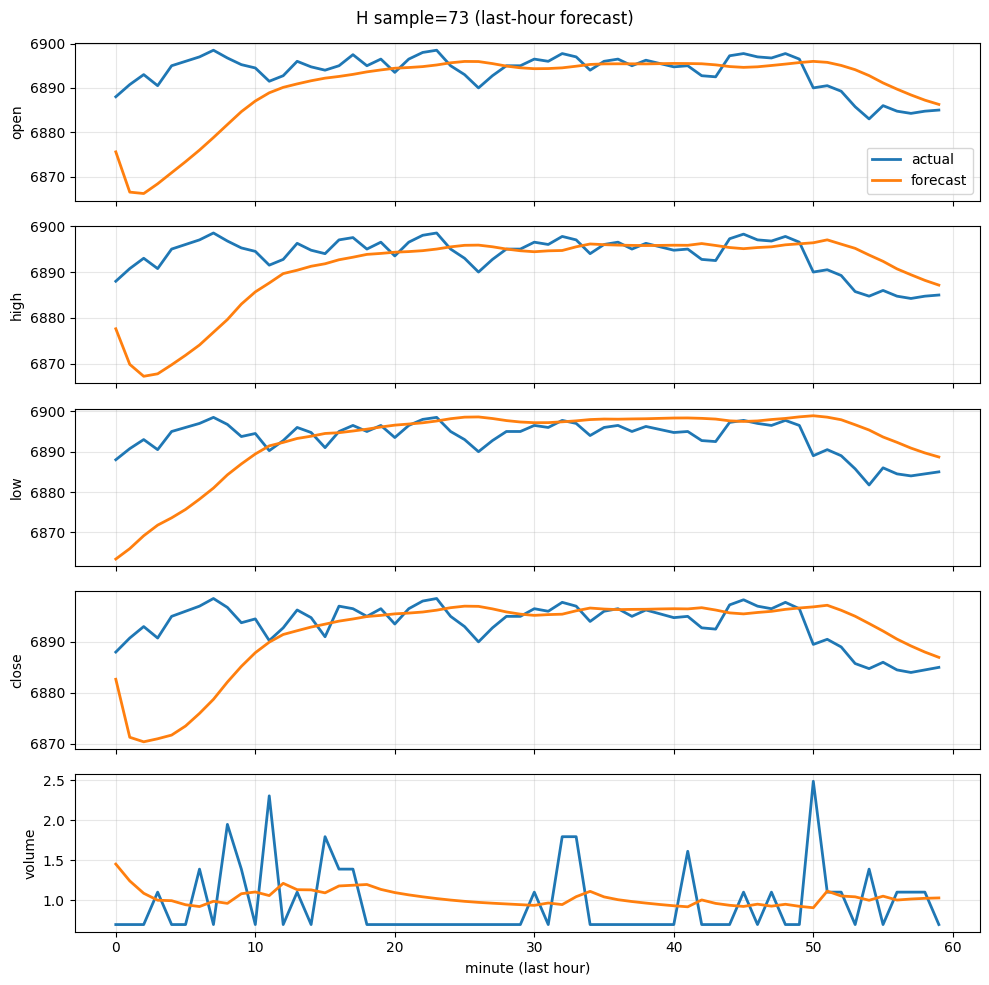

plot_saved: /content/artifacts/plot_H_test_74.png


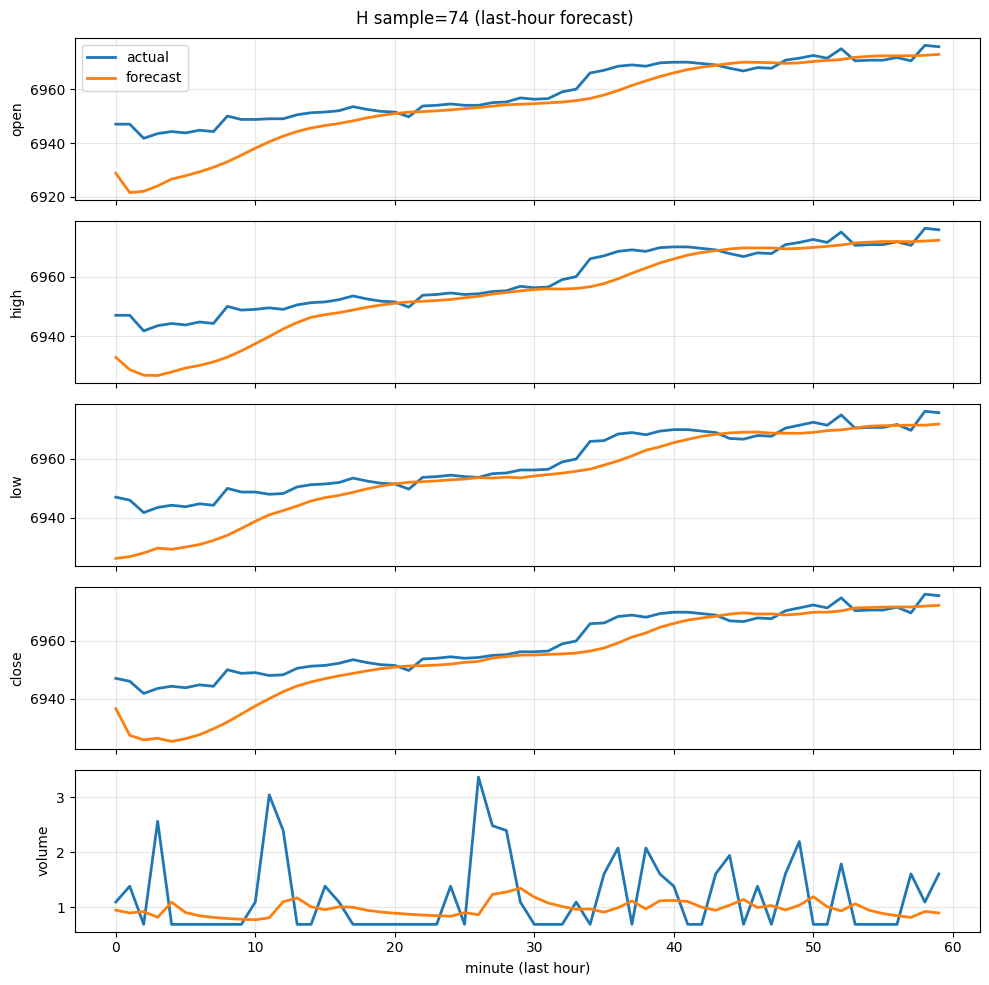

plot_saved: /content/artifacts/plot_H_test_75.png


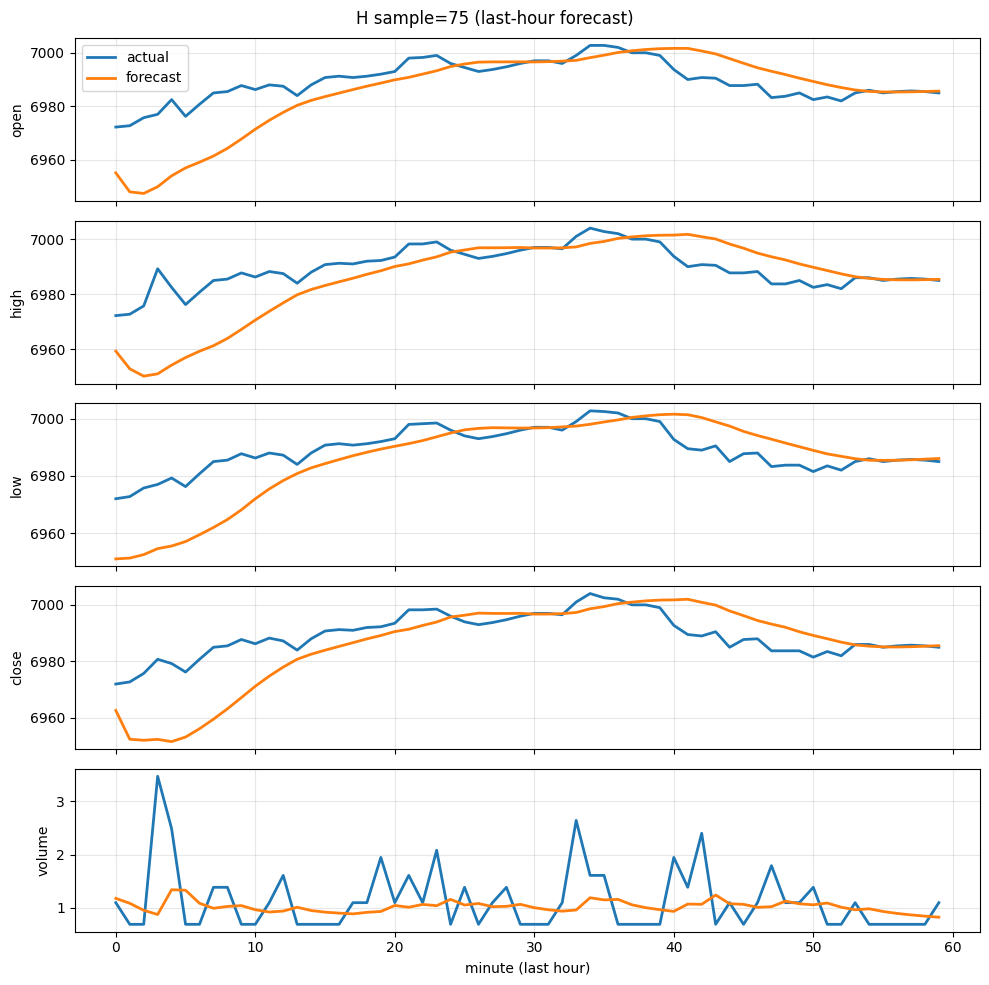

plot_saved: /content/artifacts/plot_H_test_76.png


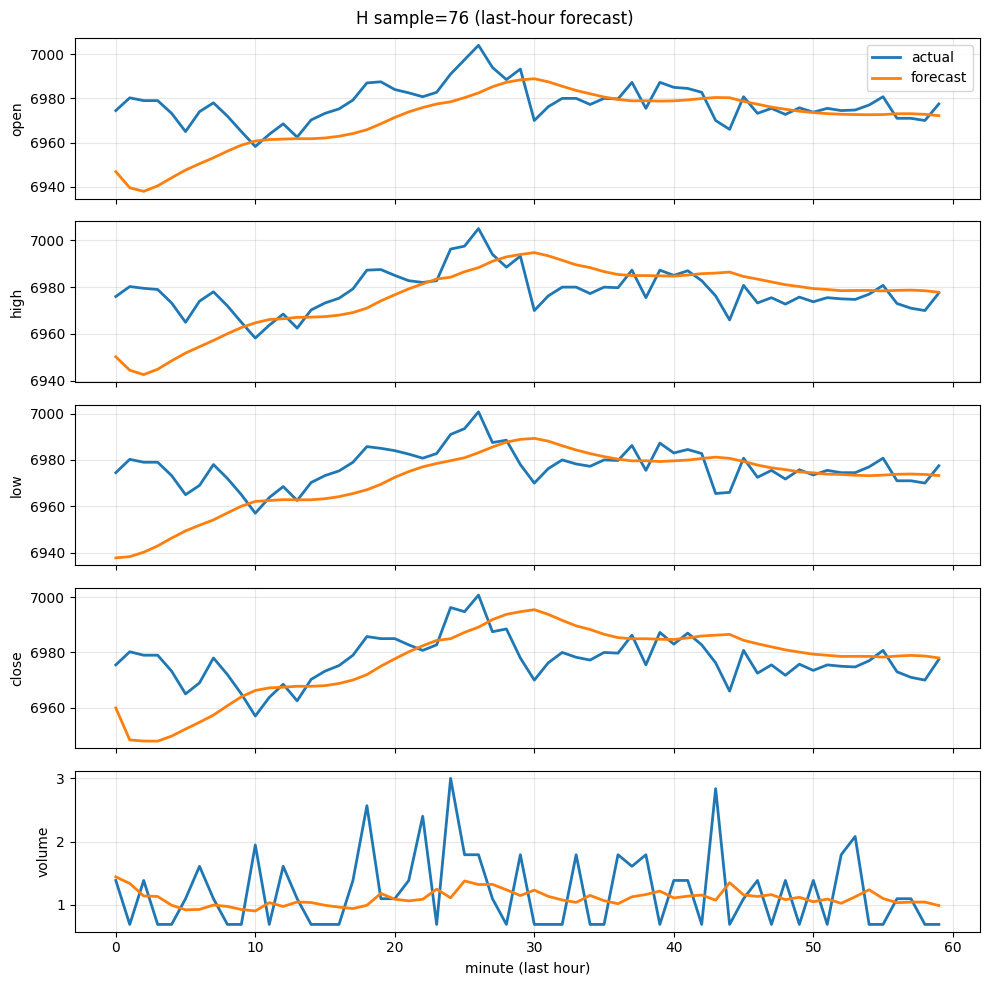

plot_saved: /content/artifacts/plot_H_test_77.png


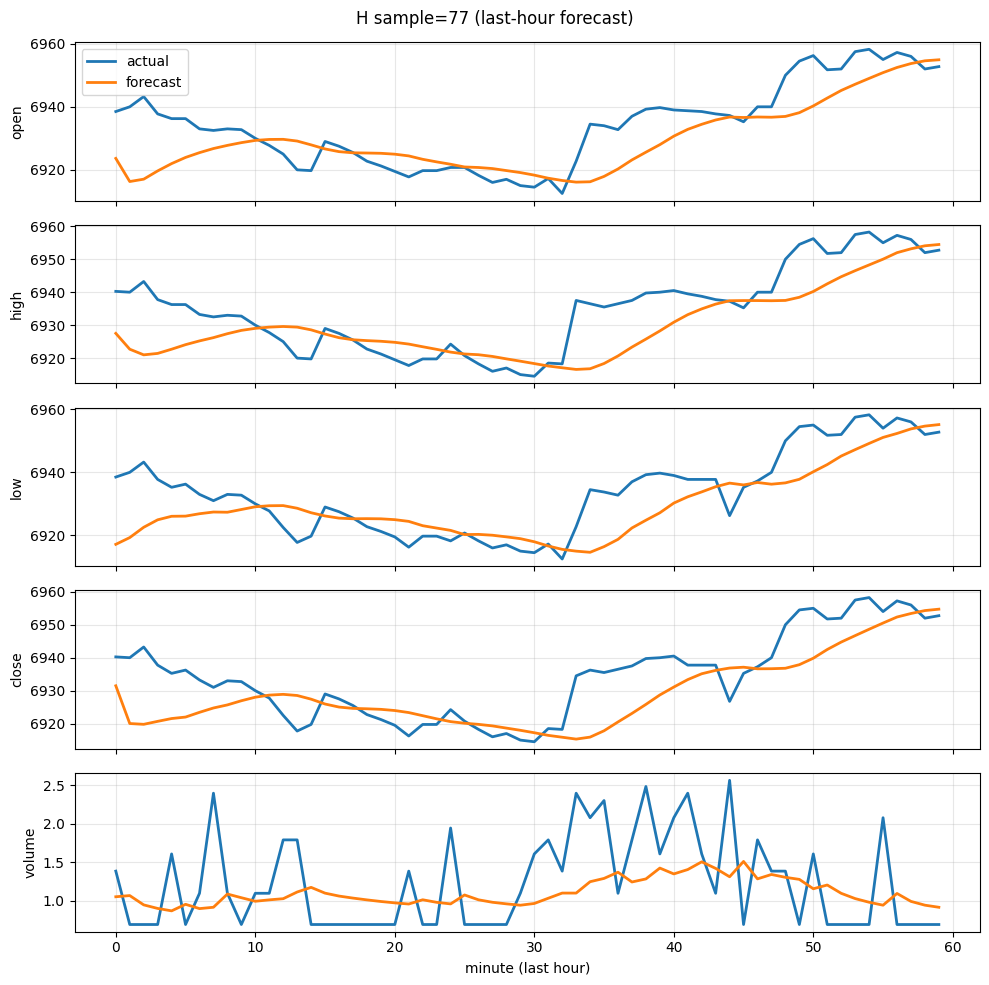

plot_saved: /content/artifacts/plot_H_test_78.png


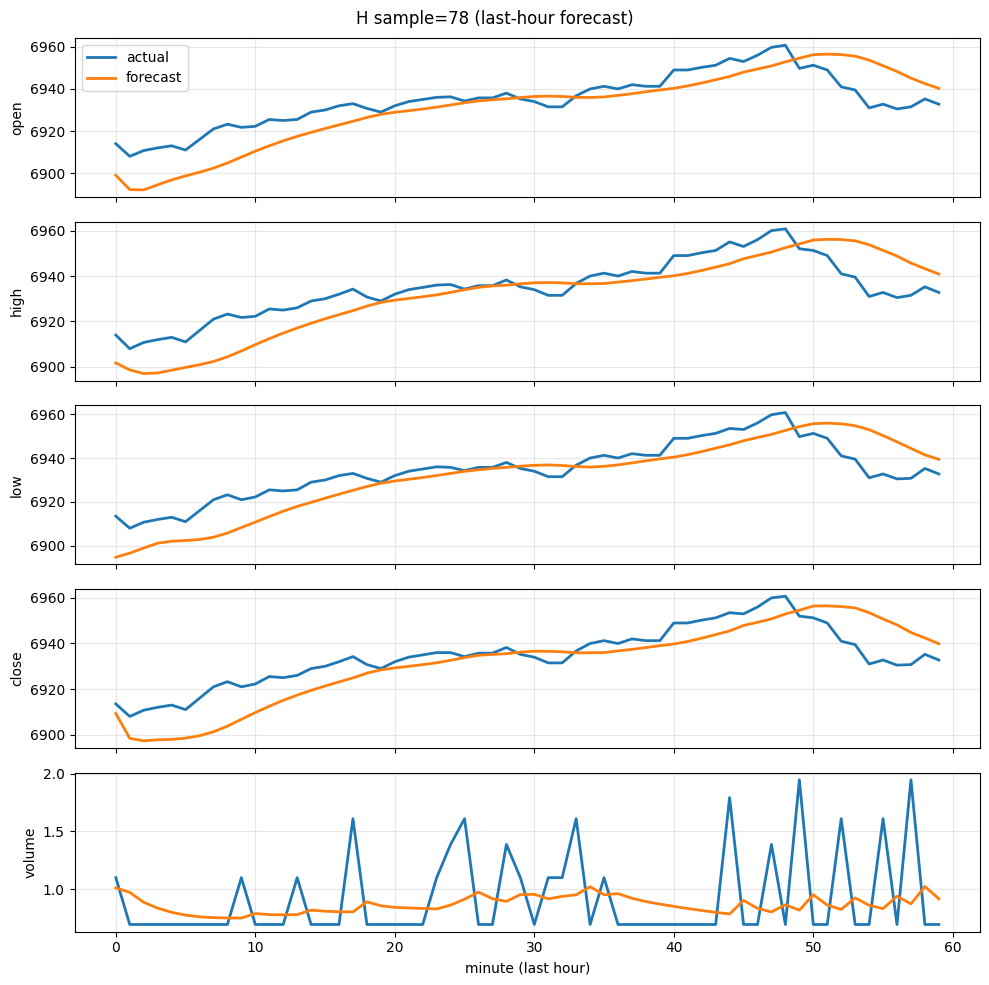

plot_saved: /content/artifacts/plot_H_test_79.png


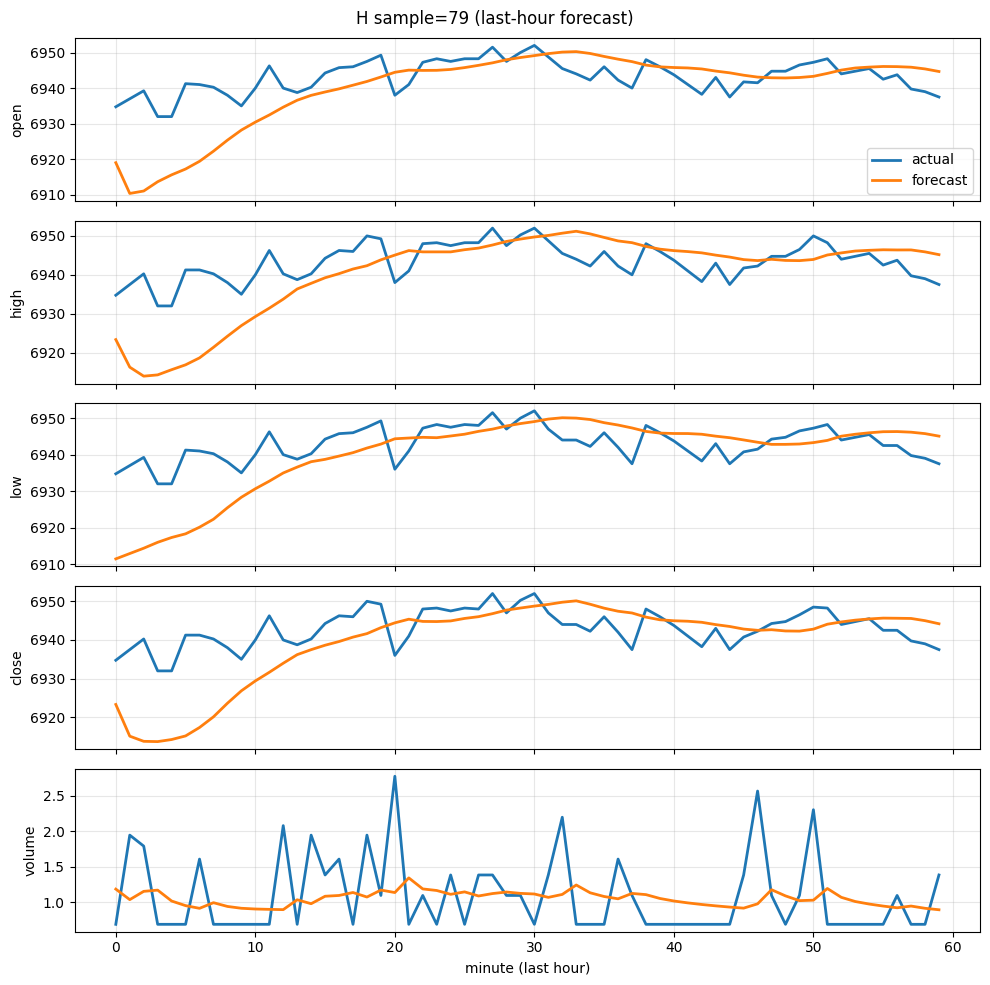

plot_saved: /content/artifacts/plot_H_test_80.png


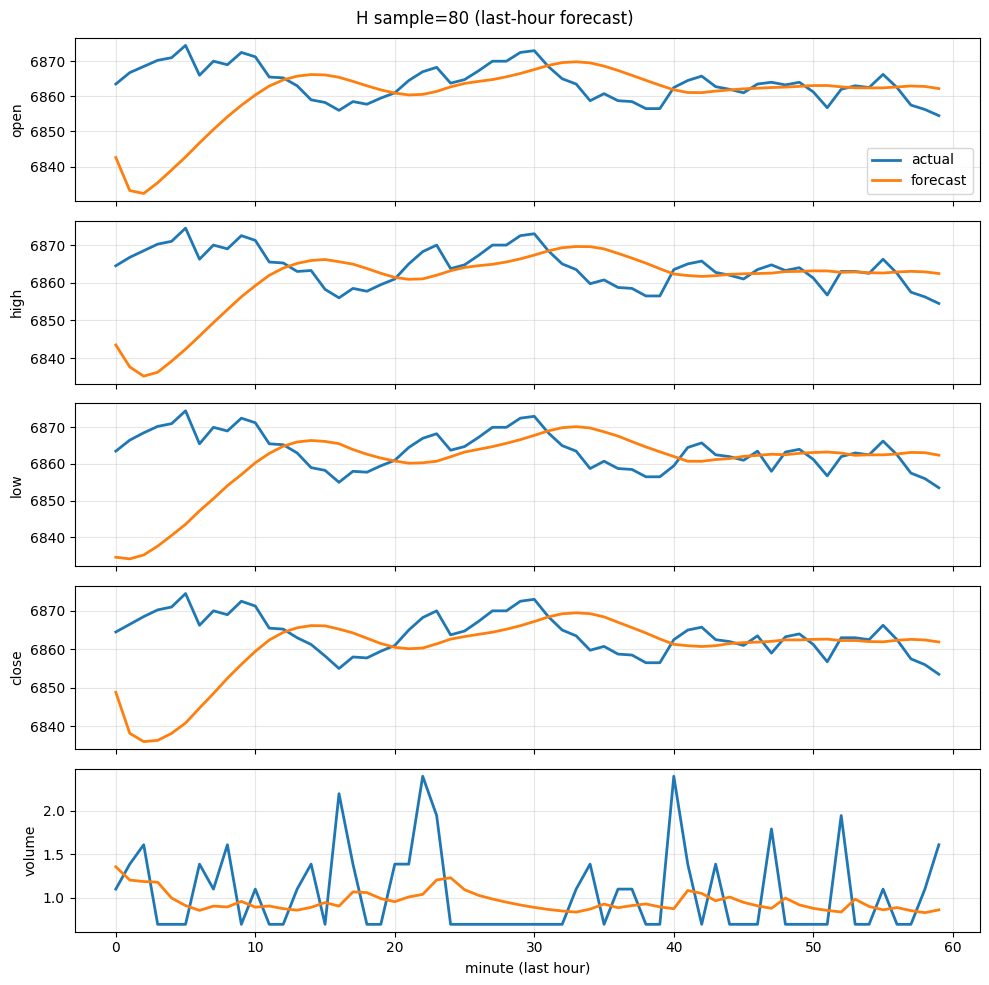

plot_saved: /content/artifacts/plot_H_test_81.png


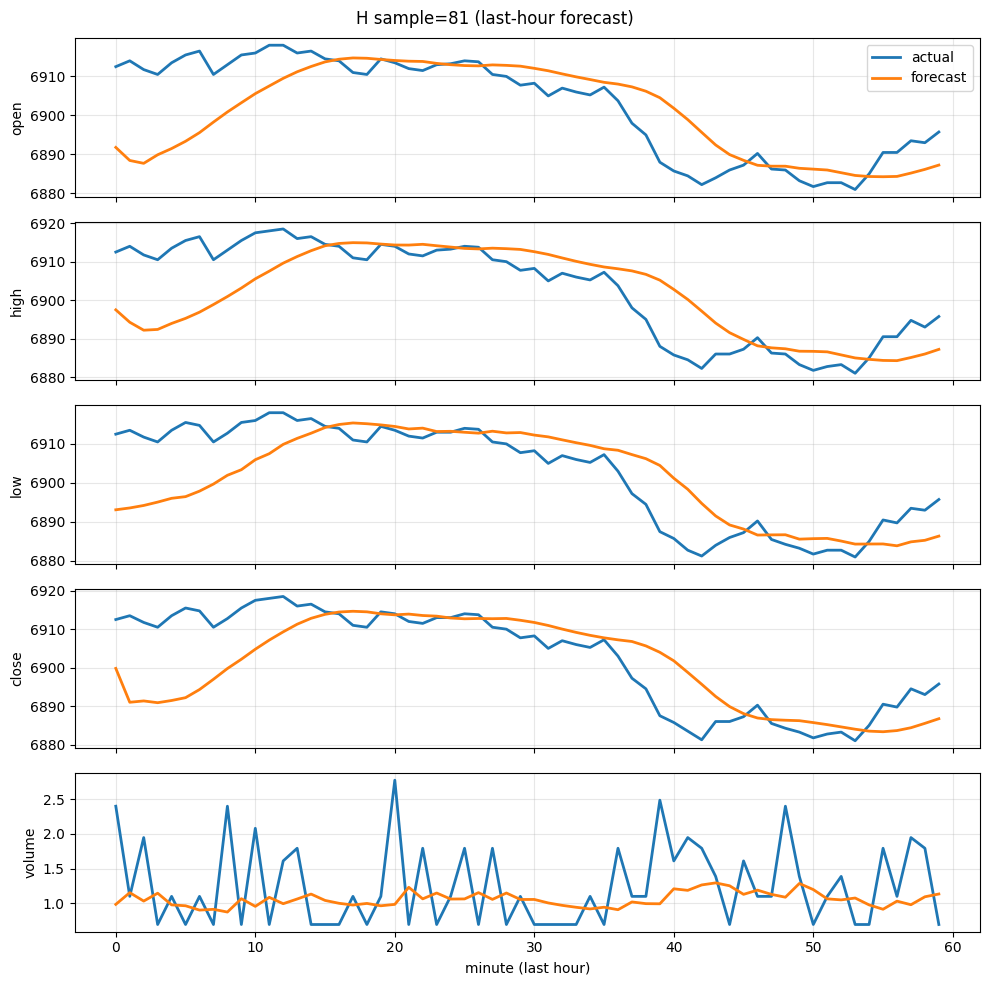

plot_saved: /content/artifacts/plot_H_test_82.png


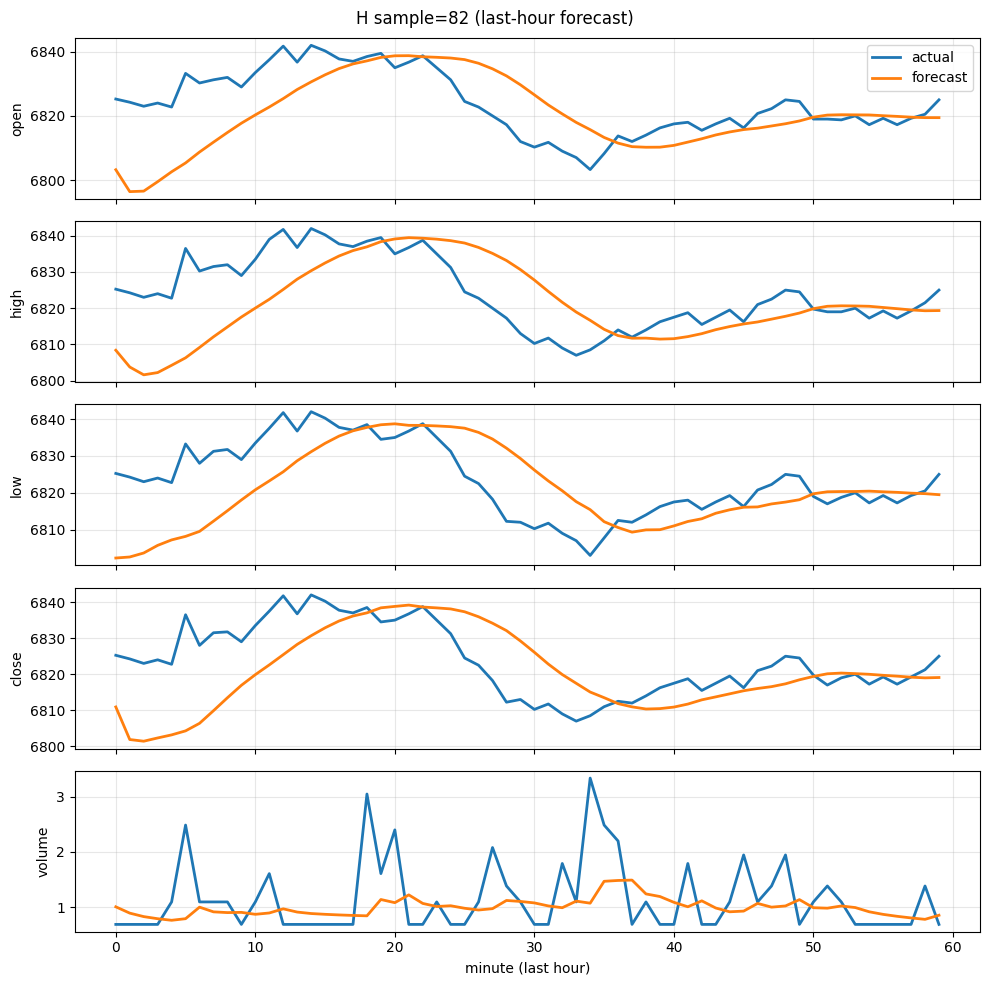

plot_saved: /content/artifacts/plot_H_test_83.png


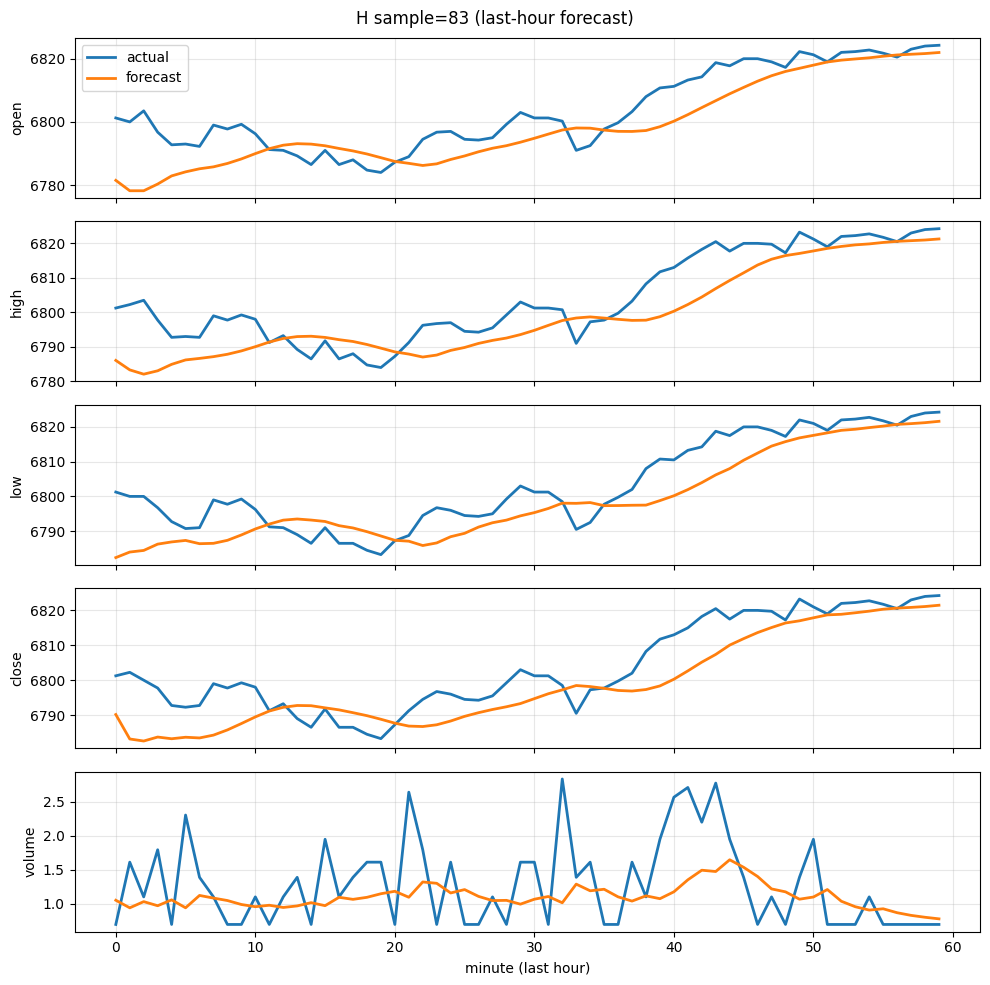

plot_saved: /content/artifacts/plot_H_test_84.png


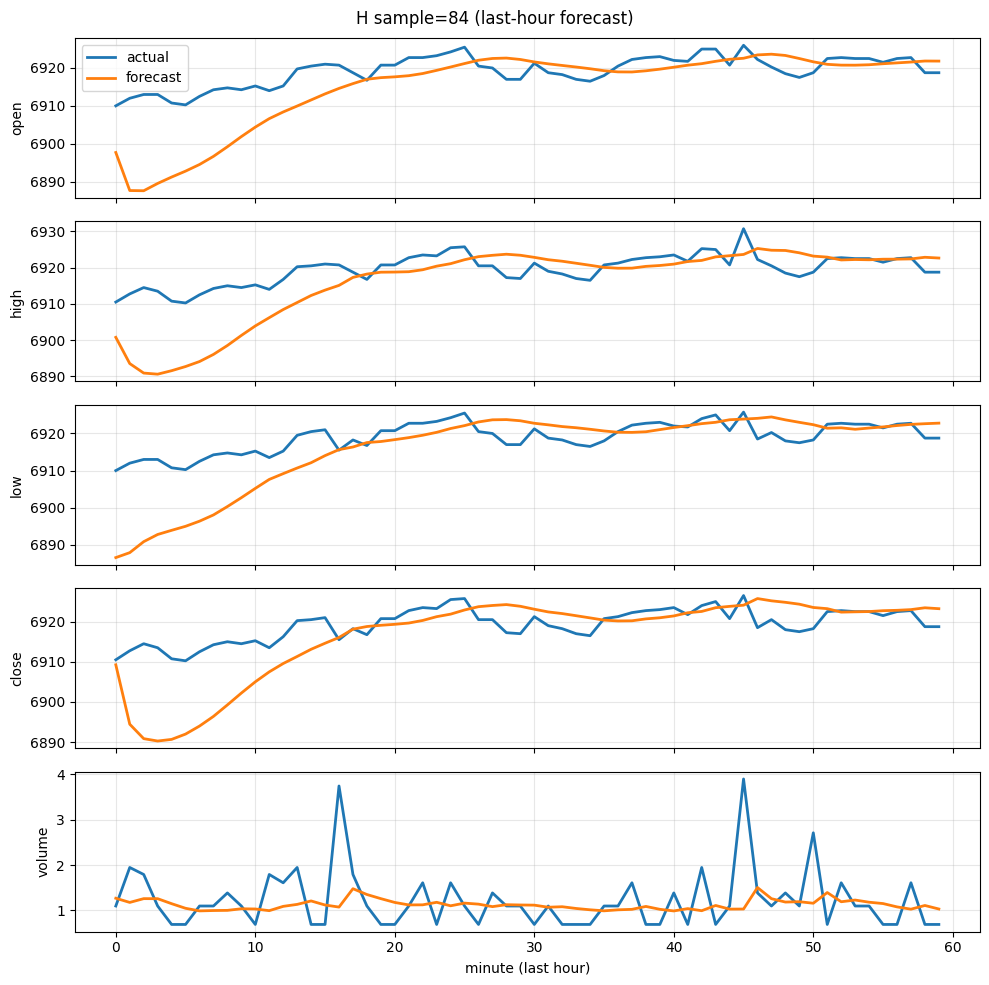

plot_saved: /content/artifacts/plot_H_test_85.png


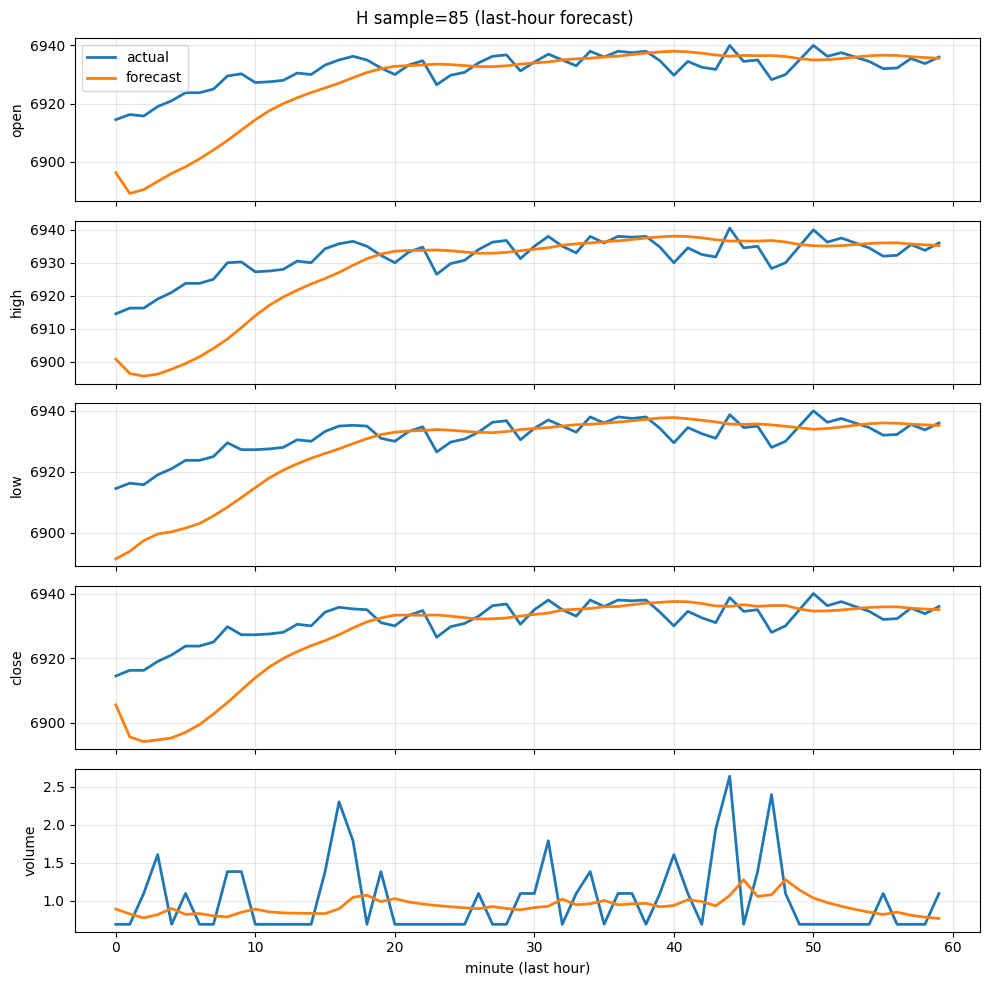

plot_saved: /content/artifacts/plot_H_test_86.png


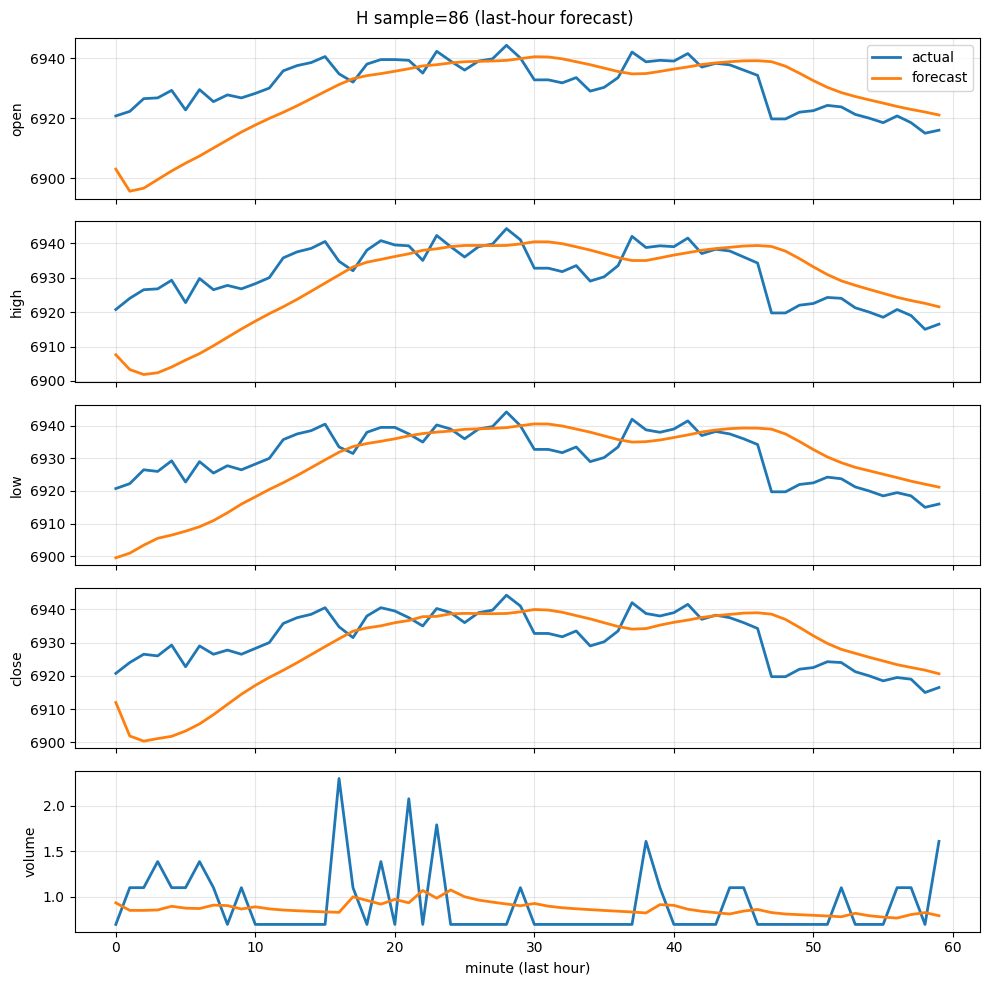

plot_saved: /content/artifacts/plot_H_test_87.png


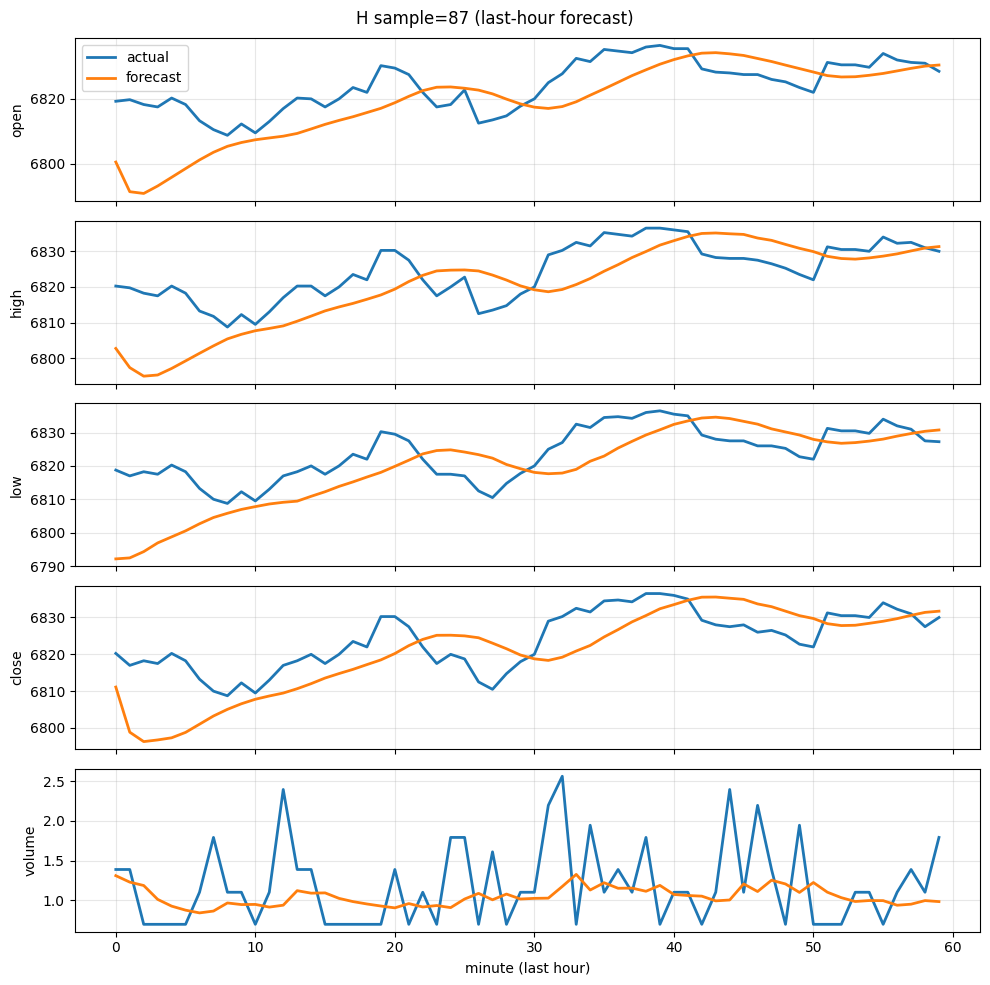

plot_saved: /content/artifacts/plot_H_test_88.png


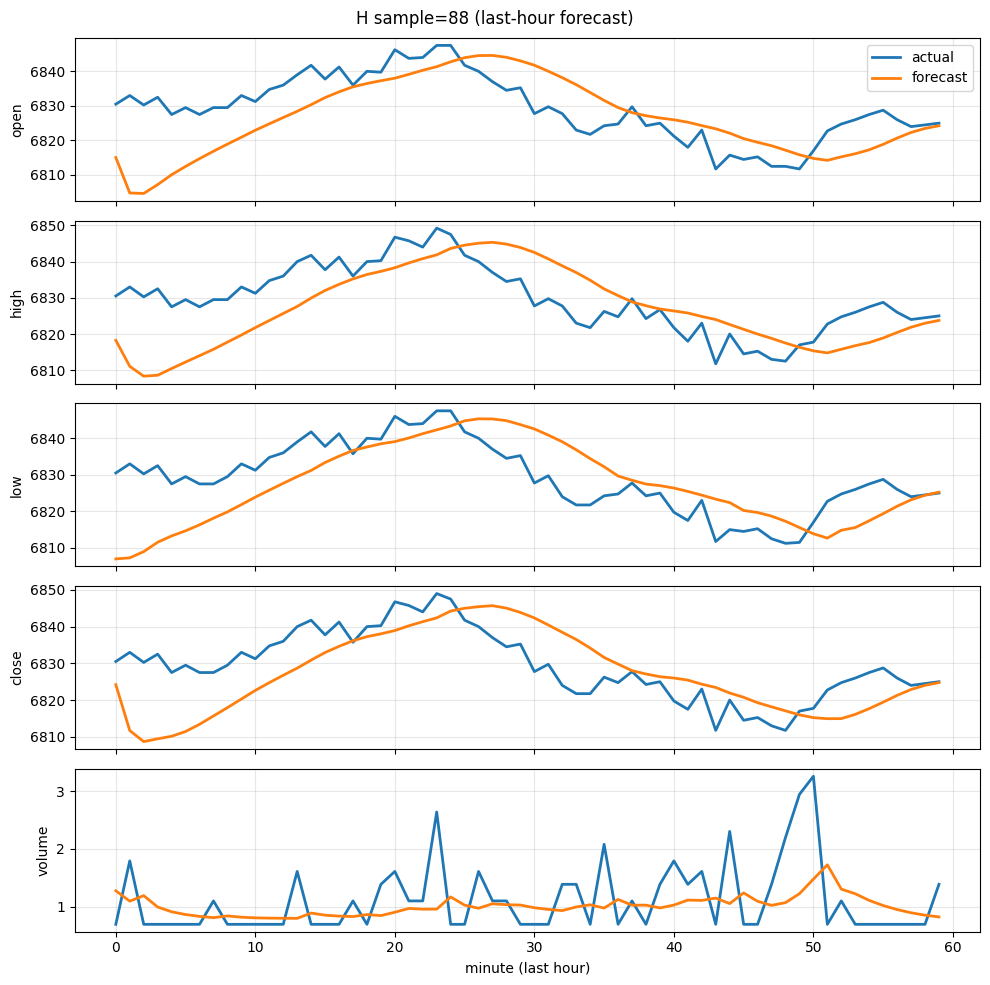

plot_saved: /content/artifacts/plot_H_test_89.png


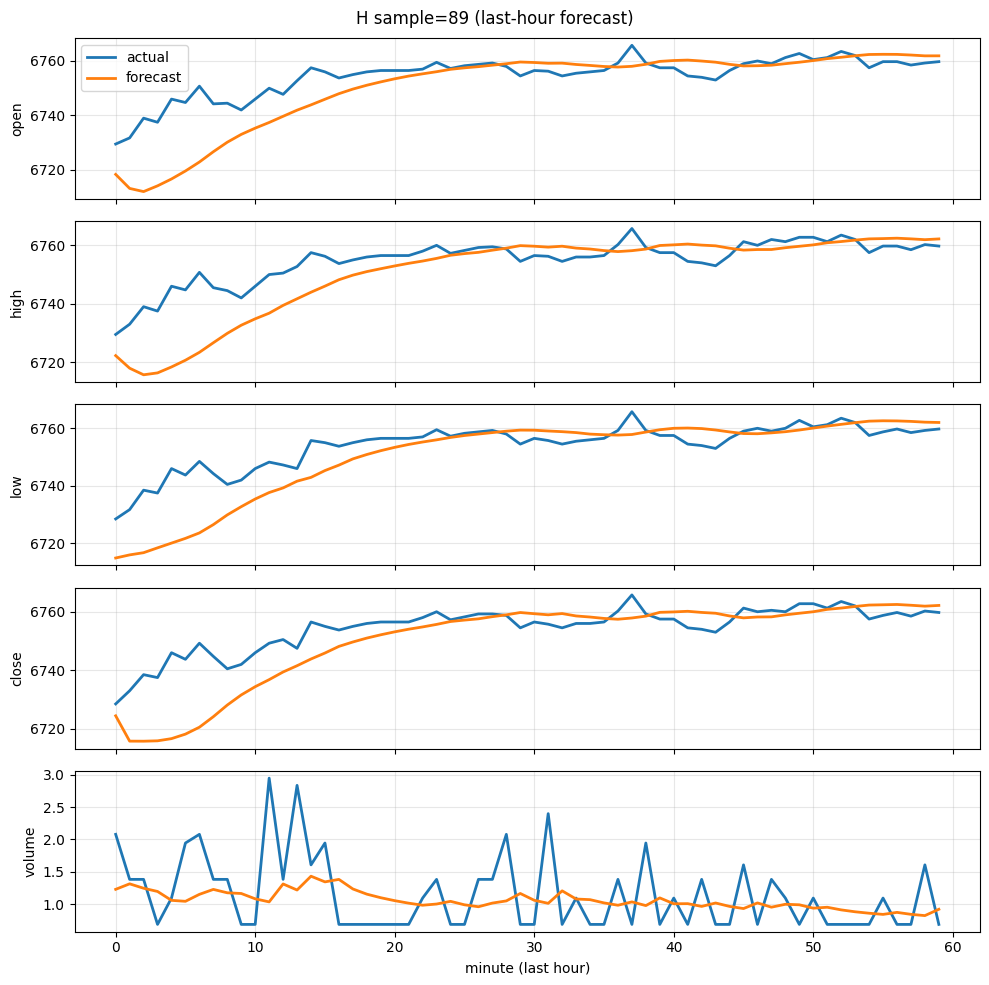

plot_saved: /content/artifacts/plot_H_test_90.png


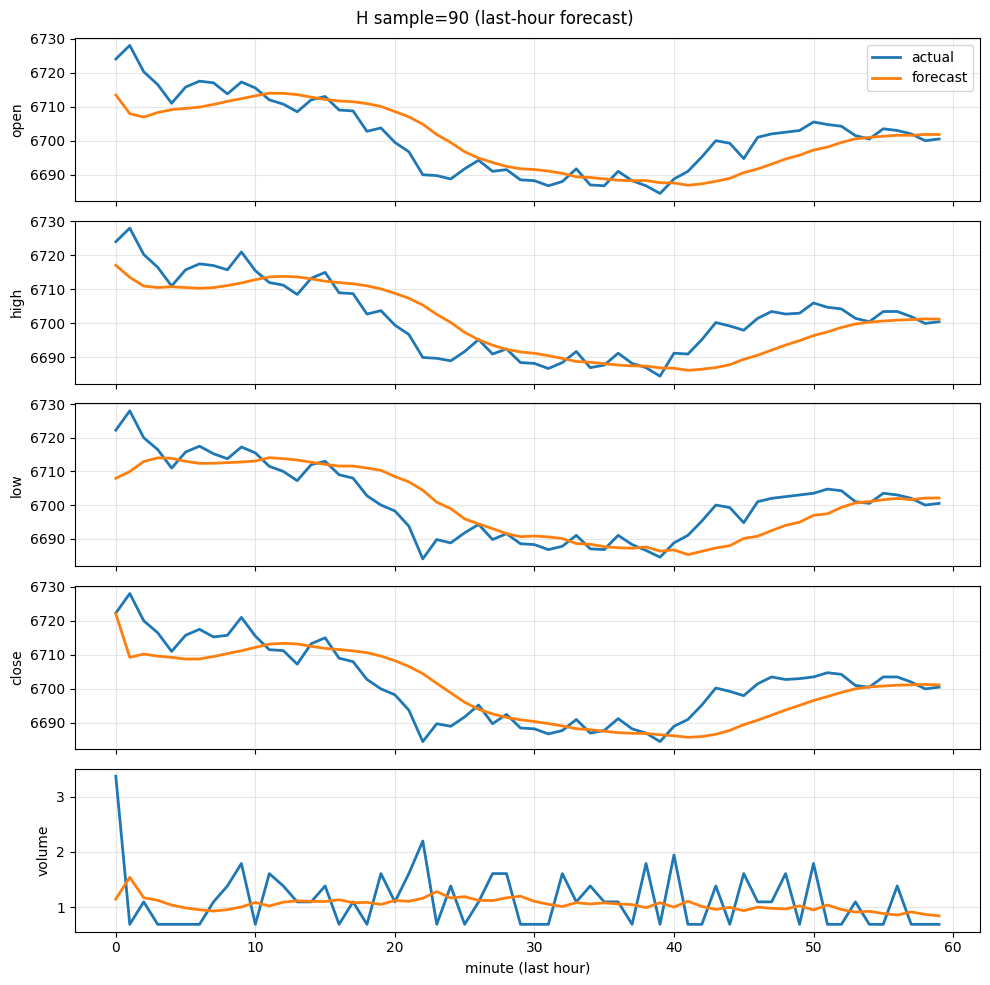

plot_saved: /content/artifacts/plot_H_test_91.png


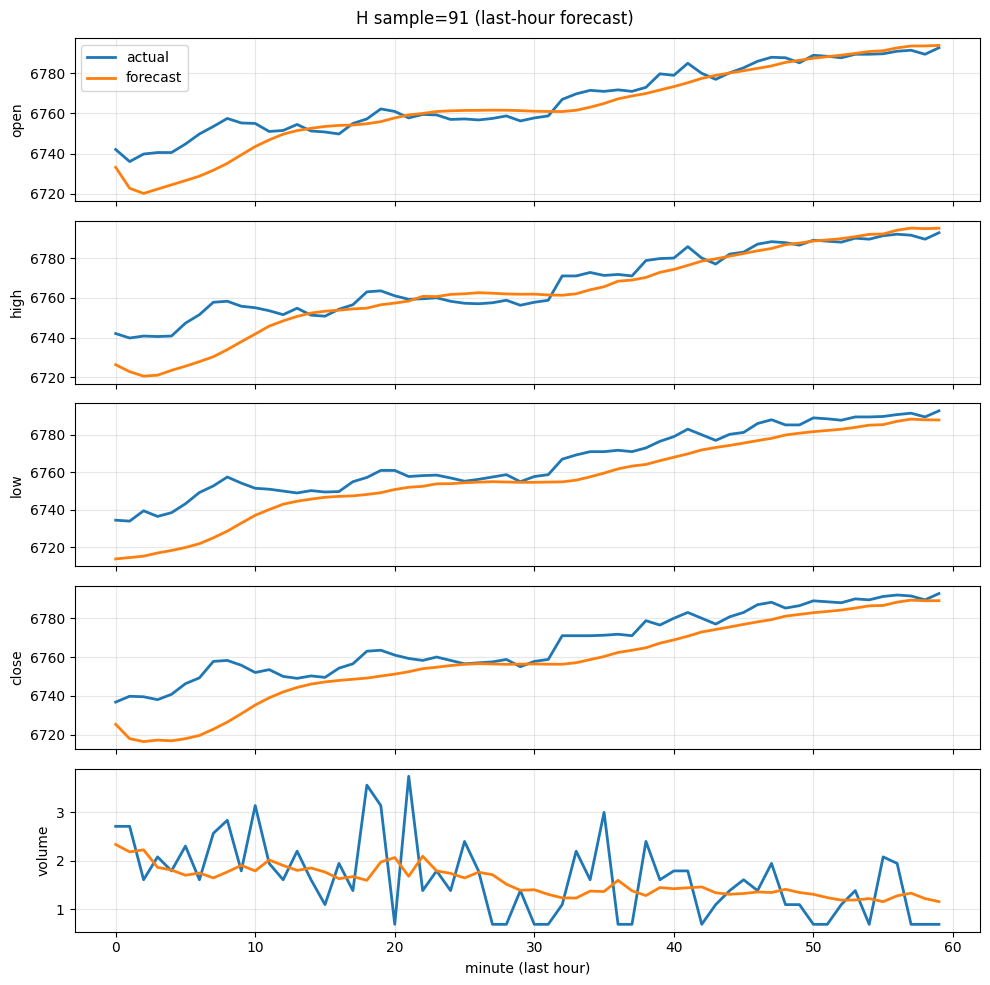

plot_saved: /content/artifacts/plot_H_test_92.png


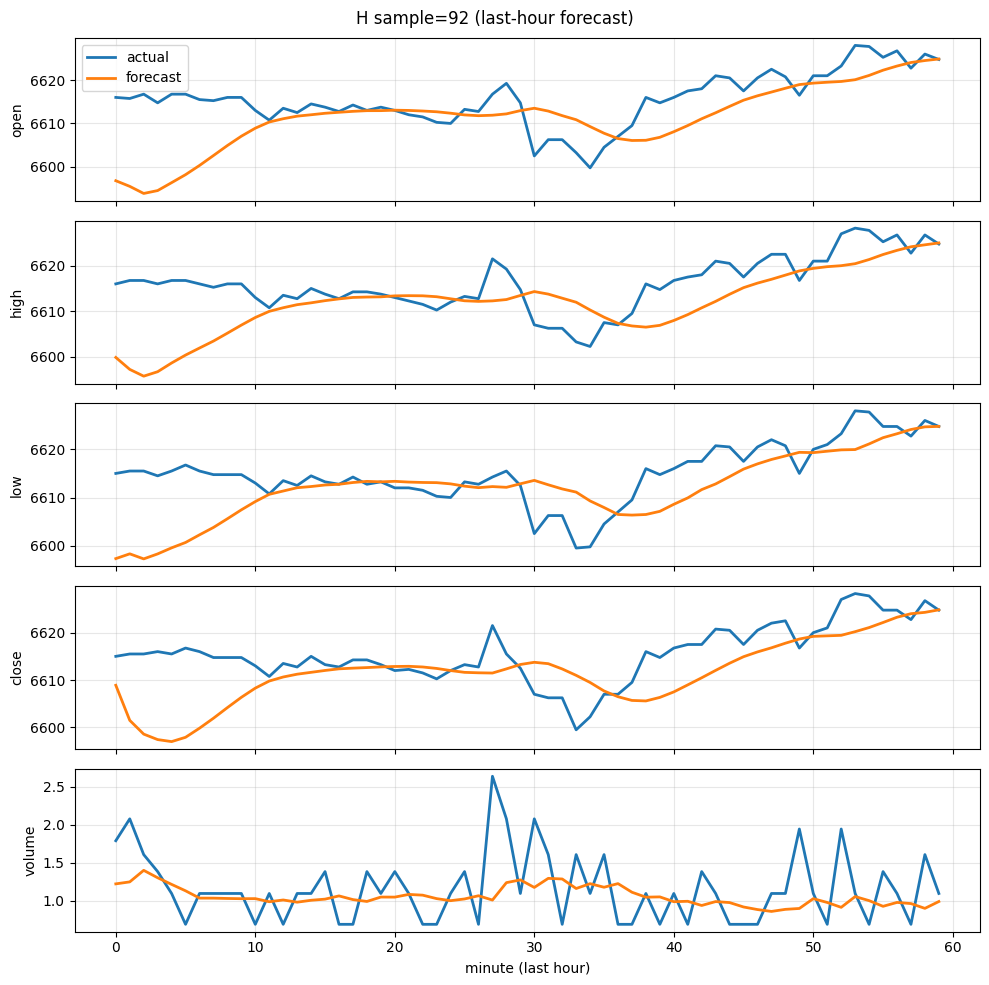

plot_saved: /content/artifacts/plot_H_test_93.png


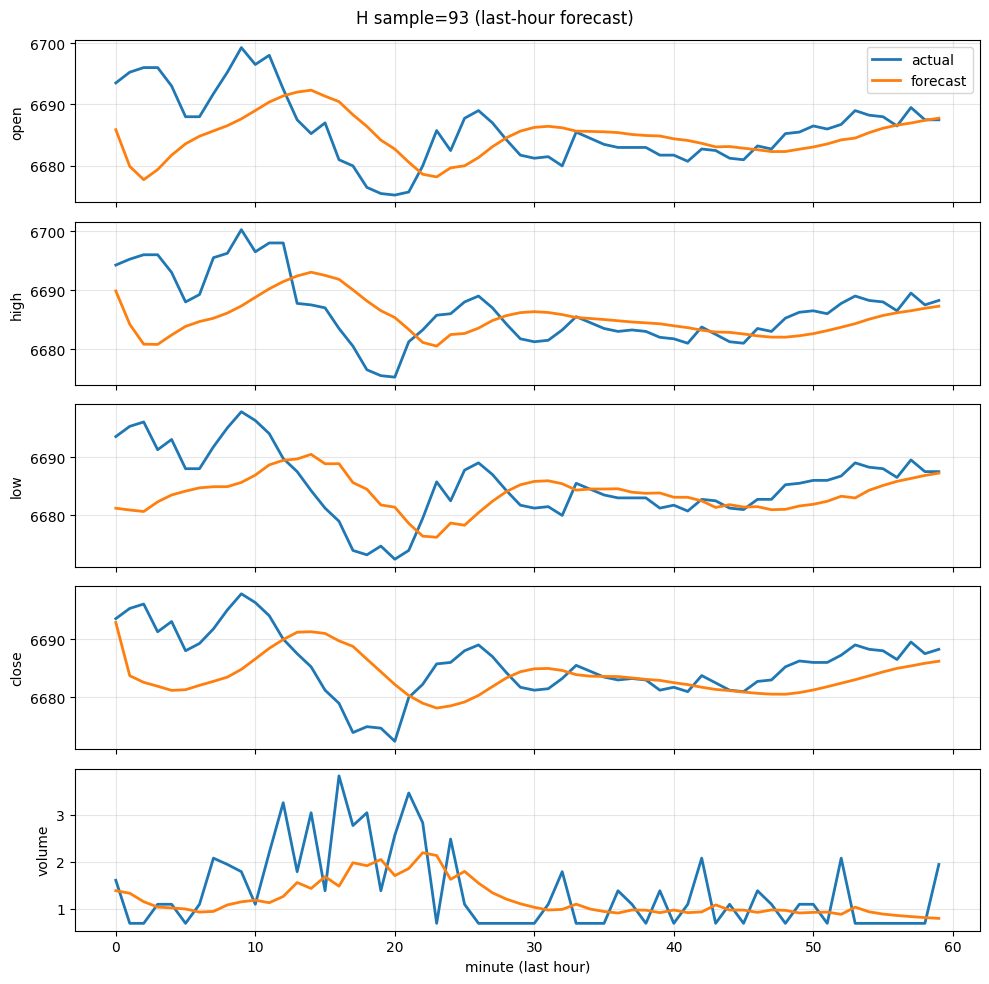

plot_saved: /content/artifacts/plot_H_test_94.png


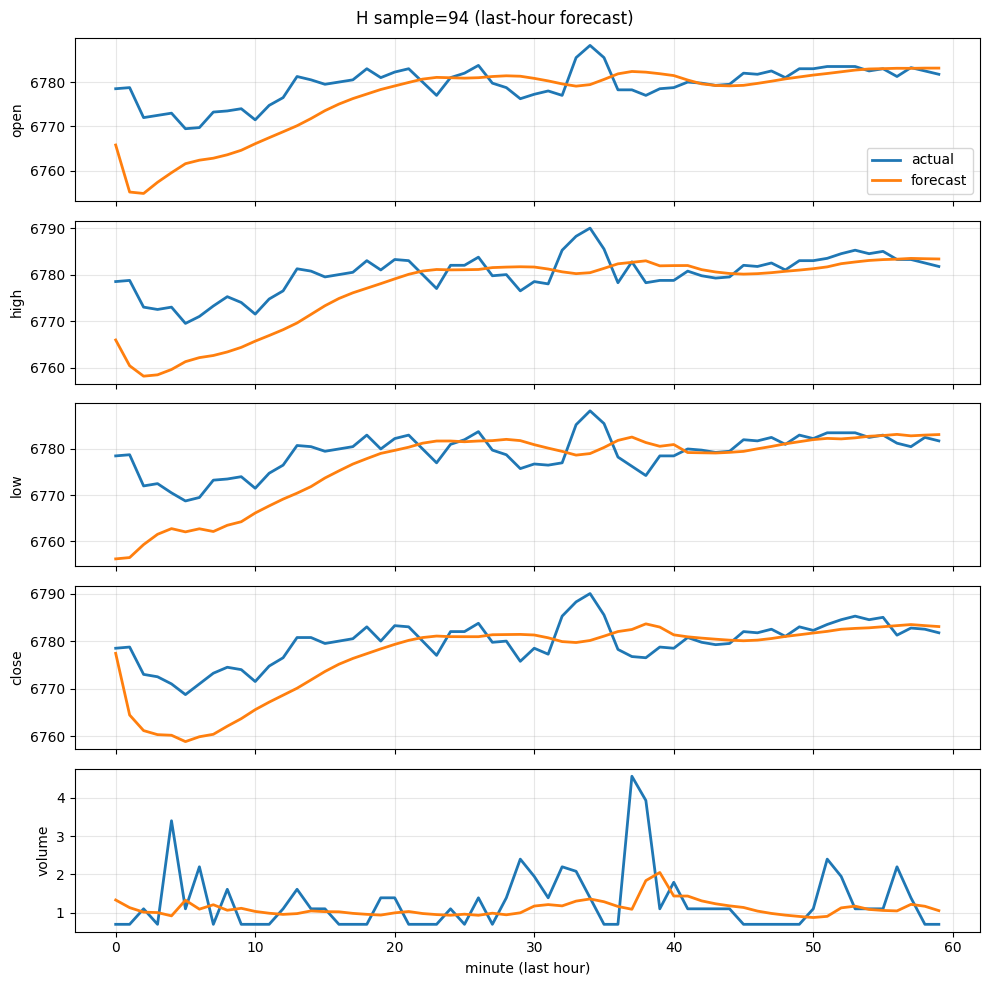

plot_saved: /content/artifacts/plot_H_test_95.png


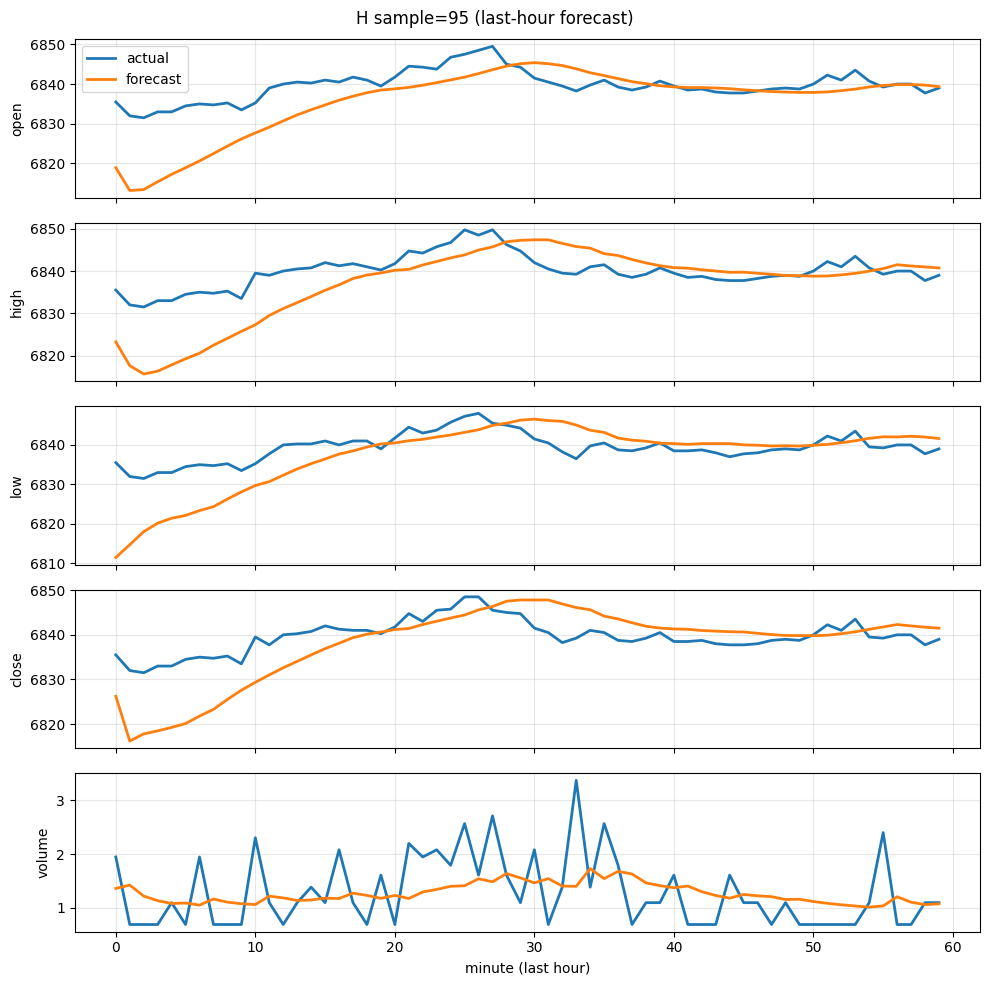

plot_saved: /content/artifacts/plot_H_test_96.png


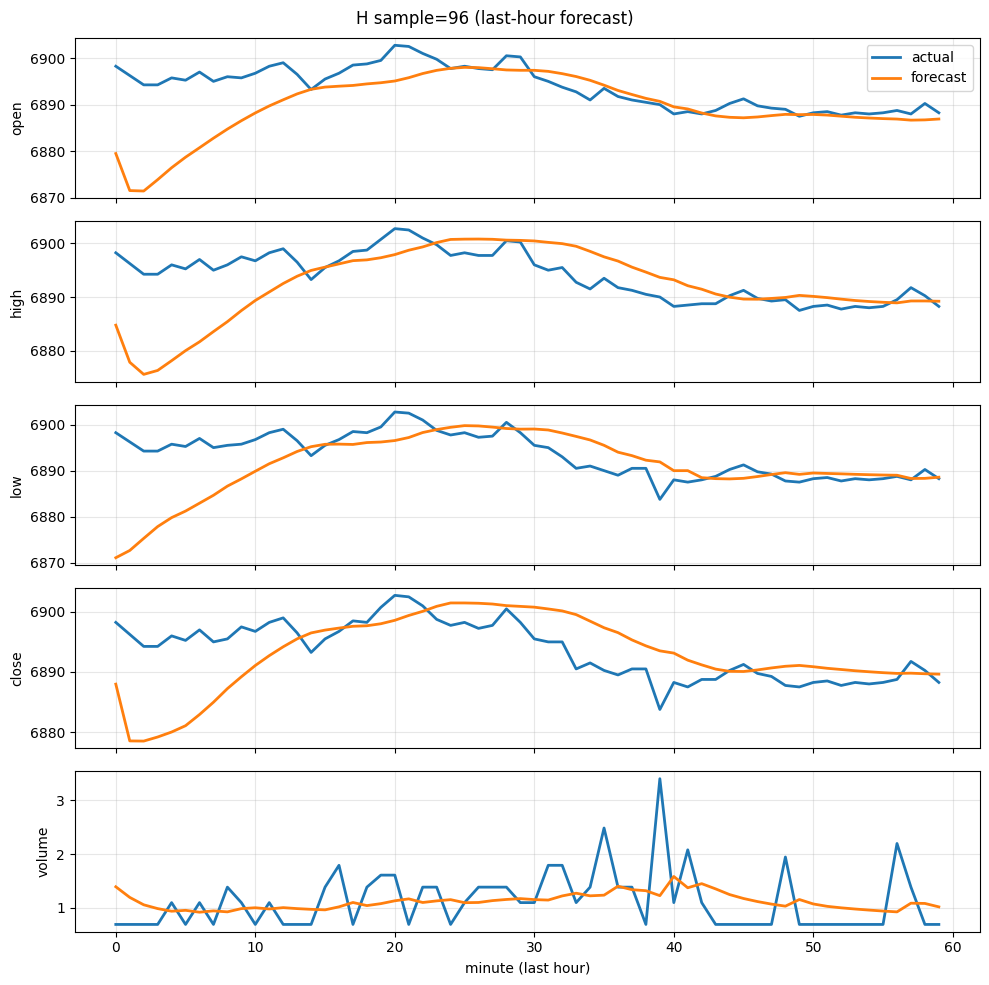

plot_saved: /content/artifacts/plot_H_test_97.png


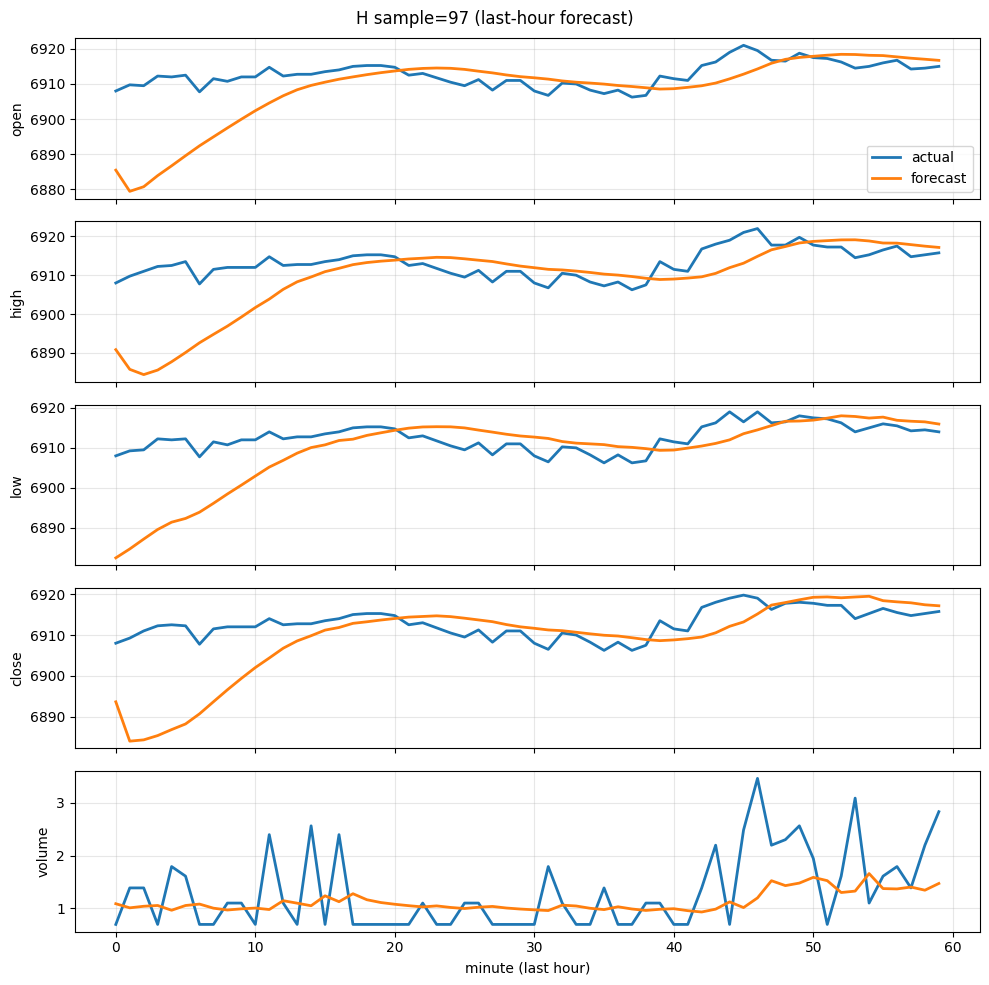

plot_saved: /content/artifacts/plot_H_test_98.png


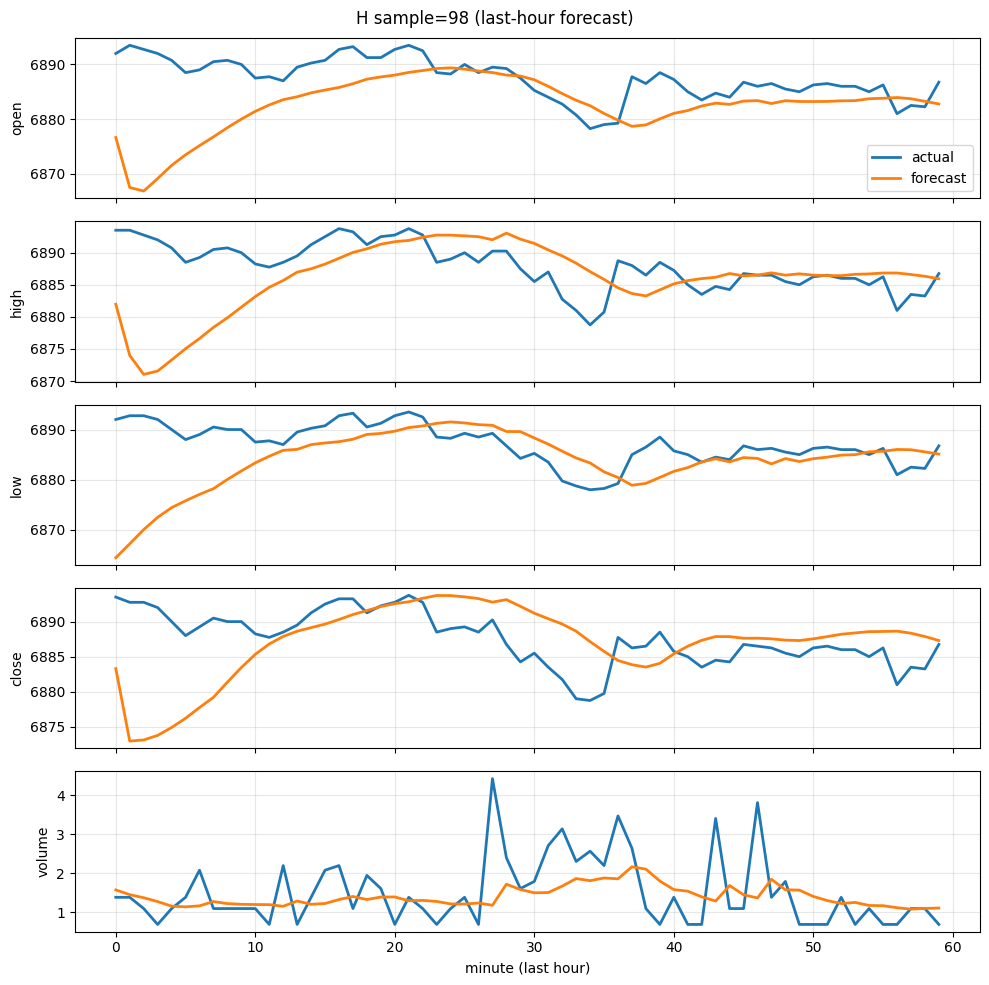

plot_saved: /content/artifacts/plot_H_test_99.png


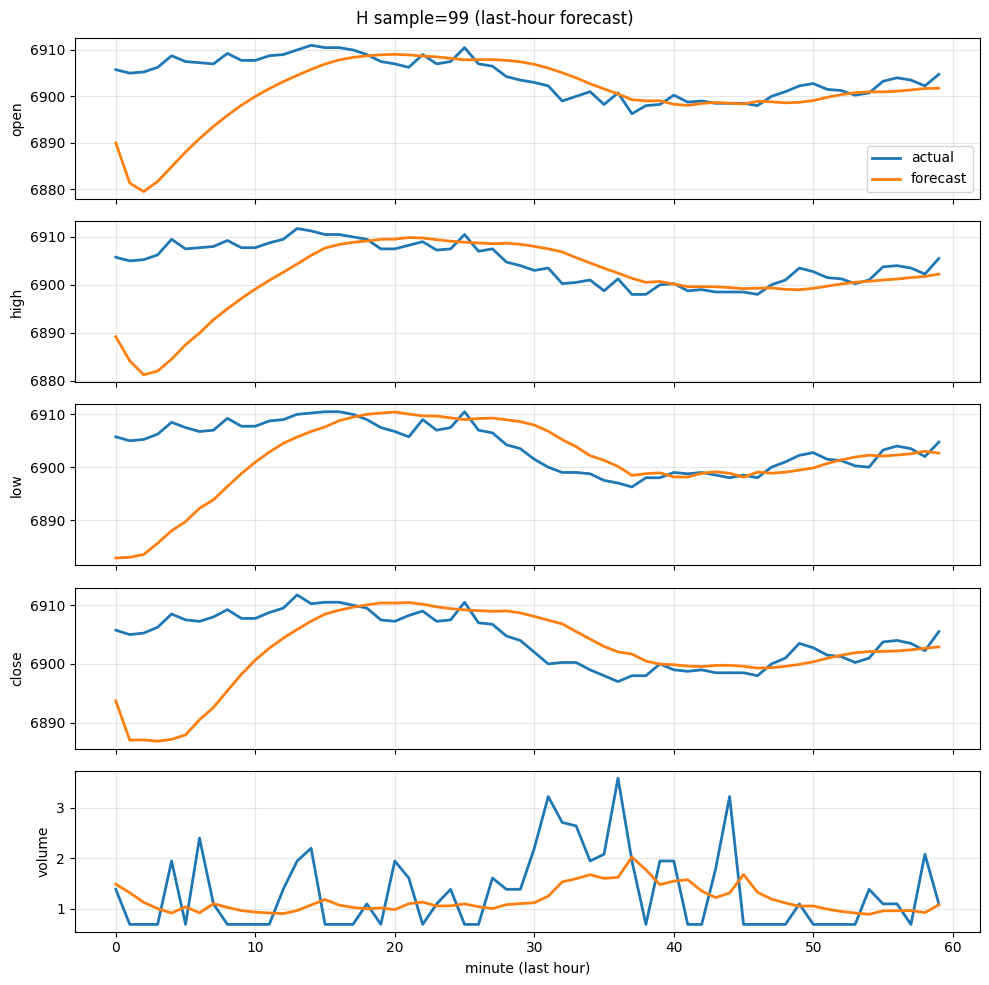

In [ ]:
# Save artifacts (model checkpoint + scaler)
ckpt_path = ARTIFACTS_DIR / 'lstm_forecaster.pt'
meta_path = ARTIFACTS_DIR / 'scaler.json'

torch.save(
    {
        'model_state_dict': model.state_dict(),
        'feature_cols': FEATURE_COLS,
        'mean': mean,
        'std': std,
        'config': {
            'model_family': MODEL_NAME,
            'hidden_size': best_params['hidden_size'],
            'num_layers': best_params['num_layers'],
            'dropout': best_params['dropout'],
            'lr': best_params['lr'],
            'horizon': HORIZON,
            'days_per_sample': DAYS_PER_SAMPLE,
            'stride_days': STRIDE_DAYS,
        },
    },
    ckpt_path,
)
meta_path.write_text(json.dumps({'feature_cols': FEATURE_COLS, 'mean': mean.tolist(), 'std': std.tolist()}, indent=2))
print('saved:', ckpt_path)
print('saved:', meta_path)

# Optional: save a full multi-feature plot like the original script
plot_contract = 'H'
plot_split = 'test'
for i in range(100):
  plot_idx = i
  ds = contract_splits[plot_contract][plot_split]
  plot_path = ARTIFACTS_DIR / f"plot_{plot_contract}_{plot_split}_{plot_idx}.png"
  plot_forecast_vs_actual(model=model, dataset=ds, idx=plot_idx, device=device, save_path=plot_path, show=True)

saved: /content/artifacts/lstm_forecaster.pt
saved: /content/artifacts/scaler.json
plot_saved: /content/artifacts/plot_Z_test_0.png


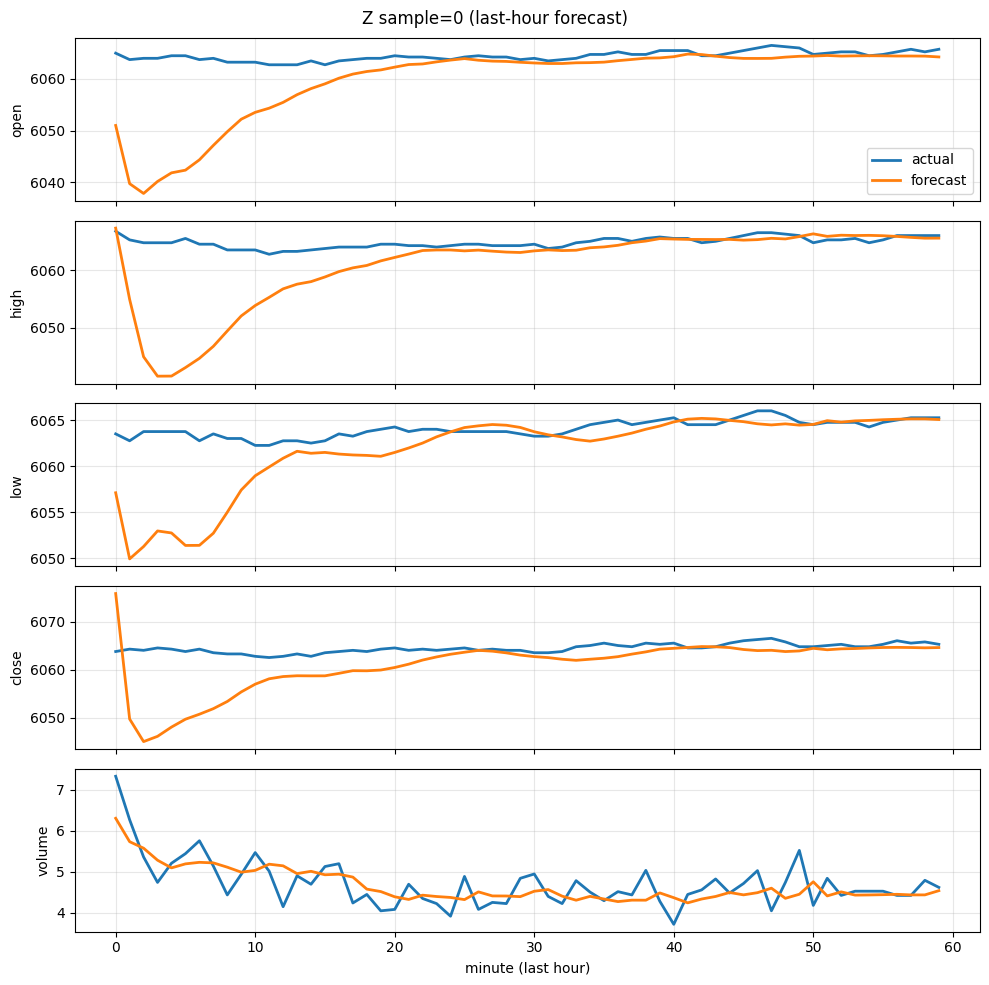

plot_saved: /content/artifacts/plot_Z_test_1.png


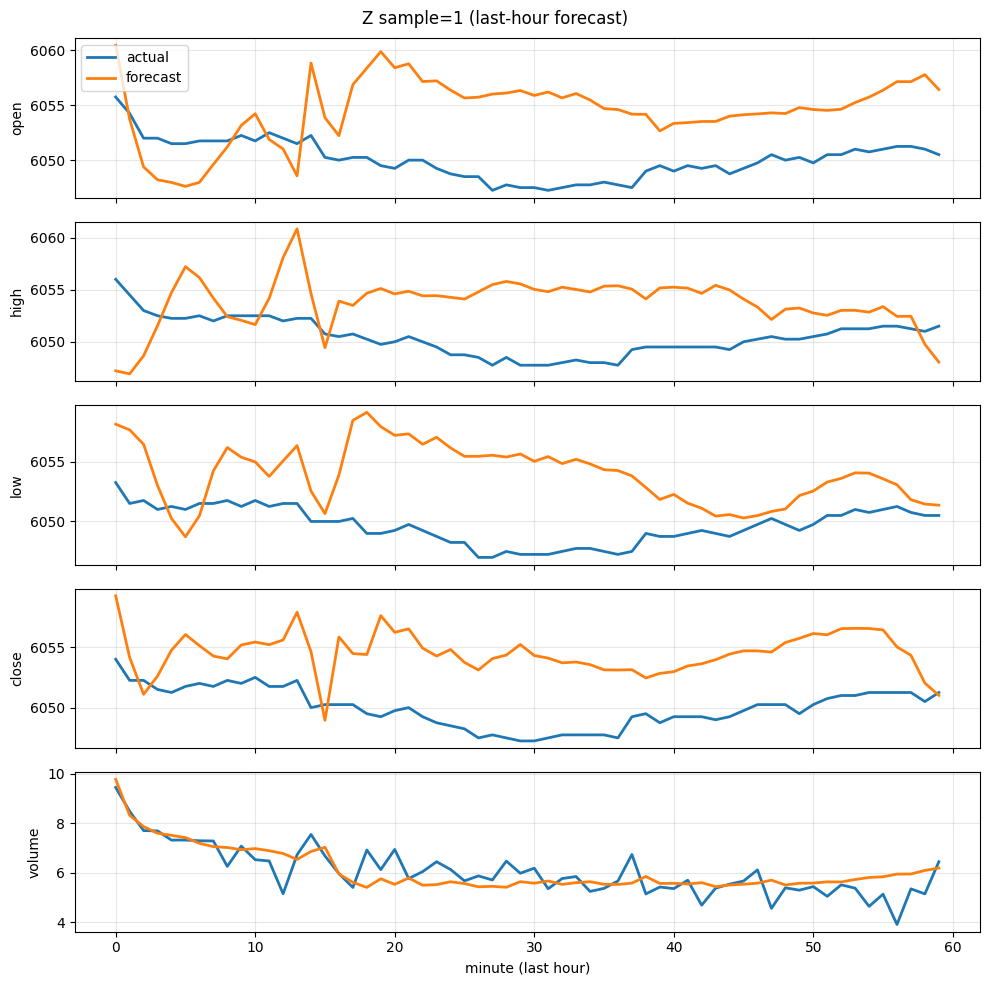

plot_saved: /content/artifacts/plot_Z_test_2.png


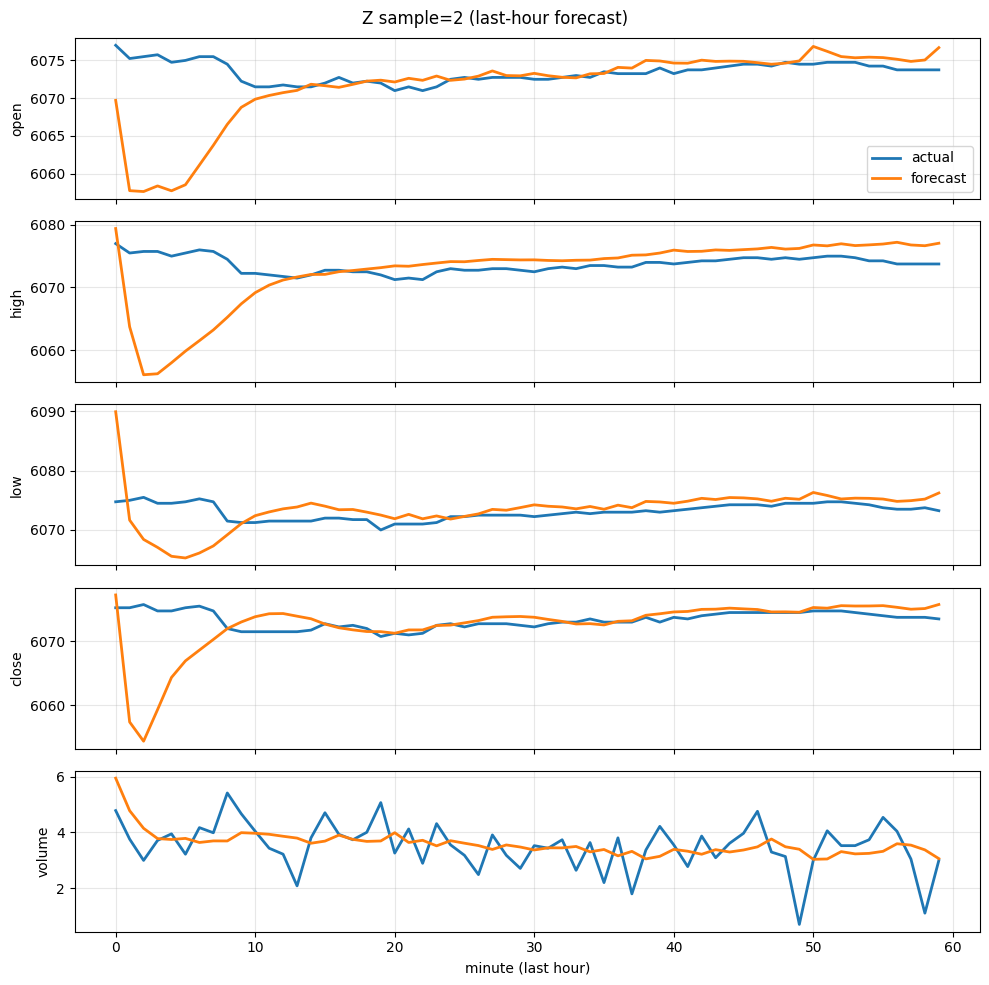

plot_saved: /content/artifacts/plot_Z_test_3.png


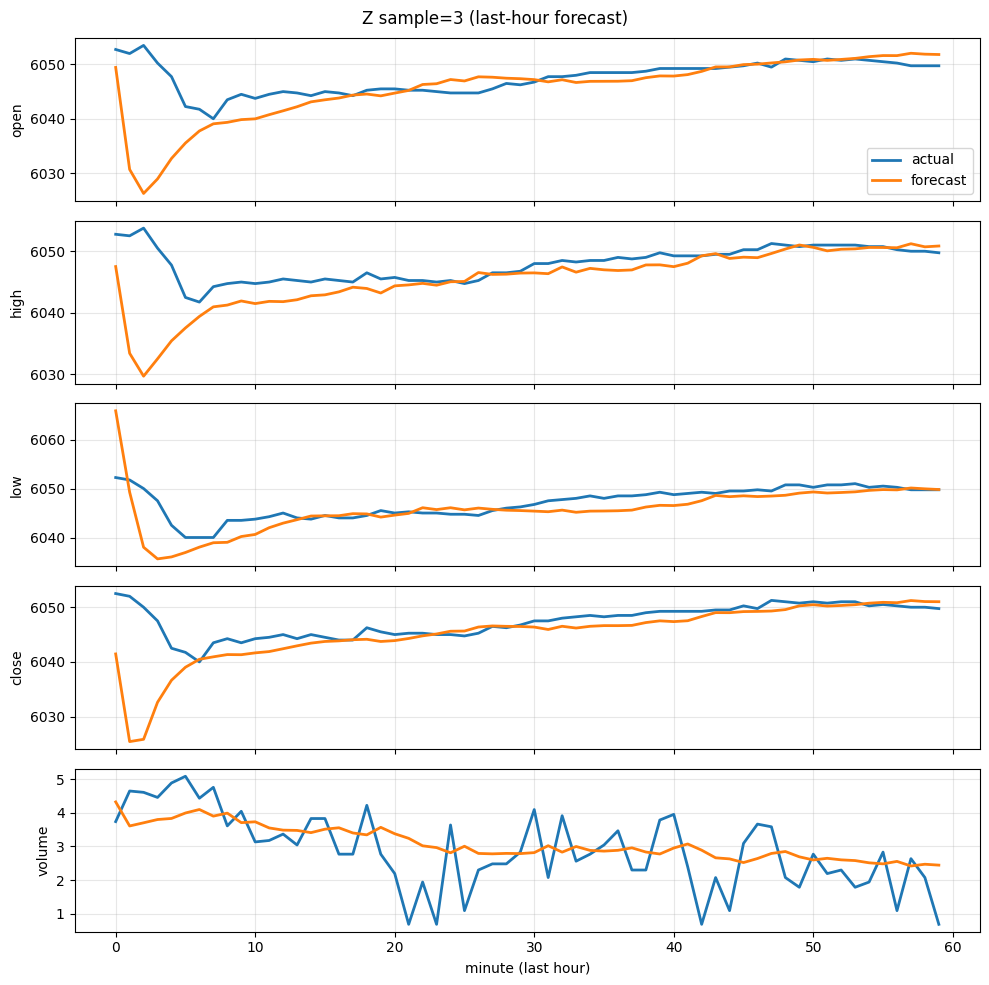

plot_saved: /content/artifacts/plot_Z_test_4.png


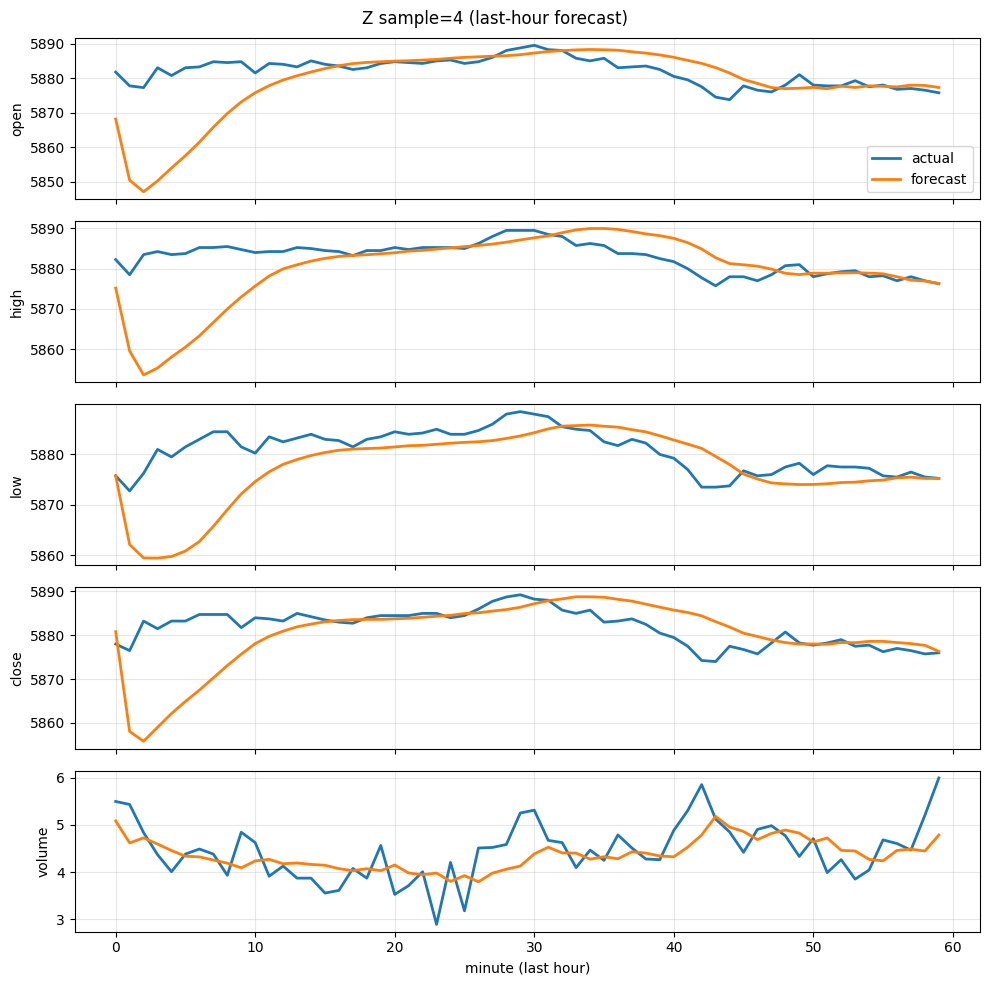

plot_saved: /content/artifacts/plot_Z_test_5.png


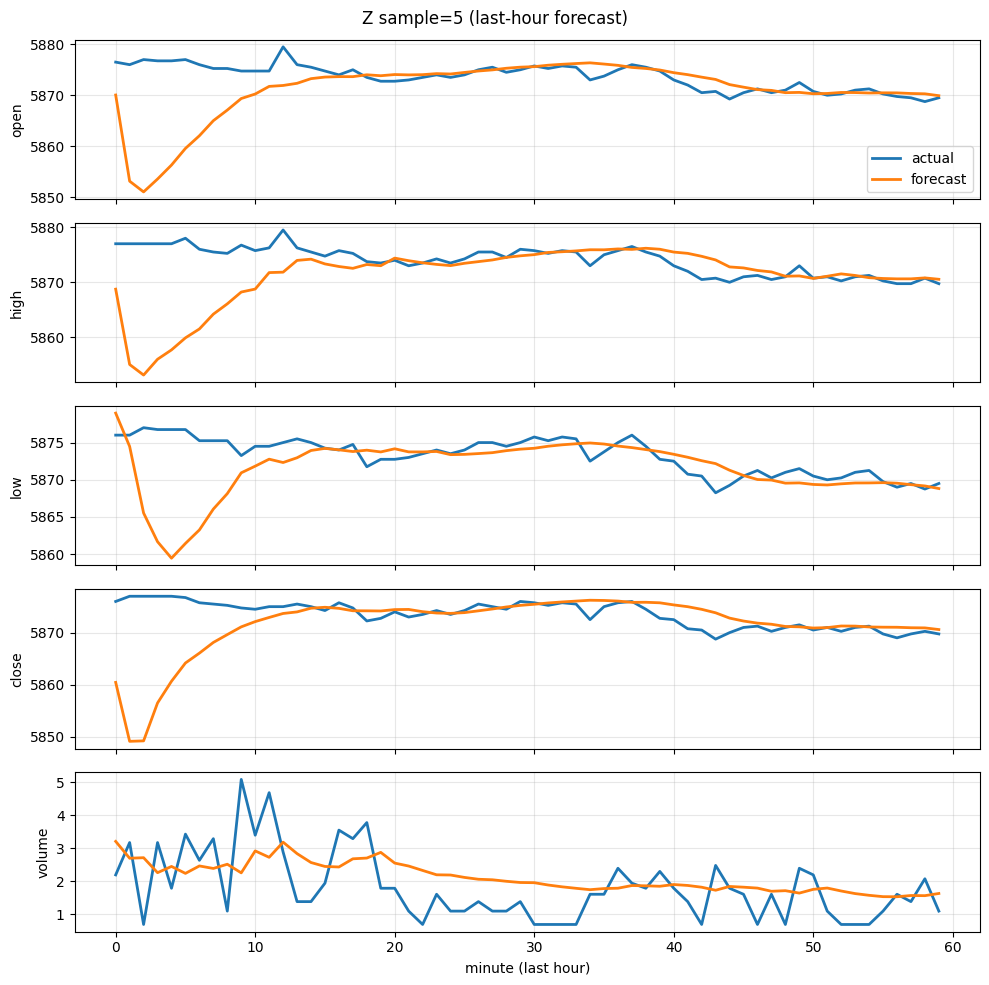

plot_saved: /content/artifacts/plot_Z_test_6.png


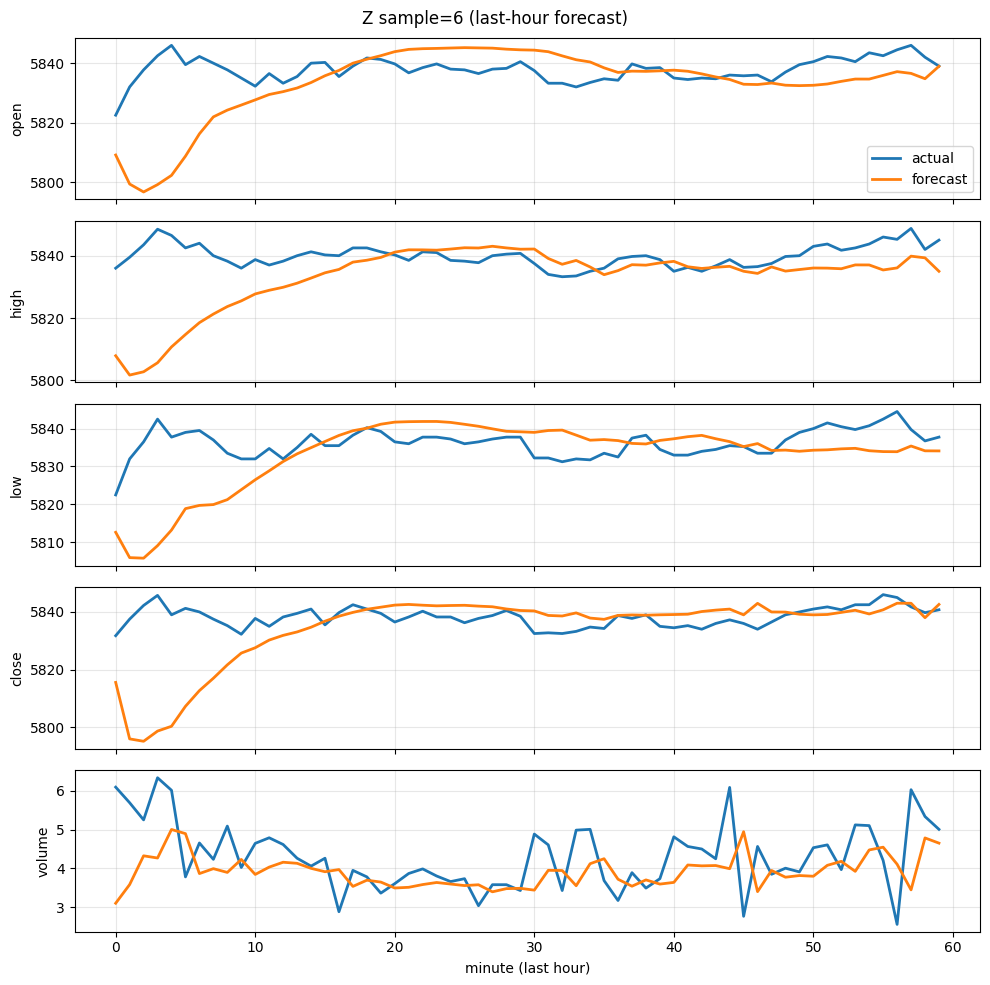

plot_saved: /content/artifacts/plot_Z_test_7.png


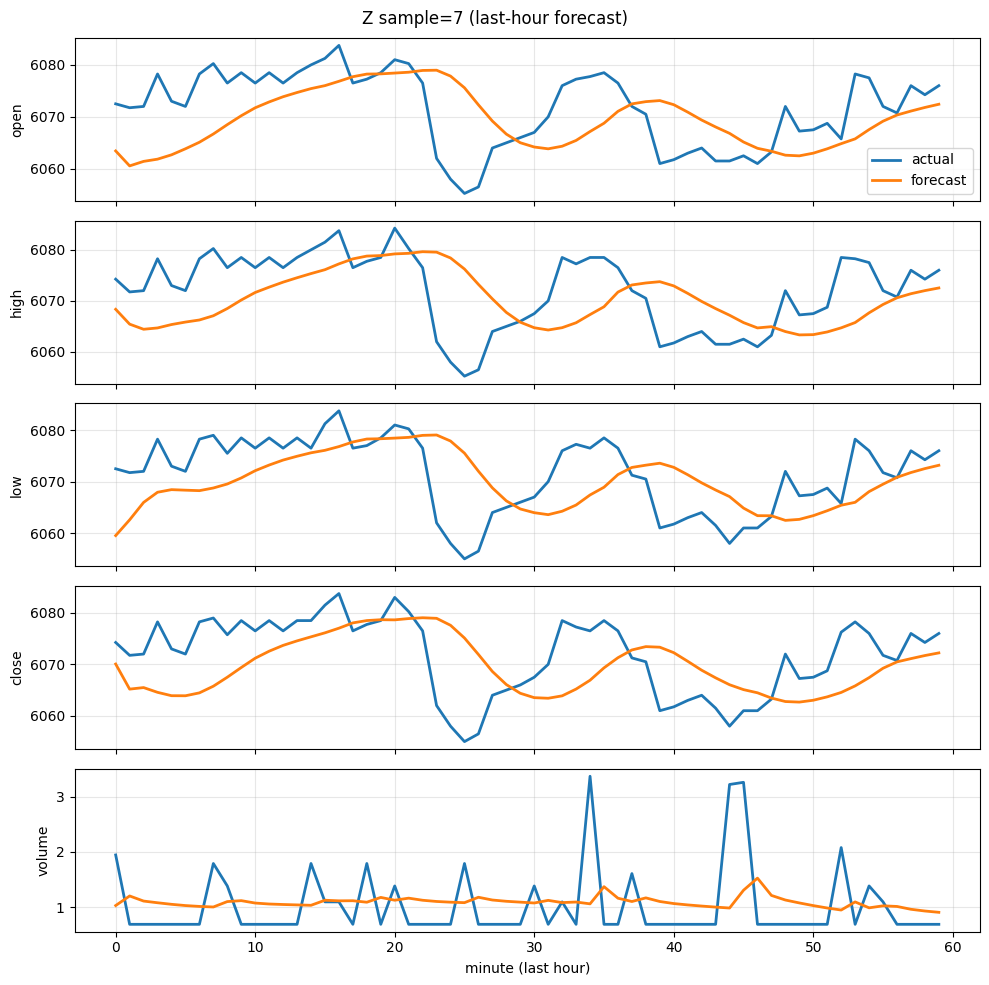

plot_saved: /content/artifacts/plot_Z_test_8.png


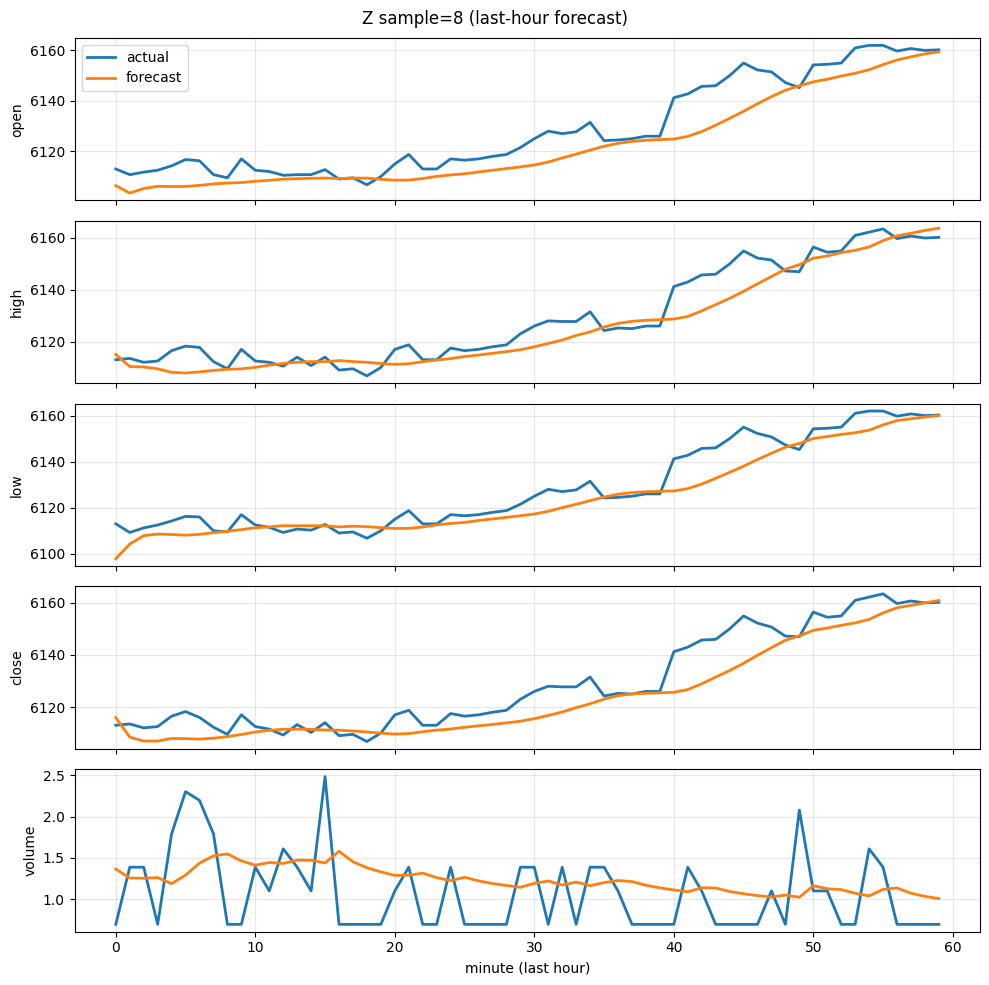

plot_saved: /content/artifacts/plot_Z_test_9.png


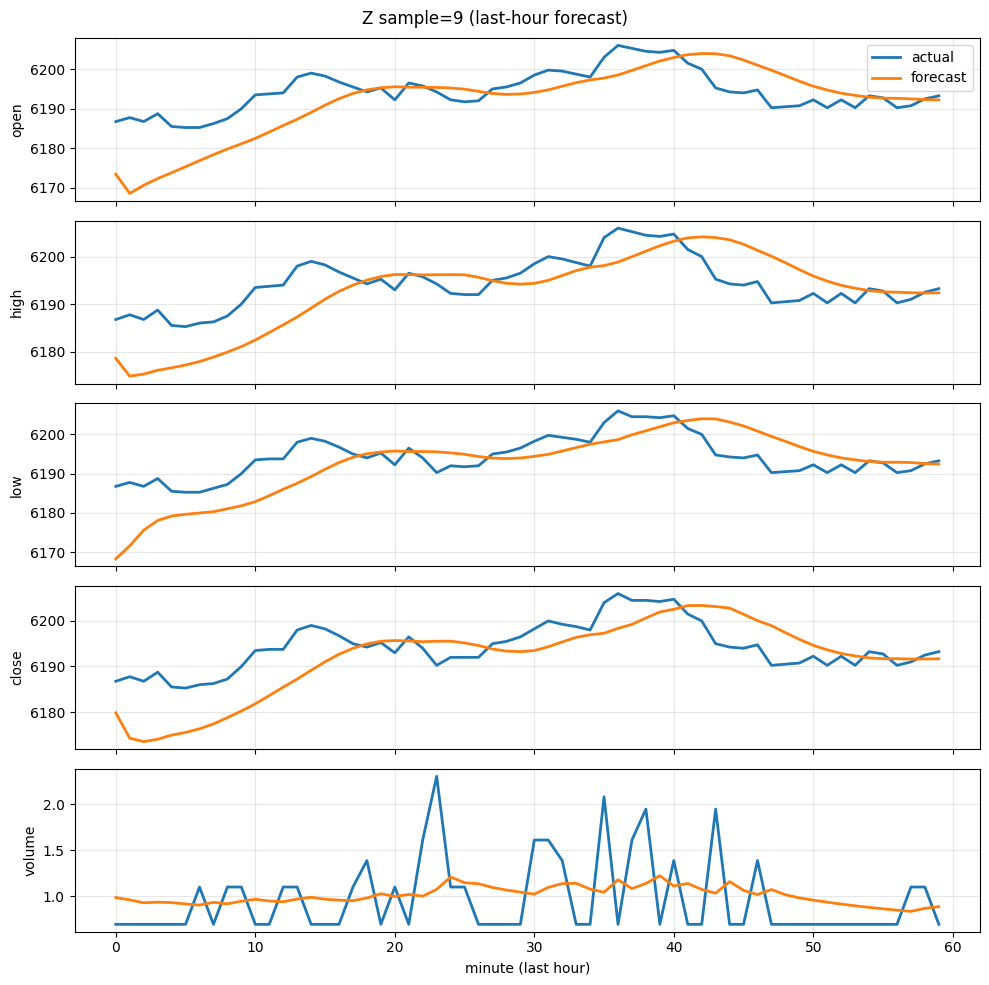

In [60]:
# Save artifacts (model checkpoint + scaler)
ckpt_path = ARTIFACTS_DIR / 'lstm_forecaster.pt'
meta_path = ARTIFACTS_DIR / 'scaler.json'

torch.save(
    {
        'model_state_dict': model.state_dict(),
        'feature_cols': FEATURE_COLS,
        'mean': mean,
        'std': std,
        'config': {
            'model_family': MODEL_NAME,
            'hidden_size': best_params['hidden_size'],
            'num_layers': best_params['num_layers'],
            'dropout': best_params['dropout'],
            'lr': best_params['lr'],
            'horizon': HORIZON,
            'days_per_sample': DAYS_PER_SAMPLE,
            'stride_days': STRIDE_DAYS,
        },
    },
    ckpt_path,
)
meta_path.write_text(json.dumps({'feature_cols': FEATURE_COLS, 'mean': mean.tolist(), 'std': std.tolist()}, indent=2))
print('saved:', ckpt_path)
print('saved:', meta_path)

# Optional: save a full multi-feature plot like the original script
plot_contract = 'Z'
plot_split = 'test'
for i in range(10):
  plot_idx = i
  ds = contract_splits[plot_contract][plot_split]
  plot_path = ARTIFACTS_DIR / f"plot_{plot_contract}_{plot_split}_{plot_idx}.png"
  plot_forecast_vs_actual(model=model, dataset=ds, idx=plot_idx, device=device, save_path=plot_path, show=True)